## <center> به نام خدا </center>
## <center> تکلیف 3 - هوش محاسباتی </center>
### <center> مرضیه علیدادی 9631983 - فائزه حسینی 9626633 </center>

In [167]:
import pandas as pd
import numpy as np
import os
from  matplotlib import pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline
import random
import cv2
import tensorflow as tf
from tensorflow.keras import optimizers,layers,models
from sklearn.metrics import f1_score,precision_score,recall_score,accuracy_score

In [2]:
IMG_WIDTH=50
IMG_HEIGHT=50
training_img_folder=r'Desktop\data\training_set'
test_img_folder=r'Desktop\data\test_set'

In [3]:
def create_dataset(img_folder):
   
    img_data_array=[]
    class_name=[]
   
    for dir1 in os.listdir(img_folder):
        for file in os.listdir(os.path.join(img_folder, dir1)):
            image_path= os.path.join(img_folder, dir1,  file)
            image=cv2.imread( image_path, cv2.COLOR_BGR2RGB)
            image=cv2.resize(image, (IMG_HEIGHT, IMG_WIDTH),interpolation = cv2.INTER_AREA)
            image=np.array(image)
            image = image.astype('float32')
            image /= 255 
            img_data_array.append(image)
            class_name.append(dir1)
    return img_data_array, class_name

In [6]:
X_train, class_name_train =create_dataset(r'C:\Users\Marzieh\Desktop\data\training_set')
X_test, class_name_test =create_dataset(r'C:\Users\Marzieh\Desktop\data\test_set')

In [7]:
target_dict_train={k: v for v, k in enumerate(np.unique(class_name_train))}
target_dict_test={k: v for v, k in enumerate(np.unique(class_name_test))}
print(target_dict_train);
print(target_dict_test);

{'cats': 0, 'dogs': 1}
{'cats': 0, 'dogs': 1}


In [8]:
Y_train=  [target_dict_train[class_name_train[i]] for i in range(len(class_name_train))]
Y_test=  [target_dict_test[class_name_test[i]] for i in range(len(class_name_test))]

In [9]:
def one_hot_converting(Y_train, Y_test):

    num_class = max(Y_train + Y_test) + 1
    Y_train_1hot = np.zeros([num_class, len(Y_train)])
    Y_test_1hot = np.zeros([num_class, len(Y_test)])   

    for ii, xx in enumerate(Y_train):
        Y_train_1hot[xx, ii] = 1.0

    for ii, xx in enumerate(Y_test):
        Y_test_1hot[xx, ii] = 1.0

    
    return Y_train_1hot.T, Y_test_1hot.T

In [10]:
Y_train, Y_test = one_hot_converting(Y_train, Y_test)

[1. 0.]
(8000, 2)


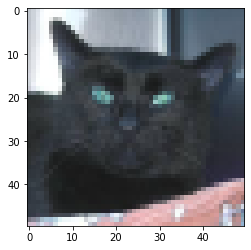

In [11]:
ix = 20;
print(Y_train[ix])
print(np.shape(Y_train))
plt.figure(ix)
plt.imshow(X_train[ix], interpolation='none', cmap='gray')
plt.show()

[0. 1.]
(2000, 2)


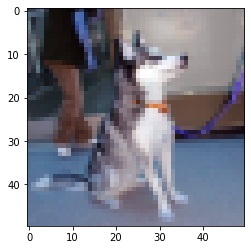

In [12]:
ix = 1000;
print(Y_test[ix])
print(np.shape(Y_test))
plt.figure(ix)
plt.imshow(X_test[ix], interpolation='none', cmap='gray')
plt.show()

# توابع:
تابع زیر به منظور دسته بندی داده با سایز بَچ های مورد نظر است

In [17]:
def get_batch(x_data, y_data, batch_size):
    x_data = np.array(x_data)
    y_data = np.array(y_data)
    idxs = np.random.randint(0, len(y_data), batch_size)
    return x_data[idxs,:], y_data[idxs]

In [35]:
X_train = np.array(X_train)
Y_train = np.array(Y_train)
X_test = np.array(X_test)
Y_test = np.array(Y_test)

تابع زیر مقدار خطا را بر اساس مقدار پیش بینی شده محاسبه میکند. تابع خطایی که در نظر گرفته شده

cross enthropy

 می باشد و برای محاسبه ی آن از کتابخانه ها استفاده شده

In [36]:
def loss_fn(logits, labels):
    cross_entropy = tf.reduce_mean(tf.nn.softmax_cross_entropy_with_logits(labels=labels,logits=logits))
    return cross_entropy

در دو بلاک زیر مقادیر زیر برای آموزش تعیین و مقداردهی شده اند 

optimizer, epoch number, batch size

هم چنین متغیرهایی برای ذخیره ی خطا در هرمرحله تعریف شده که در ادامه برای رسم نمودار از آن ها استفاده خواهد شد

In [37]:
# setup the optimizer
optimizer = tf.keras.optimizers.Adam()

In [38]:
# Python optimization variables
epochs = 50
batch_size = 100
epoch_num=[]
train_errors=[]

# قسمت الف
 در این بخش یک شبکه ی عصبی 3 لایه طراحی میکنیم و عملکرد آن روی داده هارا مورد بررسی قرار میدهیم ابن شبکه به شکل یک تابع وزن ها و بایاس ها را دریافت میکند و مقادیر پیش بینی شده را با استفاده از کتابخانه های موجود باز میگرداند

In [39]:
def nn_3_layer(x_input, W1, b1, W2, b2, W3, b3):
    # flatten the input image from 50 x 50 to 2500
    x_input = tf.reshape(x_input, (x_input.shape[0], -1))
    x = tf.add(tf.matmul(tf.cast(x_input, tf.float32), W1), b1)
    x = tf.nn.relu(x)
    x2 =tf.add(tf.matmul(x, W2), b2)
    x2 = tf.nn.relu(x2)
    logits = tf.add(tf.matmul(x2, W3), b3)
    return logits

In [40]:
X_train.shape[0]

8000

در این بخش وزن ها و بایاس هایی که قرار است در شبکه ی عصبی ای که تابع آن نوشته شده، استفاده شود مقدار دهی میشوند

In [49]:
# now declare the weights connecting the input to the hidden layer1
W1 = tf.Variable(tf.random.normal([7500,100], stddev=0.03), name='W1')
b1 = tf.Variable(tf.random.normal([100]), name='b1')
# and the weights connecting the hidden layer1 to the hidden layer2
W2 = tf.Variable(tf.random.normal([100, 100], stddev=0.03), name='W2')
b2 = tf.Variable(tf.random.normal([100]), name='b2')
# and the weights connecting the hidden layer1 to the output layer
W3 = tf.Variable(tf.random.normal([100, 2], stddev=0.03), name='W3')
b3 = tf.Variable(tf.random.normal([2]), name='b3')

تابع زیر که تابع آموزش است به تعداد دفعات تنظیم شده روی بَچ های داده های آموزش پیمایش میکند تا شبکه ی طراحی شده آموزش ببیند و در هر مرحله از پیمایش خطا روی داده های آموزش و هم چنین داده های تست محاسبه و ذخیره میشود(با استفاده از توابعی که قبلا تعریف شدند) تا  برای تحلیل های بعدی مورد استفاده قرار بگیرد  

In [51]:
def train(print_flag):    
    total_batch = int(len(Y_train) / batch_size)
    epoch_num.clear()
    train_errors.clear()
    test_errors.clear()

    epochs=15
    for epoch in range(epochs):
        total_loss = 0
        for i in range(total_batch):
            batch_x, batch_y = get_batch(X_train, Y_train, batch_size=batch_size)
            # create tensors
            batch_x = tf.Variable(batch_x)
            batch_y = tf.Variable(batch_y)
            with tf.GradientTape() as tape:
                logits = nn_3_layer(batch_x, W1, b1, W2, b2, W3, b3)
                loss = loss_fn(logits, batch_y)
            gradients = tape.gradient(loss, [W1, b1, W2, b2, W3, b3])
            optimizer.apply_gradients(zip(gradients, [W1, b1, W2, b2, W3, b3]))
            total_loss += loss / total_batch

        epoch_num.append(epoch)
        train_errors.append(total_loss)
        test_logits = nn_3_layer(X_test, W1, b1, W2, b2,W3,b3)
        test_errors.append(loss_fn(test_logits,Y_test))
        if(print_flag==1):
            print(f"Epoch: {epoch + 1}, loss={total_loss:.3f}")

    print("\nTraining complete!")

تابع آموزش صدا زده شده و به تعداد 50 مرحله پیمایش انجام میدهد. میتوان دید در هر مرحله مقدار خطا کاهش یافته است

In [52]:
epoch_num=[]
test_errors=[]
train_errors=[]
train(1)

Epoch: 1, loss=0.707
Epoch: 2, loss=0.681
Epoch: 3, loss=0.675
Epoch: 4, loss=0.666
Epoch: 5, loss=0.655
Epoch: 6, loss=0.642
Epoch: 7, loss=0.637
Epoch: 8, loss=0.633
Epoch: 9, loss=0.630
Epoch: 10, loss=0.628
Epoch: 11, loss=0.616
Epoch: 12, loss=0.618
Epoch: 13, loss=0.604
Epoch: 14, loss=0.599
Epoch: 15, loss=0.597

Training complete!


در این مرحله شبکه آموزش دیده و خطا به ازای هر مرحله پیمایش برای داده های تست و داده های آموزش در نمودار زیر قابل مشاهده است. خطا روی هر دو دسته داده به ازای هر پیمایش کاهش یافته است. نمودار قرمز برای خطای داده های آموزش و نمودار آبی نماینده ی خطای داده های تست در طول آموزش هستند میتوان دید که هردوتا خطا به طرز معقولی رو به کاهش هستند و در نهایت تفاوت مقداری زیادی ندارند پس به نظر نمیرسد مدل آندرفیت یا اورفیت شده باشد.

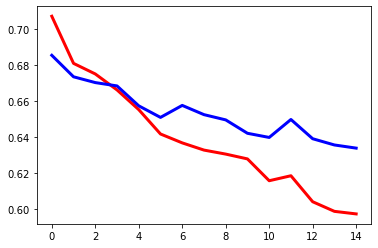

In [53]:
plt.plot(epoch_num,train_errors,color='red',linewidth=3) 
plt.plot(epoch_num,test_errors,color='blue',linewidth=3) 

حال که مدل آموزش دیده است باید عملکرد آن روی داده های تست را بررسی کرد. به این منظور از معیار دقت استفاده شده است :

accuracy: میتوان دید این مدل بیش از 63 درصد داده ها را به درستی دسته بندی کرده است و این  عملکرد نسبتا خوبی است


In [57]:
logs = nn_3_layer(X_test, W1, b1, W2, b2, W3, b3)
max_idxs = tf.argmax(logs, axis=1)
Y=tf.argmax(Y_test, axis=1)
print(f"Accuracy: {accuracy_score(Y, max_idxs)}")

Accuracy: 0.633


### قسمت ب
#### تاثیر نرخ یادگیری
در این قسمت مقادیر مختلف نرخ یادگیری و سایز دسته ها و تاثیر آنها روی آموزش مورد بررسی قرار میگیرد

In [59]:
train_errors1=[]
train_errors2=[]
train_errors3=[]
train_errors4=[]
train_errors5=[]

ابتدا تاثیر **نرخ های یادگیری** مختلف روی آموزش را بررسی میکنیم. در این قسمت سایز بچ ها و سایر پارامترهای مربوط به مدل را ثابت نگه میداریم

نرخ یادگیری = 0.005

مدل با این نرخ آموزش داده شده و مقادیر آن جهت رسم نمودار و تحلیل های بعدی ذخیره میشود

In [61]:
optimizer = tf.keras.optimizers.Adam(learning_rate=0.005)

# now declare the weights connecting the input to the hidden layer1
W1 = tf.Variable(tf.random.normal([7500,100], stddev=0.03), name='W1')
b1 = tf.Variable(tf.random.normal([100]), name='b1')
# and the weights connecting the hidden layer1 to the hidden layer2
W2 = tf.Variable(tf.random.normal([100, 100], stddev=0.03), name='W2')
b2 = tf.Variable(tf.random.normal([100]), name='b2')
# and the weights connecting the hidden layer1 to the output layer
W3 = tf.Variable(tf.random.normal([100, 2], stddev=0.03), name='W3')
b3 = tf.Variable(tf.random.normal([2]), name='b3')

epoch_num=[]
test_errors=[]
train_errors=[]
train(0)
train_errors1=train_errors


Training complete!



نرخ یادگیری = 0.05

مدل با این نرخ آموزش داده شده و مقادیر آن جهت رسم نمودار و تحلیل های بعدی ذخیره میشود

In [75]:
optimizer = tf.keras.optimizers.Adam(learning_rate=0.05)

# now declare the weights connecting the input to the hidden layer1
W1 = tf.Variable(tf.random.normal([7500,100], stddev=0.03), name='W1')
b1 = tf.Variable(tf.random.normal([100]), name='b1')
# and the weights connecting the hidden layer1 to the hidden layer2
W2 = tf.Variable(tf.random.normal([100, 100], stddev=0.03), name='W2')
b2 = tf.Variable(tf.random.normal([100]), name='b2')
# and the weights connecting the hidden layer1 to the output layer
W3 = tf.Variable(tf.random.normal([100, 2], stddev=0.03), name='W3')
b3 = tf.Variable(tf.random.normal([2]), name='b3')

epoch_num=[]
test_errors=[]
train_errors=[]
train(0)
train_errors2=train_errors


Training complete!



نرخ یادگیری = 0.1

مدل با این نرخ آموزش داده شده و مقادیر آن جهت رسم نمودار و تحلیل های بعدی ذخیره میشود

In [76]:
optimizer = tf.keras.optimizers.Adam(learning_rate=0.1)

# now declare the weights connecting the input to the hidden layer1
W1 = tf.Variable(tf.random.normal([7500,100], stddev=0.03), name='W1')
b1 = tf.Variable(tf.random.normal([100]), name='b1')
# and the weights connecting the hidden layer1 to the hidden layer2
W2 = tf.Variable(tf.random.normal([100, 100], stddev=0.03), name='W2')
b2 = tf.Variable(tf.random.normal([100]), name='b2')
# and the weights connecting the hidden layer1 to the output layer
W3 = tf.Variable(tf.random.normal([100, 2], stddev=0.03), name='W3')
b3 = tf.Variable(tf.random.normal([2]), name='b3')

epoch_num=[]
test_errors=[]
train_errors=[]
train(0)
train_errors3=train_errors


Training complete!



نرخ یادگیری = 0.5

مدل با این نرخ آموزش داده شده و مقادیر آن جهت رسم نمودار و تحلیل های بعدی ذخیره میشود

In [77]:
optimizer = tf.keras.optimizers.Adam(learning_rate=0.5)

# now declare the weights connecting the input to the hidden layer1
W1 = tf.Variable(tf.random.normal([7500,100], stddev=0.03), name='W1')
b1 = tf.Variable(tf.random.normal([100]), name='b1')
# and the weights connecting the hidden layer1 to the hidden layer2
W2 = tf.Variable(tf.random.normal([100, 100], stddev=0.03), name='W2')
b2 = tf.Variable(tf.random.normal([100]), name='b2')
# and the weights connecting the hidden layer1 to the output layer
W3 = tf.Variable(tf.random.normal([100, 2], stddev=0.03), name='W3')
b3 = tf.Variable(tf.random.normal([2]), name='b3')

epoch_num=[]
test_errors=[]
train_errors=[]
train(0)
train_errors4=train_errors


Training complete!



نرخ یادگیری = 1

مدل با این نرخ آموزش داده شده و مقادیر آن جهت رسم نمودار و تحلیل های بعدی ذخیره میشود

In [72]:
optimizer = tf.keras.optimizers.Adam(learning_rate=1)

# now declare the weights connecting the input to the hidden layer1
W1 = tf.Variable(tf.random.normal([7500,100], stddev=0.03), name='W1')
b1 = tf.Variable(tf.random.normal([100]), name='b1')
# and the weights connecting the hidden layer1 to the hidden layer2
W2 = tf.Variable(tf.random.normal([100, 100], stddev=0.03), name='W2')
b2 = tf.Variable(tf.random.normal([100]), name='b2')
# and the weights connecting the hidden layer1 to the output layer
W3 = tf.Variable(tf.random.normal([100, 2], stddev=0.03), name='W3')
b3 = tf.Variable(tf.random.normal([2]), name='b3')

epoch_num=[]
test_errors=[]
train_errors=[]
train(0)
train_errors5=train_errors


Training complete!


حال مقادیر خطای هر کدام از آموزش ها با نرخ های یادگیری متفاوت را بر حسب تعداد پیمایش رسم میکنیم همانطور که دیده میشود طیف تغییرات خطا در مدل ها بسیار متفاوت است به طور کلی از روی نمودار زیر میتوان گفت هرچه نرخ یادگیری کمتر باشد یادگیری با دقت بیشتری انجام شده و با قدم های آهسته تر به سمت بهترین جواب حرکت کرده و در نهایت به دقت بیشتری رسیده اما وقت نرخ یادگیری بزرگ بوده این قدم های بزرگ باعث شده در یک آستانه ای از اوپتیما گیر کن و در یک حدی از دقت متوقف شود

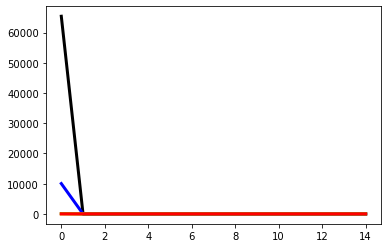

In [78]:
plt.plot(epoch_num,train_errors5,color='black',linewidth=3) 
plt.plot(epoch_num,train_errors4,color='blue',linewidth=3) 
plt.plot(epoch_num,train_errors3,color='green',linewidth=3) 
plt.plot(epoch_num,train_errors2,color='orange',linewidth=3) 
plt.plot(epoch_num,train_errors1,color='red',linewidth=3) 

نمودار فوق از نمای نزدیک تر را در شکل زیر مشاهده میکنید

قرمز:0.005

نارنجی:0.05

سبز:0.1

آبی:0.5

مشکی:1

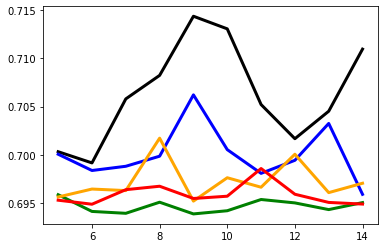

In [79]:
plt.plot(epoch_num[5:],train_errors5[5:],color='black',linewidth=3) 
plt.plot(epoch_num[5:],train_errors4[5:],color='blue',linewidth=3) 
plt.plot(epoch_num[5:],train_errors3[5:],color='green',linewidth=3) 
plt.plot(epoch_num[5:],train_errors2[5:],color='orange',linewidth=3) 
plt.plot(epoch_num[5:],train_errors1[5:],color='red',linewidth=3) 

#### تاثیر اندازه بچ

اینجا تاثیر **اندازه ی بچ** های مختلف روی آموزش را بررسی میکنیم. در این قسمت نرخ یادگیری  و سایر پارامترهای مربوط به مدل را ثابت نگه میداریم


In [81]:
optimizer = tf.keras.optimizers.Adam()

train_errors1=[]
train_errors2=[]
train_errors3=[]
train_errors4=[]
train_errors5=[]


اندازه بچ = 10

مدل با این اندازه بچ آموزش داده شده و مقادیر آن جهت رسم نمودار و تحلیل های بعدی ذخیره میشود

In [84]:
# now declare the weights connecting the input to the hidden layer1
W1 = tf.Variable(tf.random.normal([7500,100], stddev=0.03), name='W1')
b1 = tf.Variable(tf.random.normal([100]), name='b1')
# and the weights connecting the hidden layer1 to the hidden layer2
W2 = tf.Variable(tf.random.normal([100, 100], stddev=0.03), name='W2')
b2 = tf.Variable(tf.random.normal([100]), name='b2')
# and the weights connecting the hidden layer1 to the output layer
W3 = tf.Variable(tf.random.normal([100, 2], stddev=0.03), name='W3')
b3 = tf.Variable(tf.random.normal([2]), name='b3')

epoch_num=[]
test_errors=[]
train_errors=[]
batch_size = 10
train(0)
train_errors1=train_errors


Training complete!



اندازه بچ = 50

مدل با این اندازه بچ آموزش داده شده و مقادیر آن جهت رسم نمودار و تحلیل های بعدی ذخیره میشود

In [86]:
# now declare the weights connecting the input to the hidden layer1
W1 = tf.Variable(tf.random.normal([7500,100], stddev=0.03), name='W1')
b1 = tf.Variable(tf.random.normal([100]), name='b1')
# and the weights connecting the hidden layer1 to the hidden layer2
W2 = tf.Variable(tf.random.normal([100, 100], stddev=0.03), name='W2')
b2 = tf.Variable(tf.random.normal([100]), name='b2')
# and the weights connecting the hidden layer1 to the output layer
W3 = tf.Variable(tf.random.normal([100, 2], stddev=0.03), name='W3')
b3 = tf.Variable(tf.random.normal([2]), name='b3')

epoch_num=[]
test_errors=[]
train_errors=[]
batch_size = 50
train(0)
train_errors2=train_errors


Training complete!



اندازه بچ = 100

مدل با این اندازه بچ آموزش داده شده و مقادیر آن جهت رسم نمودار و تحلیل های بعدی ذخیره میشود

In [89]:
# now declare the weights connecting the input to the hidden layer1
W1 = tf.Variable(tf.random.normal([7500,100], stddev=0.03), name='W1')
b1 = tf.Variable(tf.random.normal([100]), name='b1')
# and the weights connecting the hidden layer1 to the hidden layer2
W2 = tf.Variable(tf.random.normal([100, 100], stddev=0.03), name='W2')
b2 = tf.Variable(tf.random.normal([100]), name='b2')
# and the weights connecting the hidden layer1 to the output layer
W3 = tf.Variable(tf.random.normal([100, 2], stddev=0.03), name='W3')
b3 = tf.Variable(tf.random.normal([2]), name='b3')

epoch_num=[]
test_errors=[]
train_errors=[]
batch_size = 100
train(0)
train_errors3=train_errors


Training complete!



اندازه بچ = 500

مدل با این اندازه بچ آموزش داده شده و مقادیر آن جهت رسم نمودار و تحلیل های بعدی ذخیره میشود

In [90]:
# now declare the weights connecting the input to the hidden layer1
W1 = tf.Variable(tf.random.normal([7500,100], stddev=0.03), name='W1')
b1 = tf.Variable(tf.random.normal([100]), name='b1')
# and the weights connecting the hidden layer1 to the hidden layer2
W2 = tf.Variable(tf.random.normal([100, 100], stddev=0.03), name='W2')
b2 = tf.Variable(tf.random.normal([100]), name='b2')
# and the weights connecting the hidden layer1 to the output layer
W3 = tf.Variable(tf.random.normal([100, 2], stddev=0.03), name='W3')
b3 = tf.Variable(tf.random.normal([2]), name='b3')

epoch_num=[]
test_errors=[]
train_errors=[]
batch_size = 500
train(0)
train_errors4=train_errors


Training complete!



اندازه بچ = 1000

مدل با این اندازه بچ آموزش داده شده و مقادیر آن جهت رسم نمودار و تحلیل های بعدی ذخیره میشود

In [91]:
# now declare the weights connecting the input to the hidden layer1
W1 = tf.Variable(tf.random.normal([7500,100], stddev=0.03), name='W1')
b1 = tf.Variable(tf.random.normal([100]), name='b1')
# and the weights connecting the hidden layer1 to the hidden layer2
W2 = tf.Variable(tf.random.normal([100, 100], stddev=0.03), name='W2')
b2 = tf.Variable(tf.random.normal([100]), name='b2')
# and the weights connecting the hidden layer1 to the output layer
W3 = tf.Variable(tf.random.normal([100, 2], stddev=0.03), name='W3')
b3 = tf.Variable(tf.random.normal([2]), name='b3')

epoch_num=[]
test_errors=[]
train_errors=[]
batch_size = 1000
train(0)
train_errors5=train_errors


Training complete!


حال مقادیر خطای هر کدام از آموزش ها با اندازه بچ های متفاوت را بر حسب تعداد پیمایش رسم میکنیم. همانطور که دیده میشود میتوان گفت هرچه سایز بچ کمتر باشد شبکه به طور قابل توجهی بهتر آموزش میبینید و در نهایت خطای کمتری خواهد داشت. البته باید به این نکته اشاره کنیم که هرچه سایز بچ کوچک تر باشد یادگیری زمان بیشتری میبرد. برای درک بهتر از چگونگی عملکرد هر اندازه بچ در قسمت بعدی اندکی روی نمودار بزرگنمایی انجام داده و دقیق تر میبینیم.

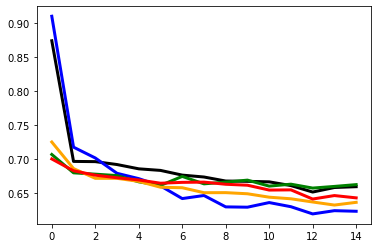

In [92]:
plt.plot(epoch_num,train_errors5,color='black',linewidth=3) 
plt.plot(epoch_num,train_errors4,color='blue',linewidth=3) 
plt.plot(epoch_num,train_errors3,color='green',linewidth=3) 
plt.plot(epoch_num,train_errors2,color='orange',linewidth=3) 
plt.plot(epoch_num,train_errors1,color='red',linewidth=3) 

نمودار بزرگنمایی شده

قرمز:10
    
نارنجی:50

سبز:100

آبی:500

مشکی:1000

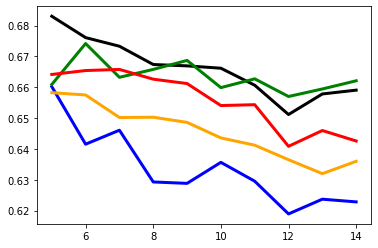

In [94]:
plt.plot(epoch_num[5:],train_errors5[5:],color='black',linewidth=3) 
plt.plot(epoch_num[5:],train_errors4[5:],color='blue',linewidth=3) 
plt.plot(epoch_num[5:],train_errors3[5:],color='green',linewidth=3) 
plt.plot(epoch_num[5:],train_errors2[5:],color='orange',linewidth=3) 
plt.plot(epoch_num[5:],train_errors1[5:],color='red',linewidth=3) 

### قسمت ج
#### تاثیر شبکه های مختلف

اینجا سه مدل که دوتا از آن ها سه لایه و یکی از آن ها ۴ لایه هست تعریف میکنیم و آموزش میدیم و تست میکنیم. و بین آن ها مقایسه انجام میدهیم
در هر مدل چهار معیار زیر محاسبه و ذخیره میشود تا بین آنها مقایسه انجام شود :

accuracy, precision, recall, f1 score

In [96]:
epoch_num=[]
test_errors=[]
train_errors=[]
batch_size = 100

train_errors1=[]
train_errors2=[]
train_errors3=[]

مدل اول: سه لایه با تعداد نرون کم

In [103]:
# now declare the weights connecting the input to the hidden layer1
W1 = tf.Variable(tf.random.normal([7500,20], stddev=0.03), name='W1')
b1 = tf.Variable(tf.random.normal([20]), name='b1')
# and the weights connecting the hidden layer1 to the hidden layer2
W2 = tf.Variable(tf.random.normal([20, 20], stddev=0.03), name='W2')
b2 = tf.Variable(tf.random.normal([20]), name='b2')
# and the weights connecting the hidden layer1 to the output layer
W3 = tf.Variable(tf.random.normal([20, 2], stddev=0.03), name='W3')
b3 = tf.Variable(tf.random.normal([2]), name='b3')

epoch_num=[]
test_errors=[]
train_errors=[]
train(0)
train_errors1=train_errors


Training complete!



accuracy:میتوان دید این مدل بیش از 58 درصد داده هارا به درستی دسته بندی کرده است و این  عملکرد متوسطی است اما حال به سایر معیار ها دقت میکنیم

precision:این معیار برای مدل خیلی خوب نبوده یعنی اگر این مدل به ما بگوید عکسی متعلق به یکی از دسته هاست با اطمینان 58 درصد که اطمینان خوبی نیست  میتوان این پیش بینی را قبول کرد.

recall: این معیار بیانگر این است که مدل ما به طور متوسط  برای چند درصد از داده های هر دسته تشخیص داده که این داده مربوط به دسته ی درست است. میتوان دید مدل در این مورد عملکرد عادی ای داشته و درصد تشخیص 58 درصد را داشته است

f1 score : با جمع بندی دو معیار بالا این معیار به دست می آید و میتوان دید که مدل ما جمعا عملكرد خیلی عادی ای داشته و خیلی خوب نبوده 

In [105]:
logs = nn_3_layer(X_test, W1, b1, W2, b2, W3, b3)
max_idxs = tf.argmax(logs, axis=1)
Y=tf.argmax(Y_test, axis=1)
print(f"F1_score: {f1_score(Y, max_idxs, average='macro')}")
print(f"Precision: {precision_score(Y, max_idxs, average='macro')}")
print(f"Recall: {recall_score(Y, max_idxs, average='macro')}")
print(f"Accuracy: {accuracy_score(Y, max_idxs)}")

F1_score: 0.5814973843586522
Precision: 0.5815020375509388
Recall: 0.5814999999999999
Accuracy: 0.5815


مدل دوم :سه لایه با تعداد نرون زیاد

In [117]:
# now declare the weights connecting the input to the hidden layer1
W1 = tf.Variable(tf.random.normal([7500,500], stddev=0.03), name='W1')
b1 = tf.Variable(tf.random.normal([500]), name='b1')
# and the weights connecting the hidden layer1 to the hidden layer2
W2 = tf.Variable(tf.random.normal([500, 500], stddev=0.03), name='W2')
b2 = tf.Variable(tf.random.normal([500]), name='b2')
# and the weights connecting the hidden layer1 to the output layer
W3 = tf.Variable(tf.random.normal([500, 2], stddev=0.03), name='W3')
b3 = tf.Variable(tf.random.normal([2]), name='b3')

epoch_num=[]
test_errors=[]
train_errors=[]
train(0)
train_errors2=train_errors


Training complete!



accuracy:میتوان دید این مدل بیش از 62 درصد داده هارا به درستی دسته بندی کرده است و این  عملکرد متوسط تا نسبتا خوبی است اما حال به سایر معیار ها دقت میکنیم

precision:این معیار برای مدل در حد متوسطی بوده است یعنی اگر این مدل به ما بگوید عکسی متعلق به یکی از دسته هاست با اطمینان 63 درصد که اطمینان نسبتا خوبی است میتوان این پیش بینی را قبول کرد.

recall:این معیار بیانگر این است که مدل ما به طور متوسط  برای چند درصد از داده های هر دسته تشخیص داده که این داده مربوط به دسته ی درست است. میتوان دید مدل در این مورد عملکرد متوسطی داشته و درصد تشخیص 63 درصد را داشته است

f1 score : با جمع بندی دو معیار بالا این معیار به دست می آید و میتوان دید که مدل ما جمعا عملكرد متوسط رو به خوبی داشته و از مدل قبلی بهتر بوده است

In [120]:
logs = nn_3_layer(X_test, W1, b1, W2, b2, W3, b3)
max_idxs = tf.argmax(logs, axis=1)
Y=tf.argmax(Y_test, axis=1)
print(f"F1_score: {f1_score(Y, max_idxs, average='macro')}")
print(f"Precision: {precision_score(Y, max_idxs, average='macro')}")
print(f"Recall: {recall_score(Y, max_idxs, average='macro')}")
print(f"Accuracy: {accuracy_score(Y, max_idxs)}")

F1_score: 0.6276595744680851
Precision: 0.6308847402597403
Recall: 0.629
Accuracy: 0.629


مدل سوم : چهار لایه

In [122]:
def nn_4_layer(x_input, W1, b1, W2, b2, W3, b3,W4,b4):
    # flatten the input image from 28 x 28 to 784
    x_input = tf.reshape(x_input, (x_input.shape[0], -1))
    x = tf.add(tf.matmul(tf.cast(x_input, tf.float32), W1), b1)
    x = tf.nn.relu(x)
    x2 =tf.add(tf.matmul(x, W2), b2)
    x2 = tf.nn.relu(x2)
    x3 =tf.add(tf.matmul(x2, W3), b3)
    x3 = tf.nn.relu(x3)
    logits = tf.add(tf.matmul(x3, W4), b4)
    return logits

In [124]:
# now declare the weights connecting the input to the hidden layer1
W1 = tf.Variable(tf.random.normal([7500, 1500], stddev=0.03), name='W1')
b1 = tf.Variable(tf.random.normal([1500]), name='b1')
# and the weights connecting the hidden layer1 to the hidden layer2
W2 = tf.Variable(tf.random.normal([1500, 1000], stddev=0.03), name='W2')
b2 = tf.Variable(tf.random.normal([1000]), name='b2')
# and the weights connecting the hidden layer2 to the hidden layer3
W3 = tf.Variable(tf.random.normal([1000, 500], stddev=0.03), name='W3')
b3 = tf.Variable(tf.random.normal([500]), name='b3')
# and the weights connecting the hidden layer3 to the output layer
W4 = tf.Variable(tf.random.normal([500, 2], stddev=0.03), name='W4')
b4 = tf.Variable(tf.random.normal([2]), name='b4')

In [129]:
total_batch = int(len(Y_train) / batch_size)
epoch_num.clear()
epochs=15
for epoch in range(epochs):
    total_loss = 0
    for i in range(total_batch):
        batch_x, batch_y = get_batch(X_train, Y_train, batch_size=batch_size)
        # create tensors
        batch_x = tf.Variable(batch_x)
        batch_y = tf.Variable(batch_y)
        with tf.GradientTape() as tape:
            logits = nn_4_layer(batch_x, W1, b1, W2, b2, W3, b3,W4,b4)
            loss = loss_fn(logits, batch_y)
        gradients = tape.gradient(loss, [W1, b1, W2, b2, W3, b3,W4,b4])
        optimizer.apply_gradients(zip(gradients, [W1, b1, W2, b2, W3, b3,W4,b4]))
        total_loss += loss / total_batch
        
    epoch_num.append(epoch)
    train_errors3.append(total_loss)
    
    print(f"Epoch: {epoch + 1}, loss={total_loss:.3f}")
    
print("\nTraining complete!")

Epoch: 1, loss=0.515
Epoch: 2, loss=0.519
Epoch: 3, loss=0.511
Epoch: 4, loss=0.533
Epoch: 5, loss=0.515
Epoch: 6, loss=0.497
Epoch: 7, loss=0.491
Epoch: 8, loss=0.489
Epoch: 9, loss=0.491
Epoch: 10, loss=0.484
Epoch: 11, loss=0.470
Epoch: 12, loss=0.460
Epoch: 13, loss=0.476
Epoch: 14, loss=0.460
Epoch: 15, loss=0.436

Training complete!



accuracy:میتوان دید این مدل بیش از 63 درصد داده هارا به درستی دسته بندی کرده است و این  عملکرد متوسط تا نسبتا خوبی است اما حال به سایر معیار ها دقت میکنیم

precision:این معیار برای مدل در حد قابل قبولی بالا بوده است یعنی اگر این مدل به ما بگوید عکسی متعلق به یکی از دسته هاست با اطمینان 64 درصد که اطمینان نسبتا خوبی است میتوان این پیش بینی را قبول کرد.

recall:اين معيار نسبت به معيار قبلي عملكرد ضعیف تری در مدل ما داشته است، این معیار بیانگر این است که مدل ما به طور متوسط  برای چند درصد از داده های هر دسته تشخیص داده که این داده مربوط به دسته ی درست است. میتوان دید مدل در این مورد عملکرد نسبتا خوبی داشته و درصد تشخیص 64 درصد را داشته است

f1 score :  با جمع بندی دو معیار بالا این معیار به دست می آید و میتوان دید که مدل ما جمعا عملكرد متوسط رو به خوبی داشته و با اینکه درصد بیشتری از داده ها را درست دسته بندی کرده این معیار برای او کم است. محتمل است که مدل دچار اورفیت شده باشد

In [131]:
logs = nn_4_layer(X_test, W1, b1, W2, b2, W3, b3,W4,b4)
max_idxs = tf.argmax(logs, axis=1)
Y=tf.argmax(Y_test, axis=1)
print(f"F1_score: {f1_score(Y, max_idxs, average='macro')}")
print(f"Precision: {precision_score(Y, max_idxs, average='macro')}")
print(f"Recall: {recall_score(Y, max_idxs, average='macro')}")
print(f"Accuracy: {accuracy_score(Y, max_idxs)}")

F1_score: 0.6349354718358735
Precision: 0.6376050250117369
Recall: 0.6359999999999999
Accuracy: 0.636


مقایسه کارایی:
    در کل با توجه به نتایج بدست آمده به این نتیجه میرسیم هر چه تعداد نرون های لایه و تعداد لایه ها بیشتر باشد نتیجه بهتری بگیریم البته به شرط آن که مدل اورفیت نشود.
    
مقایسه همگرایی :
در قسمت های قبل در طی آموزش دادن تمام شبکه ها مقدار خطای آنها به ازای هر پیمایش ذخیره شده است و اینجا در نموداری قابل مشاهده است. میتوان دید مدل با تعداد لایه و نرون کم همگرایی کمتری دارد و دلیل این امر این است که مدل به اندازه ی کافی پیچیده تیست  و نسبت به مدل های دیگر آندرفیت تر است

In [ ]:
 plt.plot(epoch_num,train_errors3,color='green',linewidth=3) 
plt.plot(epoch_num,train_errors2,color='orange',linewidth=3) 
plt.plot(epoch_num,train_errors1,color='red',linewidth=3)

In [ ]:
نمودار فوق از نمای نزدیک تر 

قرمز:سه لایه با تعداد نرون کم

نارنجی:سه لایه با تعداد نرون زیاد

سبز:چهار لایه

In [ ]:
plt.plot(epoch_num[14:],train_errors3[42:],color='green',linewidth=3) 
plt.plot(epoch_num[14:],train_errors2[42:],color='orange',linewidth=3) 
plt.plot(epoch_num[14:],train_errors1[42:],color='red',linewidth=3) 

### قسمت د

در قطعه کد زیر تعداد عکس هایی که اشتباه دسته بندی شده اند و کلاسی که باید به آن تعلق داشته باشند نمایش داده شده است.
مشکل میتواند از ساده بودن شبکه ی عصبی باشد پس شبکه ی پیچیده تری برای این مساله طراحی میکنیم

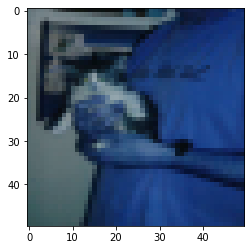

correct class is 0 but predict is 0


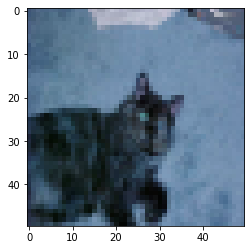

correct class is 0 but predict is 1


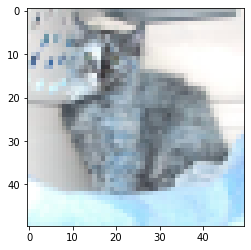

correct class is 0 but predict is 1


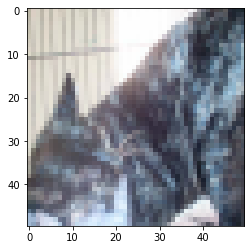

correct class is 0 but predict is 1


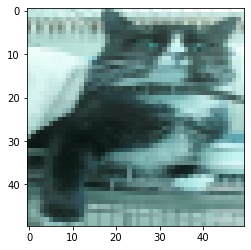

correct class is 0 but predict is 0


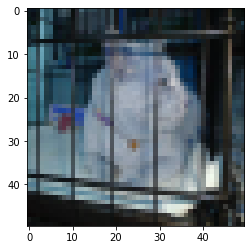

correct class is 0 but predict is 1


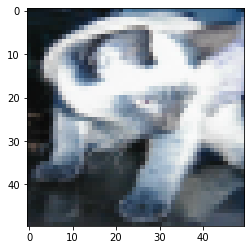

correct class is 0 but predict is 1


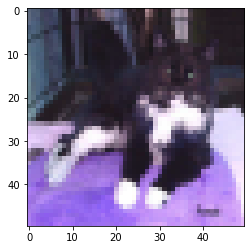

correct class is 0 but predict is 1


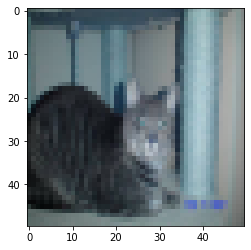

correct class is 0 but predict is 0


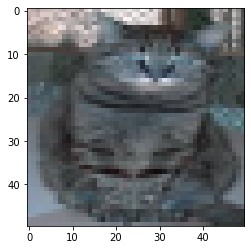

correct class is 0 but predict is 1


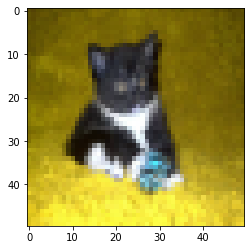

correct class is 0 but predict is 1


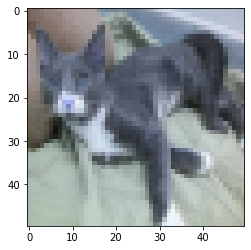

correct class is 0 but predict is 1


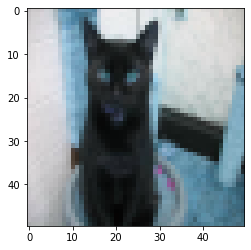

correct class is 0 but predict is 1


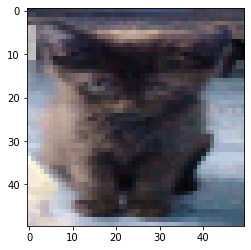

correct class is 0 but predict is 1


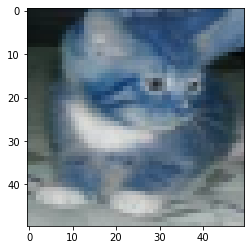

correct class is 0 but predict is 0


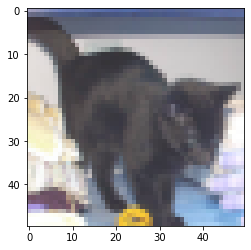

correct class is 0 but predict is 1


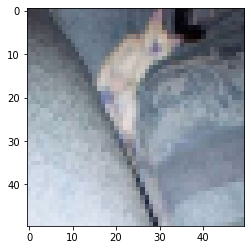

correct class is 0 but predict is 1


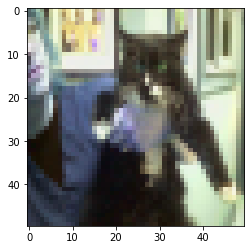

correct class is 0 but predict is 1


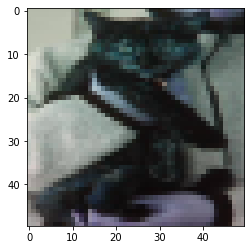

correct class is 0 but predict is 1


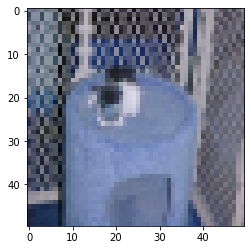

correct class is 0 but predict is 1


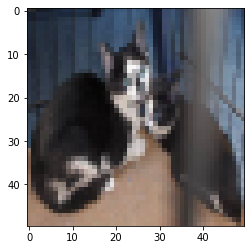

correct class is 0 but predict is 1


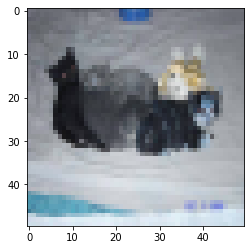

correct class is 0 but predict is 1


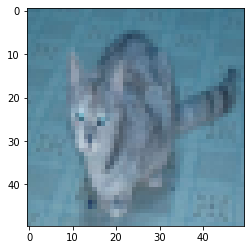

correct class is 0 but predict is 1


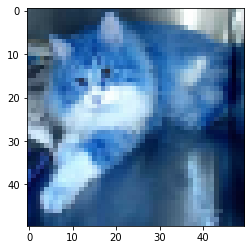

correct class is 0 but predict is 1


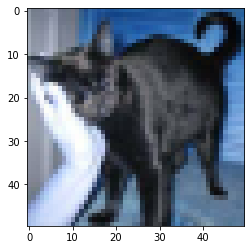

correct class is 0 but predict is 1


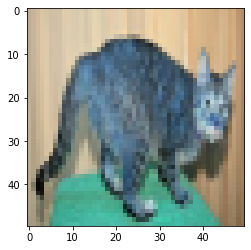

correct class is 0 but predict is 1


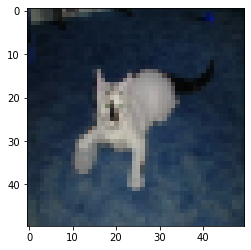

correct class is 0 but predict is 1


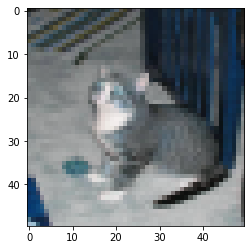

correct class is 0 but predict is 0


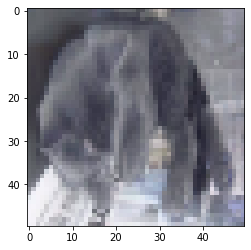

correct class is 0 but predict is 1


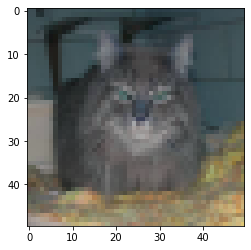

correct class is 0 but predict is 0


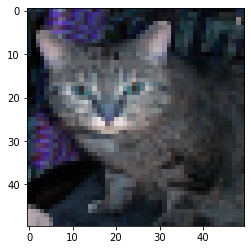

correct class is 0 but predict is 1


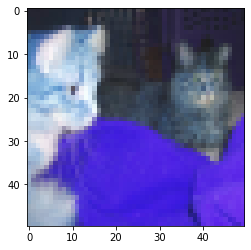

correct class is 0 but predict is 0


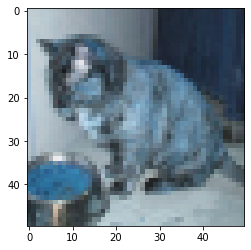

correct class is 0 but predict is 1


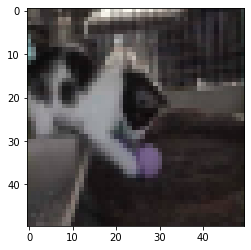

correct class is 0 but predict is 1


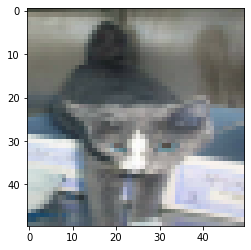

correct class is 0 but predict is 0


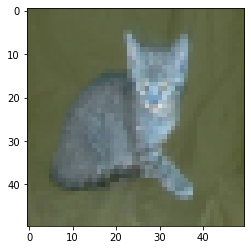

correct class is 0 but predict is 1


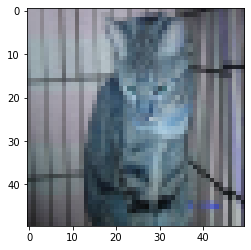

correct class is 0 but predict is 1


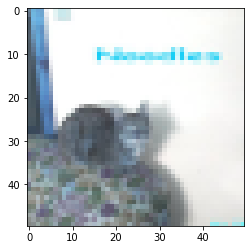

correct class is 0 but predict is 1


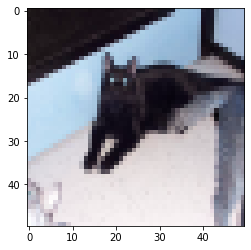

correct class is 0 but predict is 1


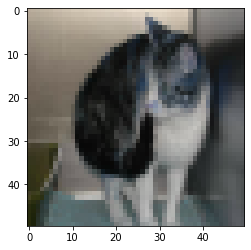

correct class is 0 but predict is 0


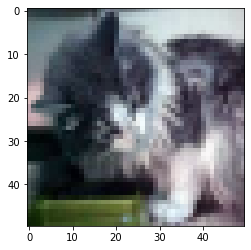

correct class is 0 but predict is 1


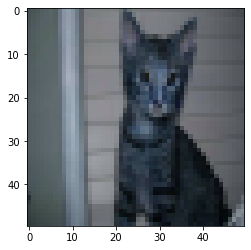

correct class is 0 but predict is 1


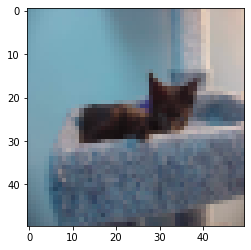

correct class is 0 but predict is 1


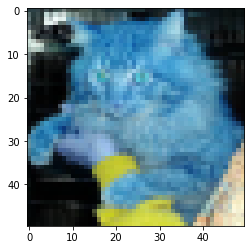

correct class is 0 but predict is 1


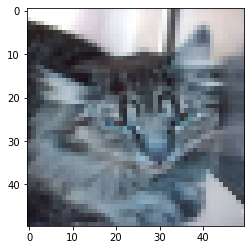

correct class is 0 but predict is 1


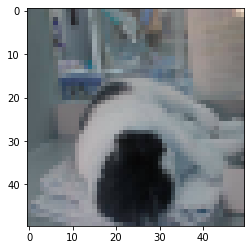

correct class is 0 but predict is 1


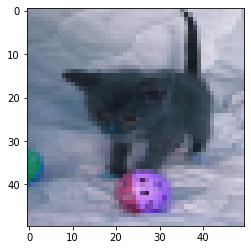

correct class is 0 but predict is 0


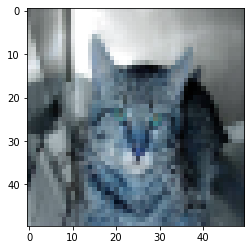

correct class is 0 but predict is 1


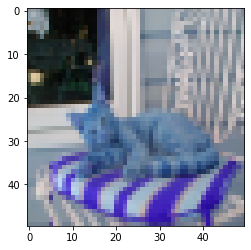

correct class is 0 but predict is 1


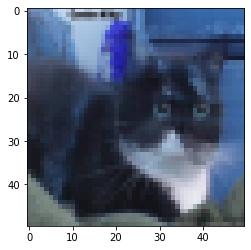

correct class is 0 but predict is 1


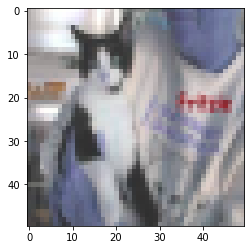

correct class is 0 but predict is 1


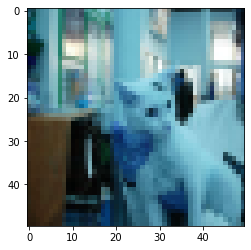

correct class is 0 but predict is 1


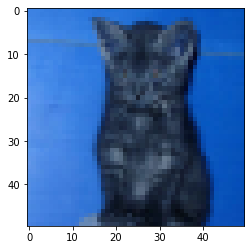

correct class is 0 but predict is 1


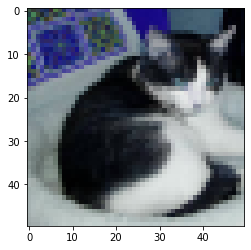

correct class is 0 but predict is 1


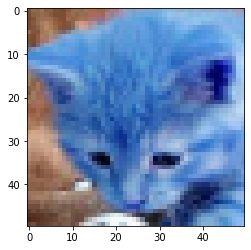

correct class is 0 but predict is 0


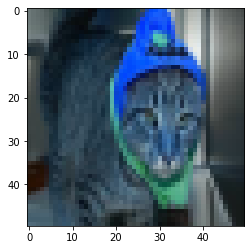

correct class is 0 but predict is 1


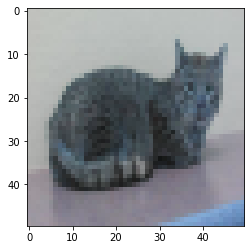

correct class is 0 but predict is 0


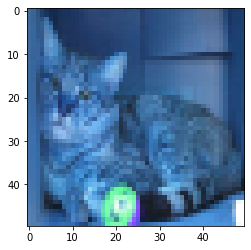

correct class is 0 but predict is 0


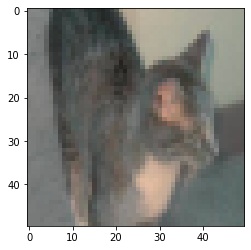

correct class is 0 but predict is 1


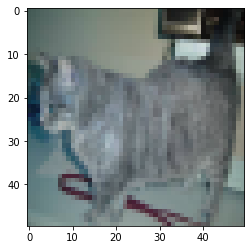

correct class is 0 but predict is 1


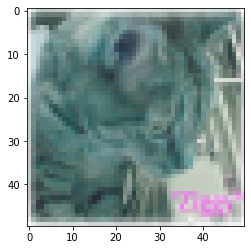

correct class is 0 but predict is 1


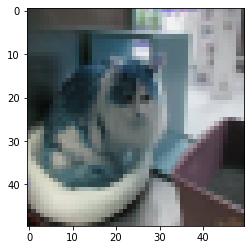

correct class is 0 but predict is 1


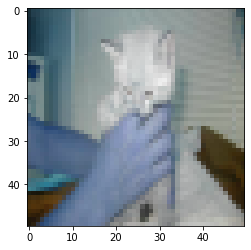

correct class is 0 but predict is 0


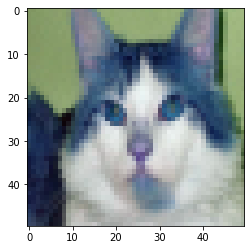

correct class is 0 but predict is 1


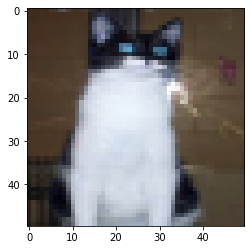

correct class is 0 but predict is 1


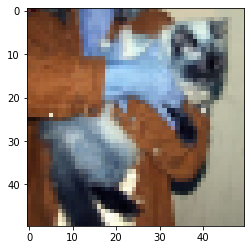

correct class is 0 but predict is 1


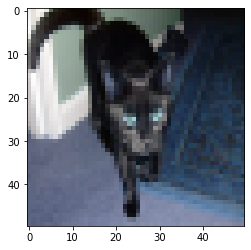

correct class is 0 but predict is 0


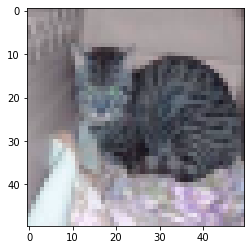

correct class is 0 but predict is 0


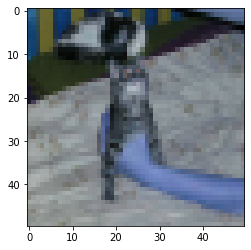

correct class is 0 but predict is 0


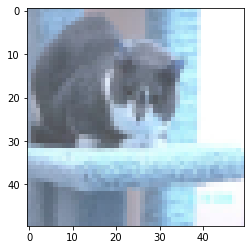

correct class is 0 but predict is 0


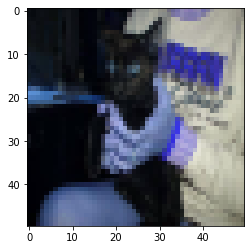

correct class is 0 but predict is 1


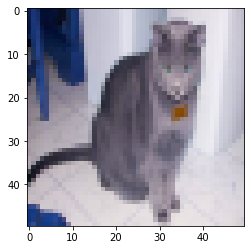

correct class is 0 but predict is 1


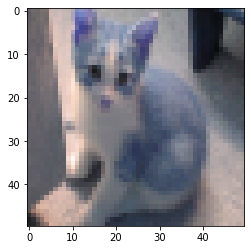

correct class is 0 but predict is 1


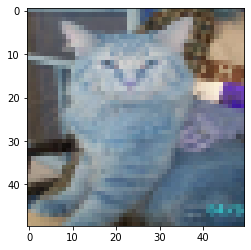

correct class is 0 but predict is 1


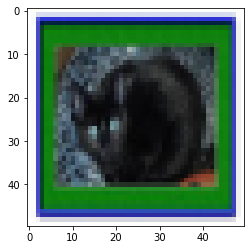

correct class is 0 but predict is 1


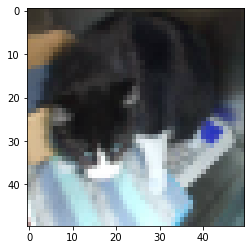

correct class is 0 but predict is 1


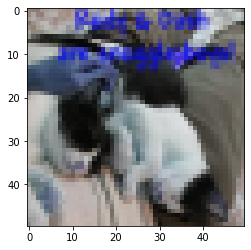

correct class is 0 but predict is 1


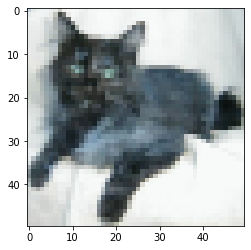

correct class is 0 but predict is 1


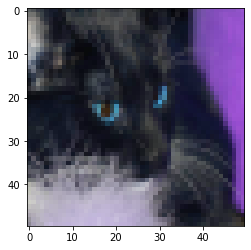

correct class is 0 but predict is 1


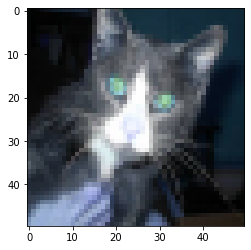

correct class is 0 but predict is 1


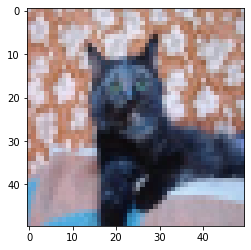

correct class is 0 but predict is 0


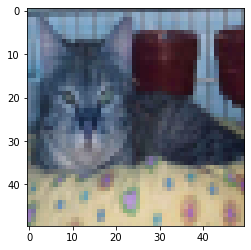

correct class is 0 but predict is 1


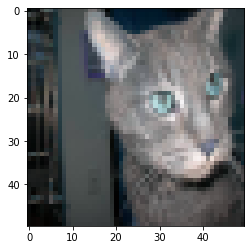

correct class is 0 but predict is 0


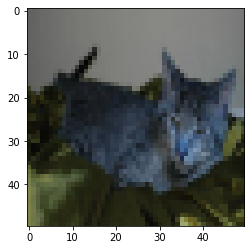

correct class is 0 but predict is 1


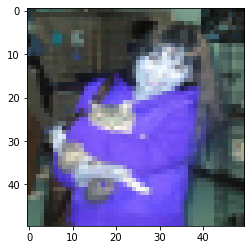

correct class is 0 but predict is 1


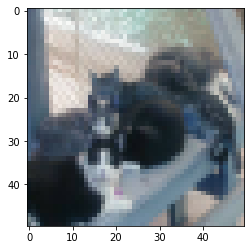

correct class is 0 but predict is 0


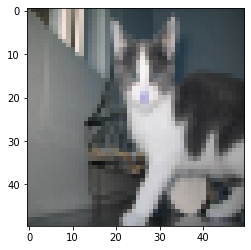

correct class is 0 but predict is 1


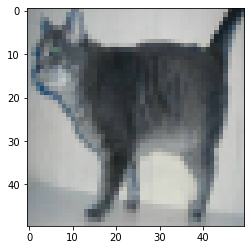

correct class is 0 but predict is 1


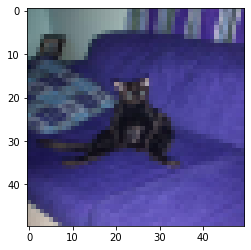

correct class is 0 but predict is 1


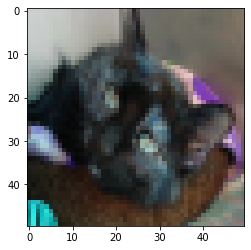

correct class is 0 but predict is 1


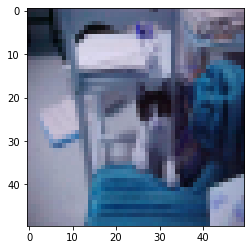

correct class is 0 but predict is 1


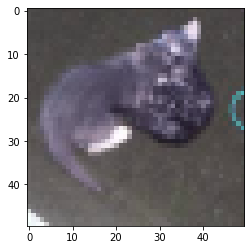

correct class is 0 but predict is 1


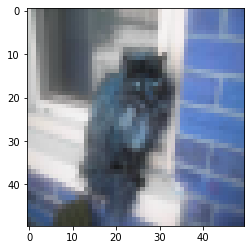

correct class is 0 but predict is 1


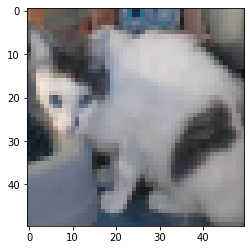

correct class is 0 but predict is 1


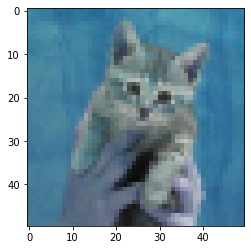

correct class is 0 but predict is 1


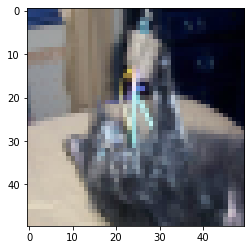

correct class is 0 but predict is 1


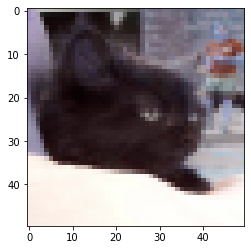

correct class is 0 but predict is 1


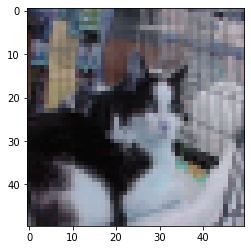

correct class is 0 but predict is 1


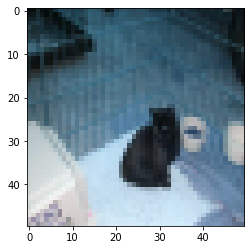

correct class is 0 but predict is 0


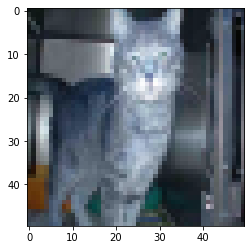

correct class is 0 but predict is 1


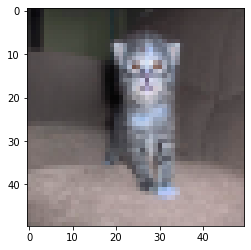

correct class is 0 but predict is 1


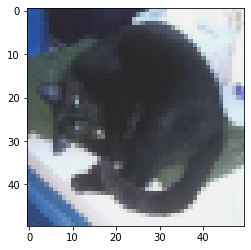

correct class is 0 but predict is 1


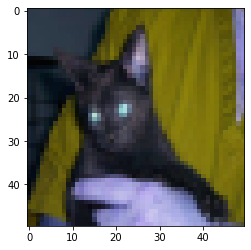

correct class is 0 but predict is 0


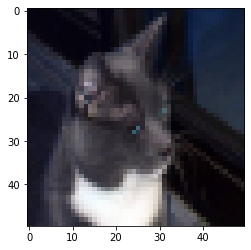

correct class is 0 but predict is 0


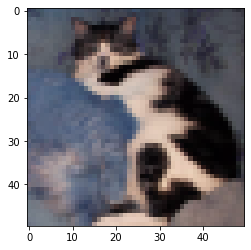

correct class is 0 but predict is 0


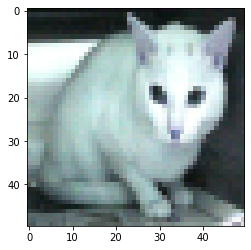

correct class is 0 but predict is 1


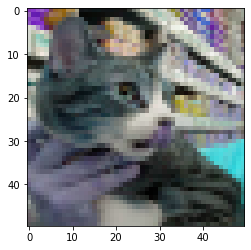

correct class is 0 but predict is 0


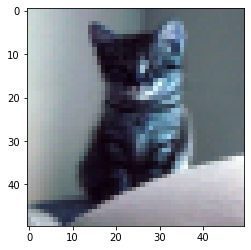

correct class is 0 but predict is 1


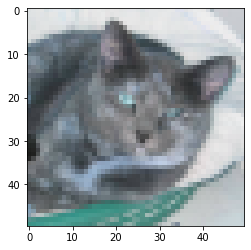

correct class is 0 but predict is 1


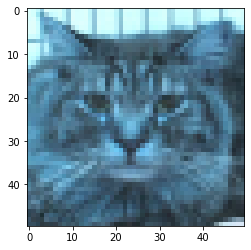

correct class is 0 but predict is 0


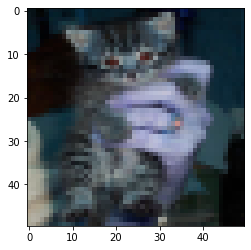

correct class is 0 but predict is 1


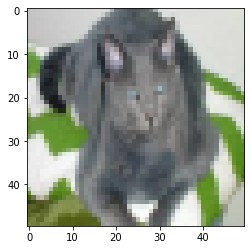

correct class is 0 but predict is 1


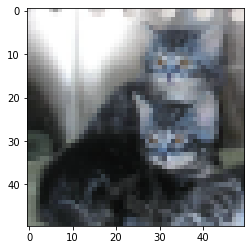

correct class is 0 but predict is 1


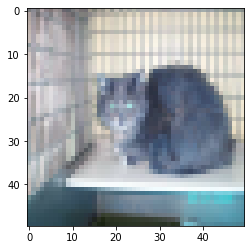

correct class is 0 but predict is 1


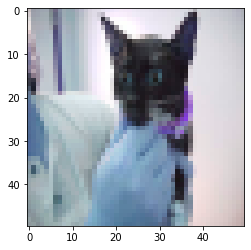

correct class is 0 but predict is 0


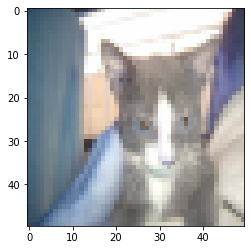

correct class is 0 but predict is 0


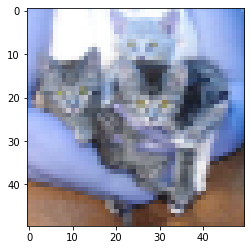

correct class is 0 but predict is 1


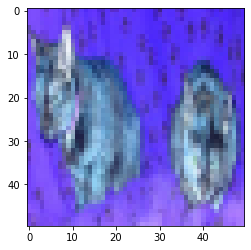

correct class is 0 but predict is 1


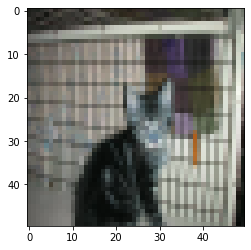

correct class is 0 but predict is 1


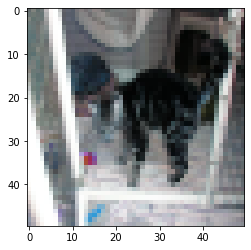

correct class is 0 but predict is 1


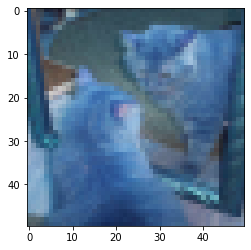

correct class is 0 but predict is 1


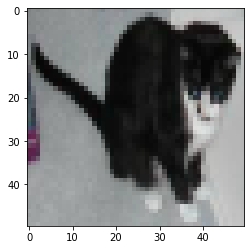

correct class is 0 but predict is 1


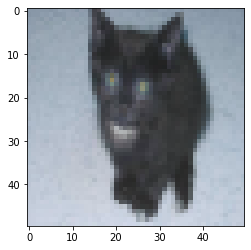

correct class is 0 but predict is 1


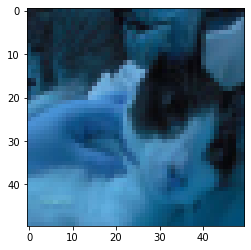

correct class is 0 but predict is 1


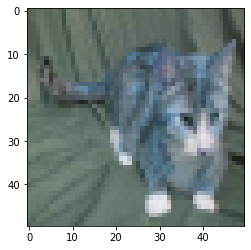

correct class is 0 but predict is 0


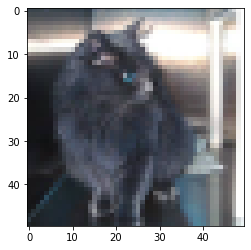

correct class is 0 but predict is 1


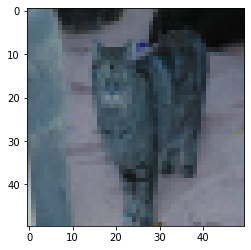

correct class is 0 but predict is 0


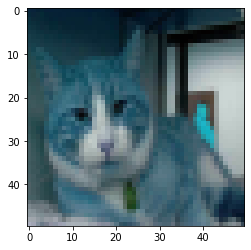

correct class is 0 but predict is 0


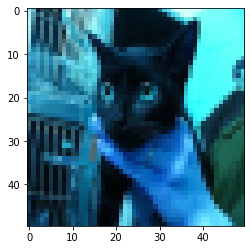

correct class is 0 but predict is 1


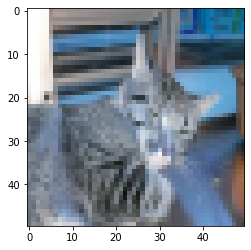

correct class is 0 but predict is 1


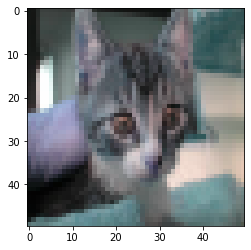

correct class is 0 but predict is 0


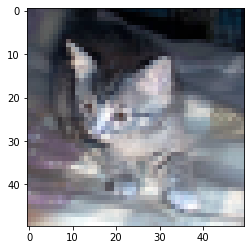

correct class is 0 but predict is 1


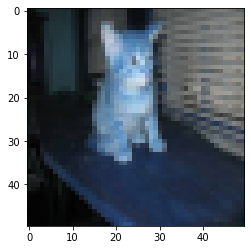

correct class is 0 but predict is 1


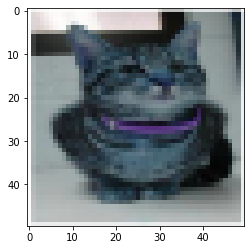

correct class is 0 but predict is 1


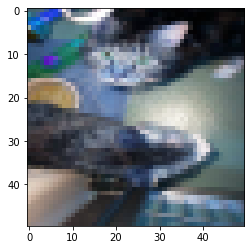

correct class is 0 but predict is 1


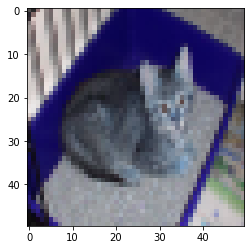

correct class is 0 but predict is 1


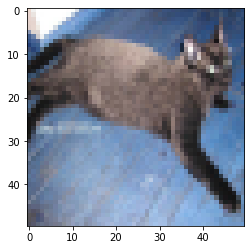

correct class is 0 but predict is 0


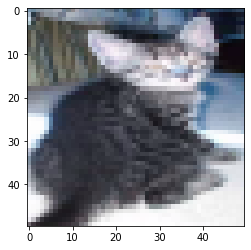

correct class is 0 but predict is 1


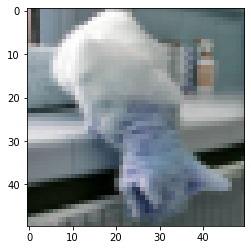

correct class is 0 but predict is 1


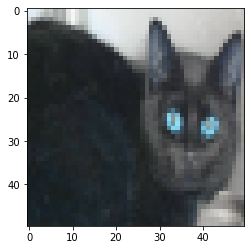

correct class is 0 but predict is 0


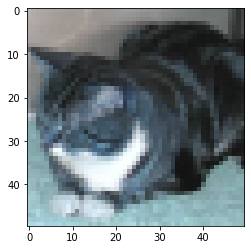

correct class is 0 but predict is 1


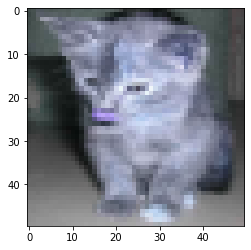

correct class is 0 but predict is 1


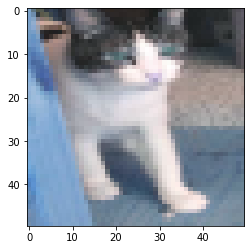

correct class is 0 but predict is 1


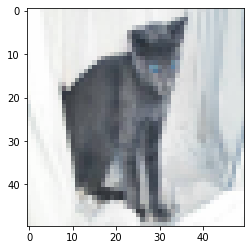

correct class is 0 but predict is 1


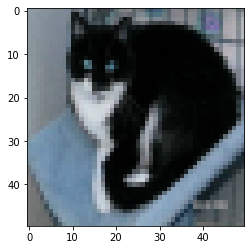

correct class is 0 but predict is 0


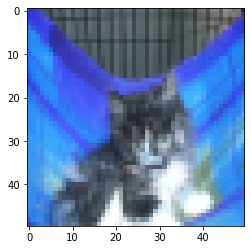

correct class is 0 but predict is 1


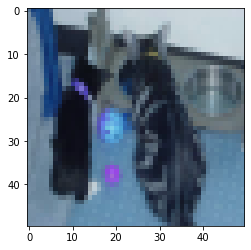

correct class is 0 but predict is 1


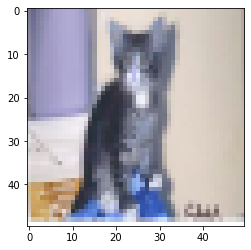

correct class is 0 but predict is 1


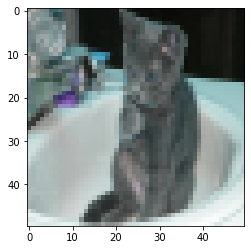

correct class is 0 but predict is 1


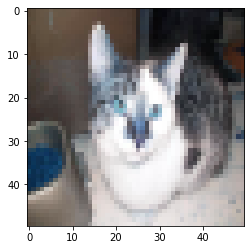

correct class is 0 but predict is 0


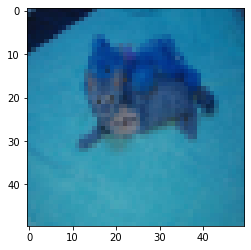

correct class is 0 but predict is 1


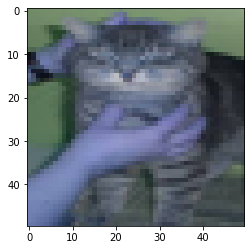

correct class is 0 but predict is 1


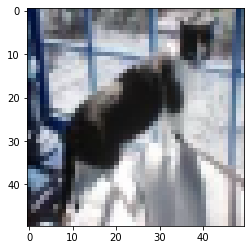

correct class is 0 but predict is 1


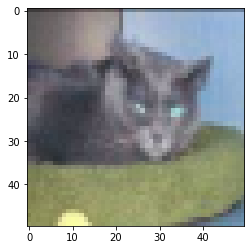

correct class is 0 but predict is 1


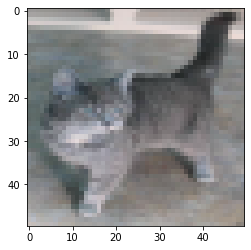

correct class is 0 but predict is 1


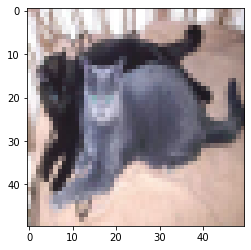

correct class is 0 but predict is 1


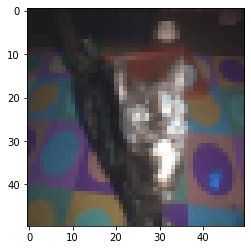

correct class is 0 but predict is 0


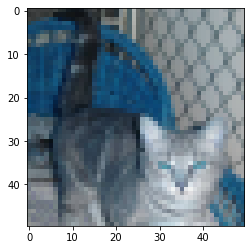

correct class is 0 but predict is 1


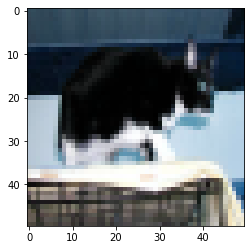

correct class is 0 but predict is 1


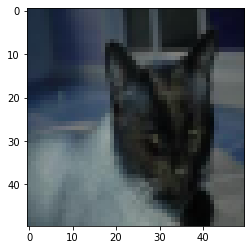

correct class is 0 but predict is 0


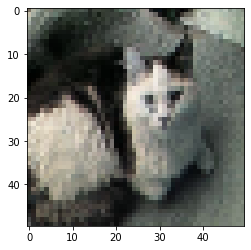

correct class is 0 but predict is 1


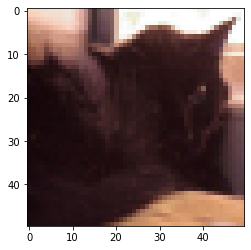

correct class is 0 but predict is 0


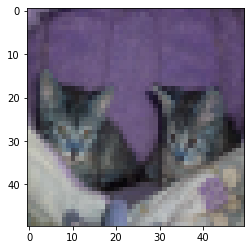

correct class is 0 but predict is 1


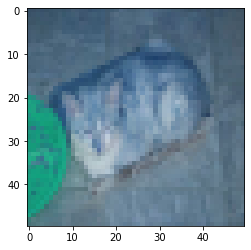

correct class is 0 but predict is 1


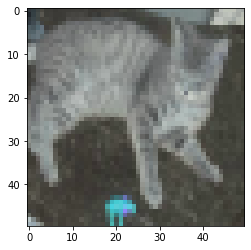

correct class is 0 but predict is 1


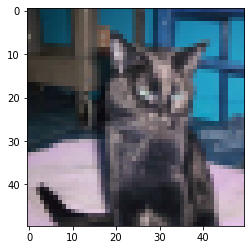

correct class is 0 but predict is 1


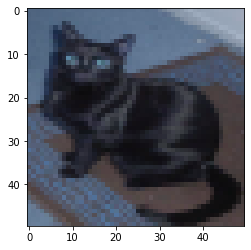

correct class is 0 but predict is 0


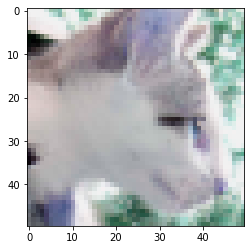

correct class is 0 but predict is 1


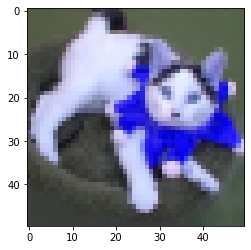

correct class is 0 but predict is 1


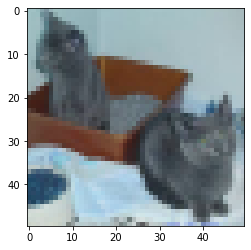

correct class is 0 but predict is 1


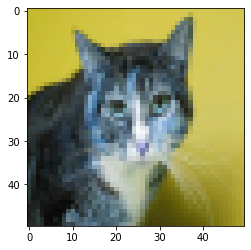

correct class is 0 but predict is 0


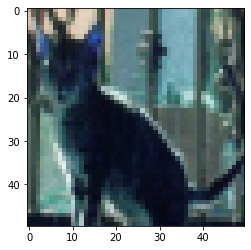

correct class is 0 but predict is 1


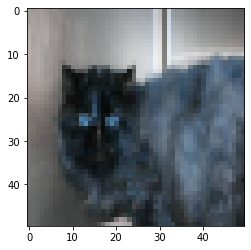

correct class is 0 but predict is 1


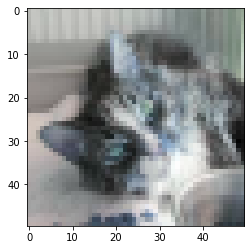

correct class is 0 but predict is 1


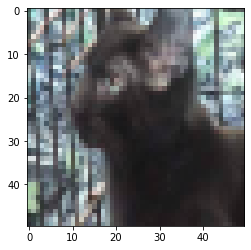

correct class is 0 but predict is 1


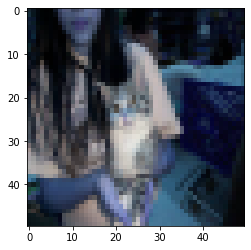

correct class is 0 but predict is 1


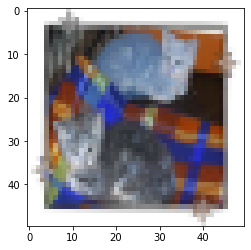

correct class is 0 but predict is 1


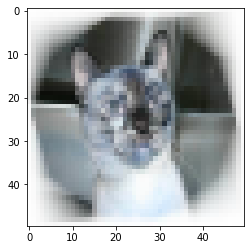

correct class is 0 but predict is 1


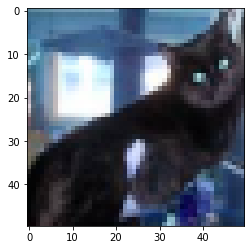

correct class is 0 but predict is 1


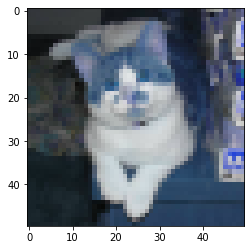

correct class is 0 but predict is 1


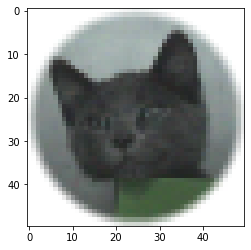

correct class is 0 but predict is 1


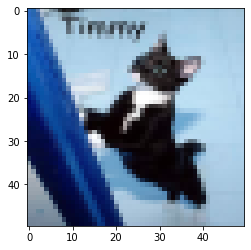

correct class is 0 but predict is 1


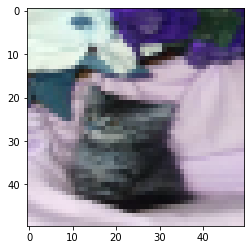

correct class is 0 but predict is 1


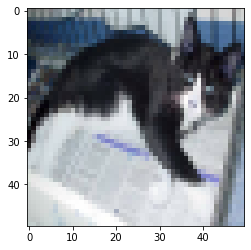

correct class is 0 but predict is 0


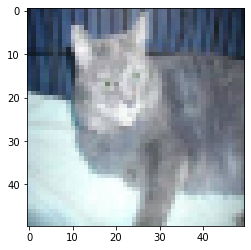

correct class is 0 but predict is 0


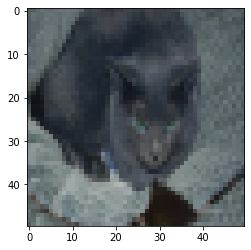

correct class is 0 but predict is 1


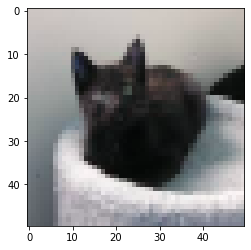

correct class is 0 but predict is 0


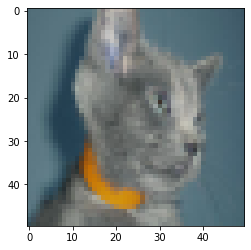

correct class is 0 but predict is 0


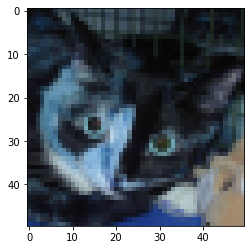

correct class is 0 but predict is 0


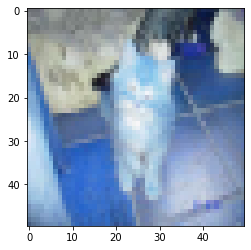

correct class is 0 but predict is 1


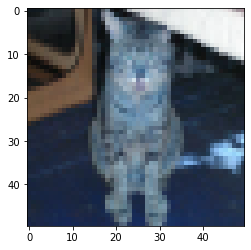

correct class is 0 but predict is 1


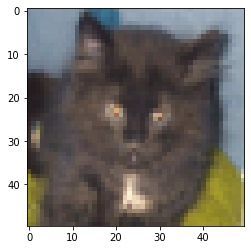

correct class is 0 but predict is 1


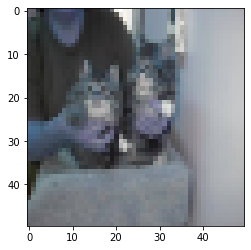

correct class is 0 but predict is 0


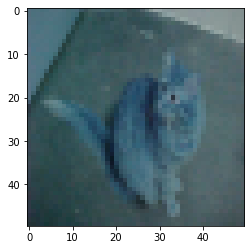

correct class is 0 but predict is 0


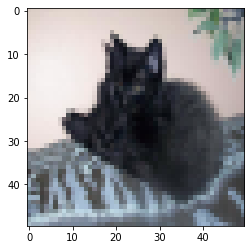

correct class is 0 but predict is 1


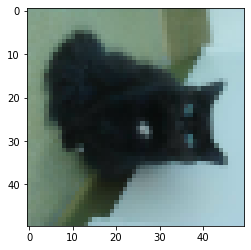

correct class is 0 but predict is 1


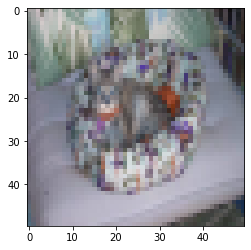

correct class is 0 but predict is 1


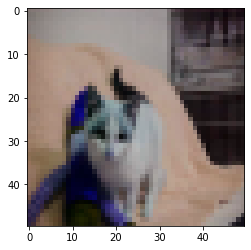

correct class is 0 but predict is 0


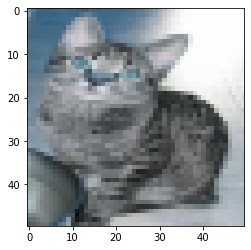

correct class is 0 but predict is 1


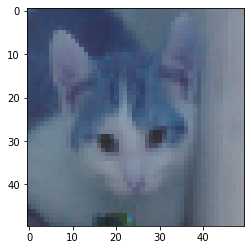

correct class is 0 but predict is 1


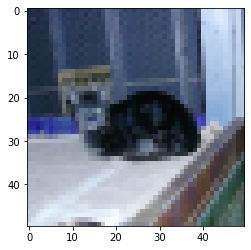

correct class is 0 but predict is 1


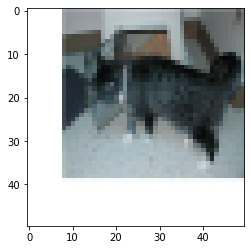

correct class is 0 but predict is 1


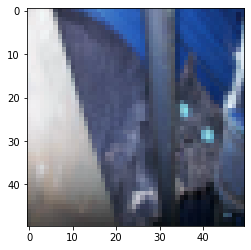

correct class is 0 but predict is 0


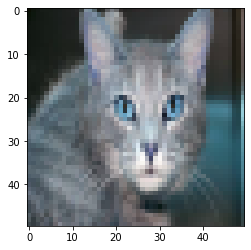

correct class is 0 but predict is 1


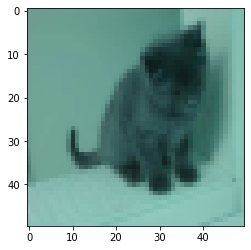

correct class is 0 but predict is 1


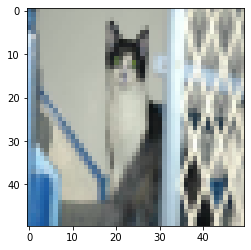

correct class is 0 but predict is 1


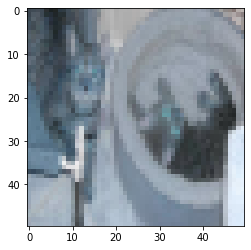

correct class is 0 but predict is 1


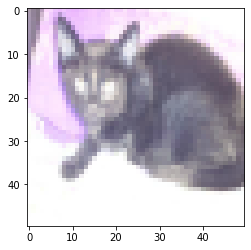

correct class is 0 but predict is 1


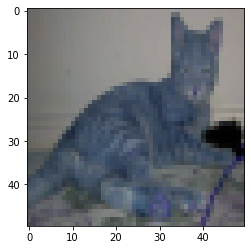

correct class is 0 but predict is 1


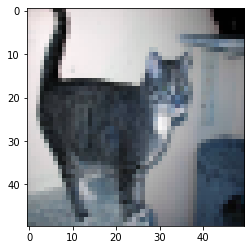

correct class is 0 but predict is 1


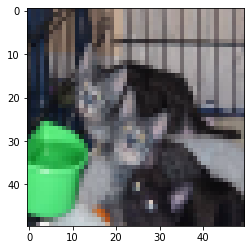

correct class is 0 but predict is 1


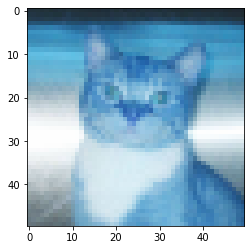

correct class is 0 but predict is 0


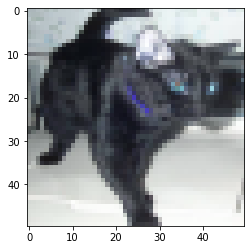

correct class is 0 but predict is 1


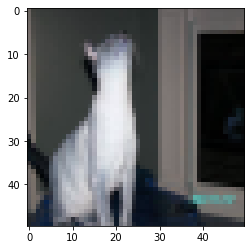

correct class is 0 but predict is 0


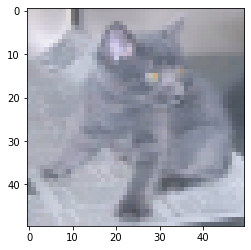

correct class is 0 but predict is 1


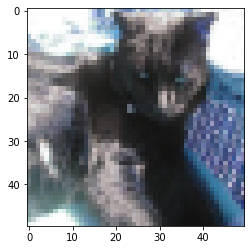

correct class is 0 but predict is 0


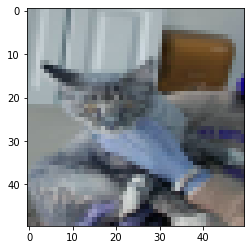

correct class is 0 but predict is 1


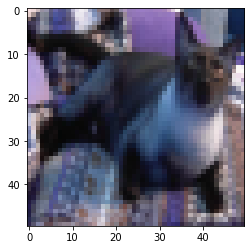

correct class is 0 but predict is 0


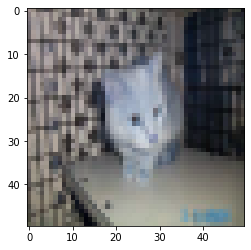

correct class is 0 but predict is 1


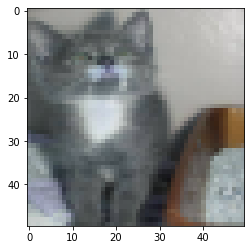

correct class is 0 but predict is 1


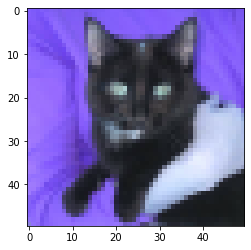

correct class is 0 but predict is 1


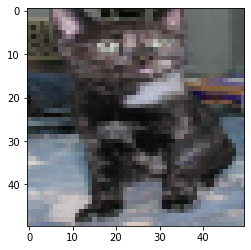

correct class is 0 but predict is 1


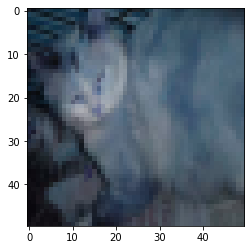

correct class is 0 but predict is 1


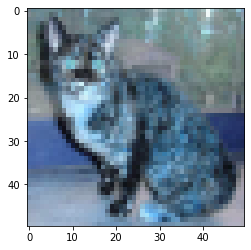

correct class is 0 but predict is 1


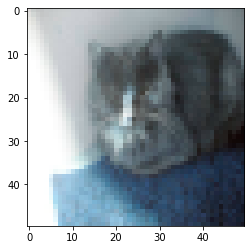

correct class is 0 but predict is 1


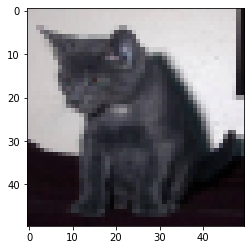

correct class is 0 but predict is 1


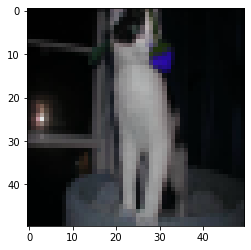

correct class is 0 but predict is 1


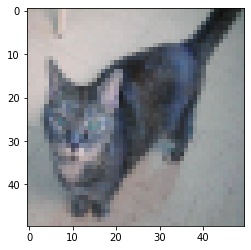

correct class is 0 but predict is 1


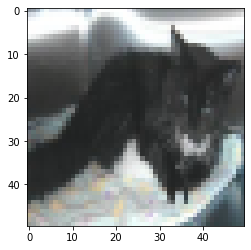

correct class is 0 but predict is 1


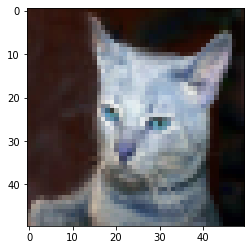

correct class is 0 but predict is 1


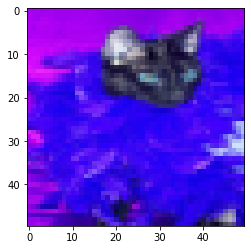

correct class is 0 but predict is 1


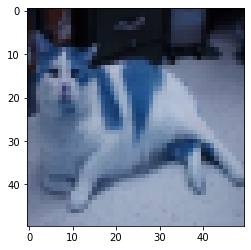

correct class is 0 but predict is 1


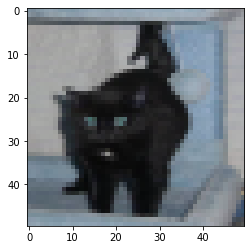

correct class is 0 but predict is 1


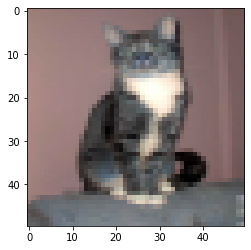

correct class is 0 but predict is 1


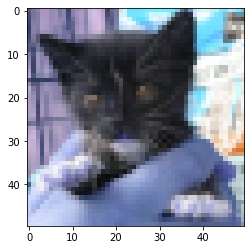

correct class is 0 but predict is 1


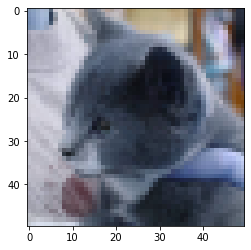

correct class is 0 but predict is 1


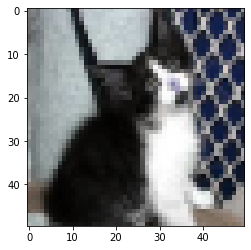

correct class is 0 but predict is 1


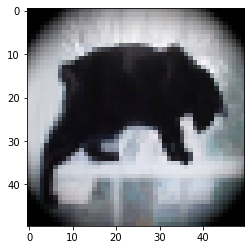

correct class is 0 but predict is 0


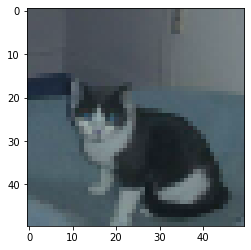

correct class is 0 but predict is 1


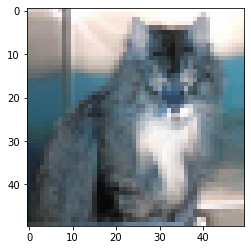

correct class is 0 but predict is 0


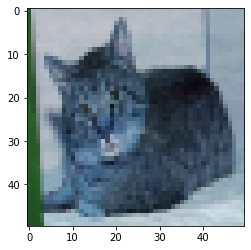

correct class is 0 but predict is 0


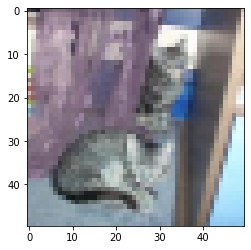

correct class is 0 but predict is 1


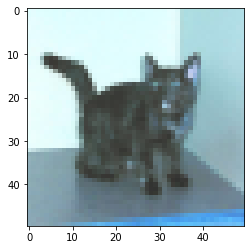

correct class is 0 but predict is 1


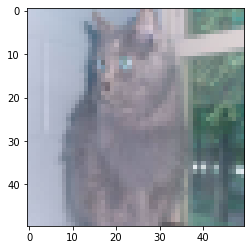

correct class is 0 but predict is 1


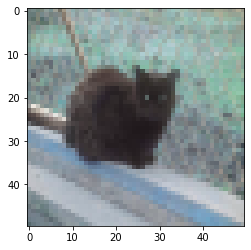

correct class is 0 but predict is 1


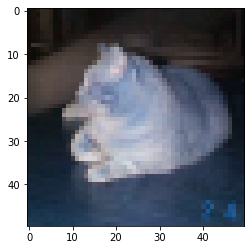

correct class is 0 but predict is 1


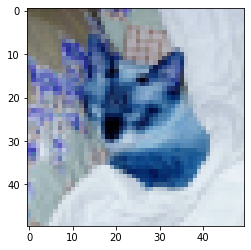

correct class is 0 but predict is 1


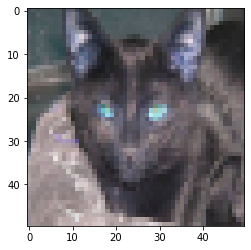

correct class is 0 but predict is 1


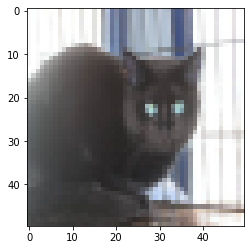

correct class is 0 but predict is 1


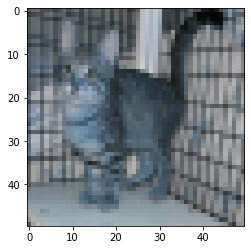

correct class is 0 but predict is 1


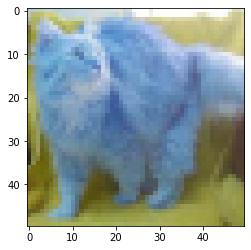

correct class is 0 but predict is 1


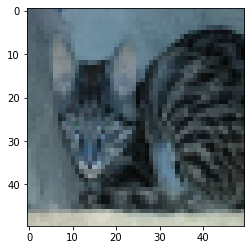

correct class is 0 but predict is 0


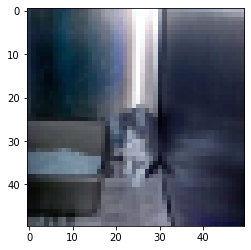

correct class is 0 but predict is 1


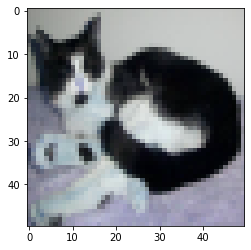

correct class is 0 but predict is 1


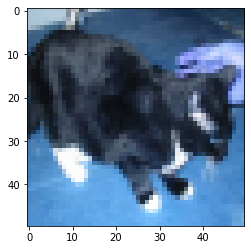

correct class is 0 but predict is 1


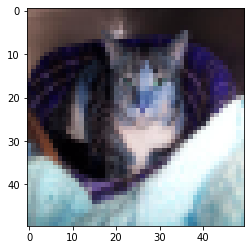

correct class is 0 but predict is 1


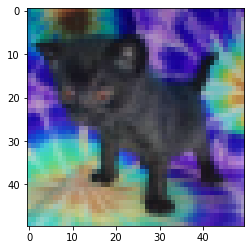

correct class is 0 but predict is 1


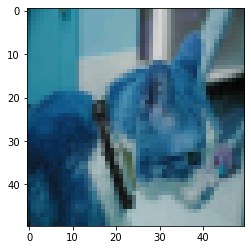

correct class is 0 but predict is 0


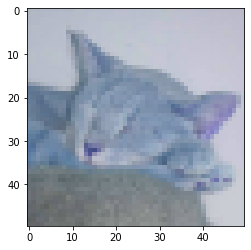

correct class is 0 but predict is 1


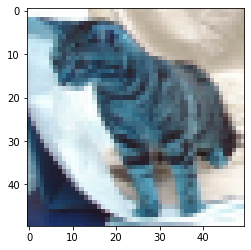

correct class is 0 but predict is 1


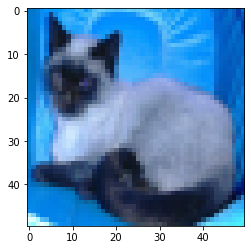

correct class is 0 but predict is 1


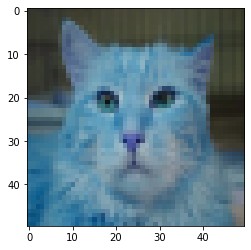

correct class is 0 but predict is 1


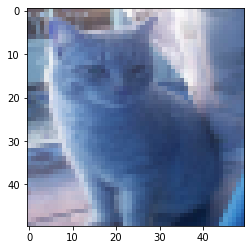

correct class is 0 but predict is 1


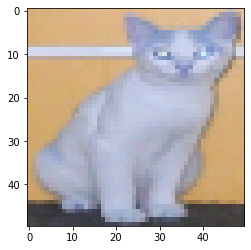

correct class is 0 but predict is 0


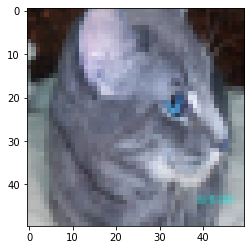

correct class is 0 but predict is 1


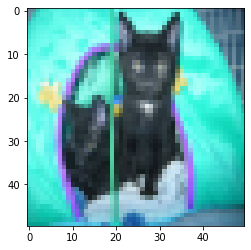

correct class is 0 but predict is 1


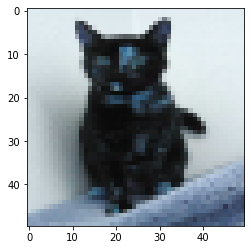

correct class is 0 but predict is 1


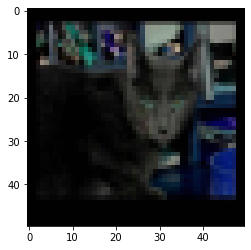

correct class is 0 but predict is 1


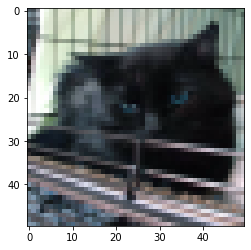

correct class is 0 but predict is 1


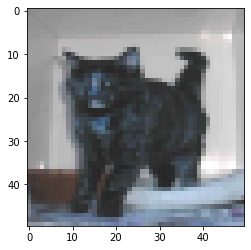

correct class is 0 but predict is 1


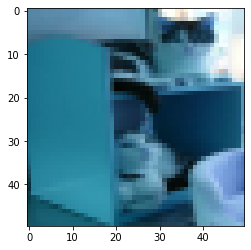

correct class is 0 but predict is 1


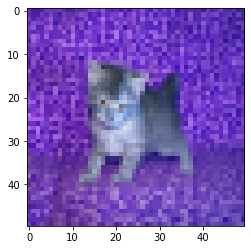

correct class is 0 but predict is 0


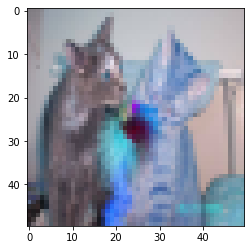

correct class is 0 but predict is 1


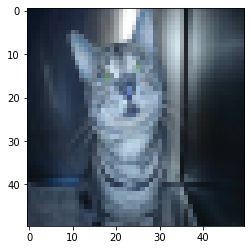

correct class is 0 but predict is 1


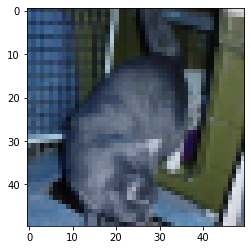

correct class is 0 but predict is 1


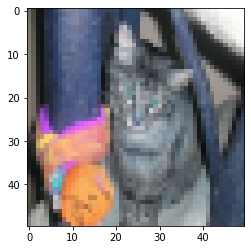

correct class is 0 but predict is 0


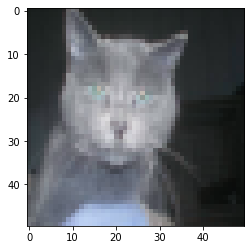

correct class is 0 but predict is 1


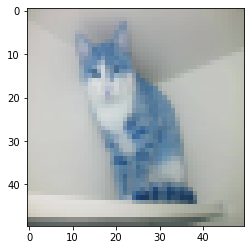

correct class is 0 but predict is 1


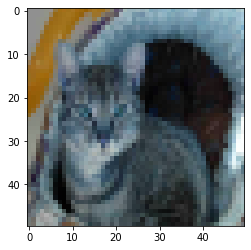

correct class is 0 but predict is 1


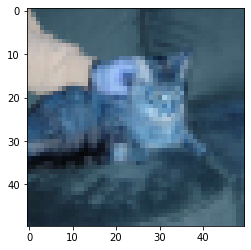

correct class is 0 but predict is 1


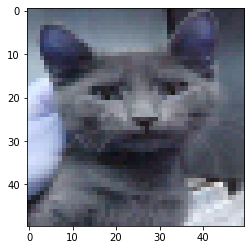

correct class is 0 but predict is 1


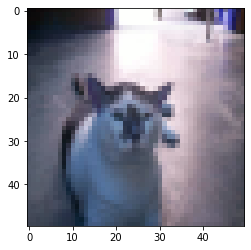

correct class is 0 but predict is 1


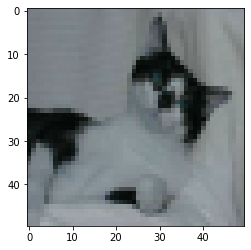

correct class is 0 but predict is 1


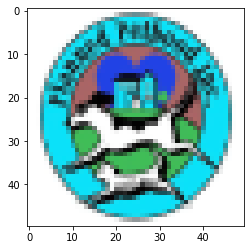

correct class is 0 but predict is 1


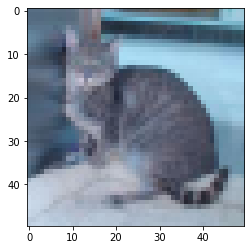

correct class is 0 but predict is 1


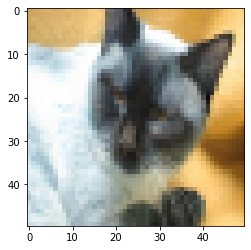

correct class is 0 but predict is 1


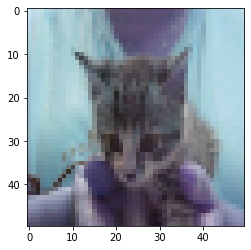

correct class is 0 but predict is 1


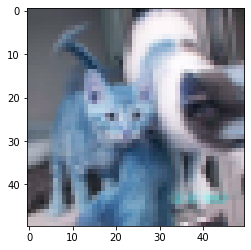

correct class is 0 but predict is 1


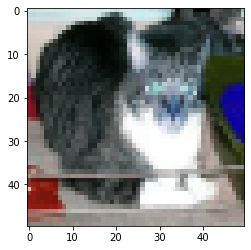

correct class is 0 but predict is 1


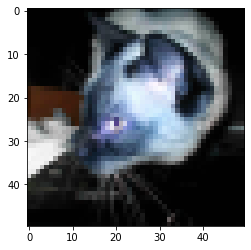

correct class is 0 but predict is 1


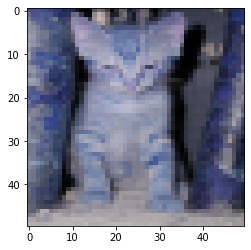

correct class is 0 but predict is 1


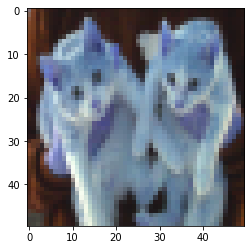

correct class is 0 but predict is 1


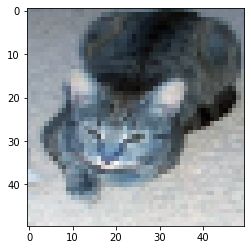

correct class is 0 but predict is 1


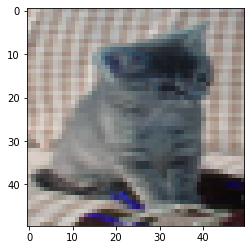

correct class is 0 but predict is 1


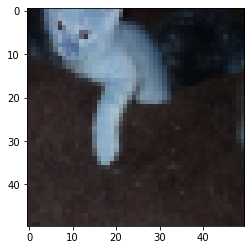

correct class is 0 but predict is 1


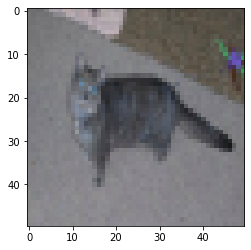

correct class is 0 but predict is 1


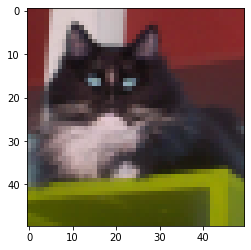

correct class is 0 but predict is 1


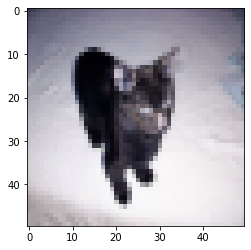

correct class is 0 but predict is 1


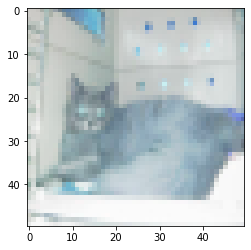

correct class is 0 but predict is 1


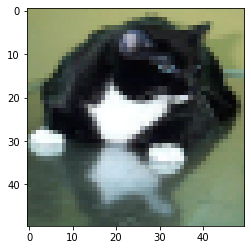

correct class is 0 but predict is 1


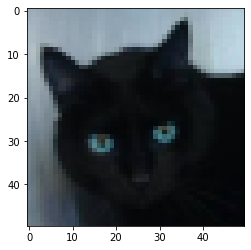

correct class is 0 but predict is 0


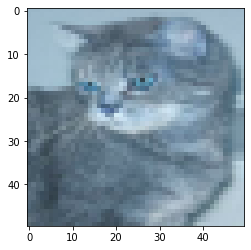

correct class is 0 but predict is 1


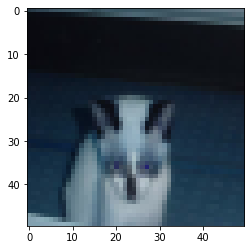

correct class is 0 but predict is 0


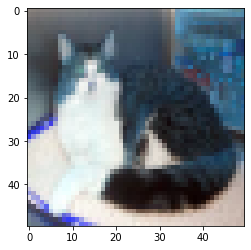

correct class is 0 but predict is 0


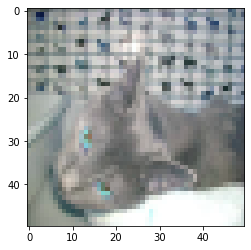

correct class is 0 but predict is 0


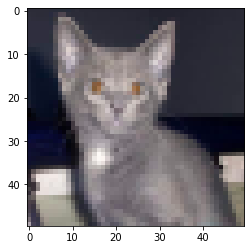

correct class is 0 but predict is 0


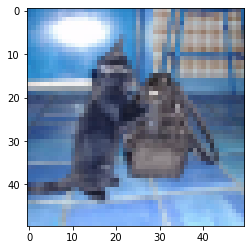

correct class is 0 but predict is 0


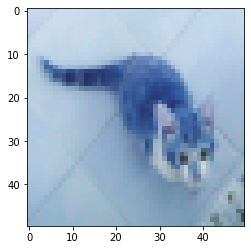

correct class is 0 but predict is 1


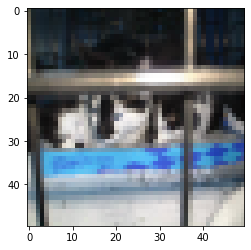

correct class is 0 but predict is 1


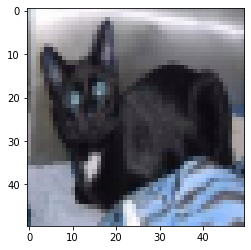

correct class is 0 but predict is 1


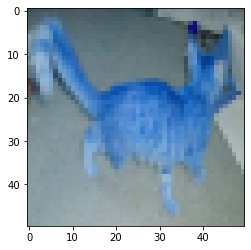

correct class is 0 but predict is 1


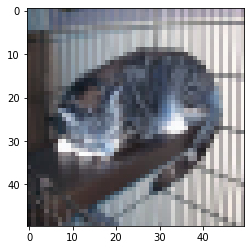

correct class is 0 but predict is 1


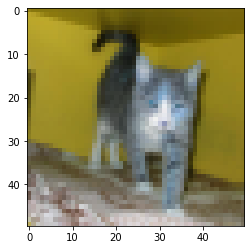

correct class is 0 but predict is 1


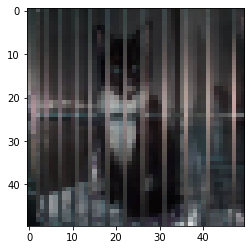

correct class is 0 but predict is 1


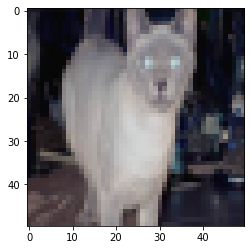

correct class is 0 but predict is 1


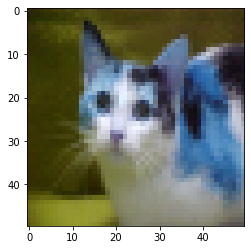

correct class is 0 but predict is 1


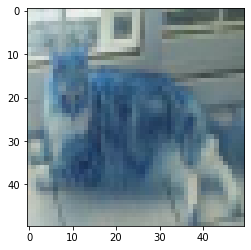

correct class is 0 but predict is 1


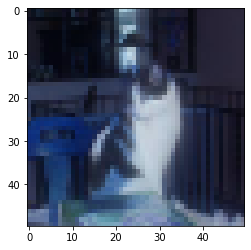

correct class is 0 but predict is 0


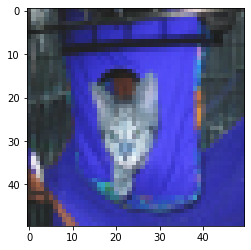

correct class is 0 but predict is 1


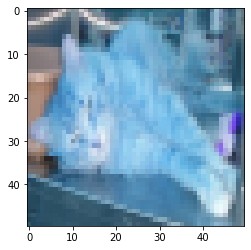

correct class is 0 but predict is 1


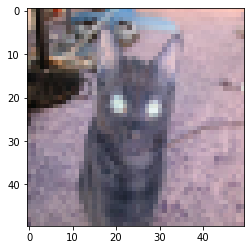

correct class is 0 but predict is 1


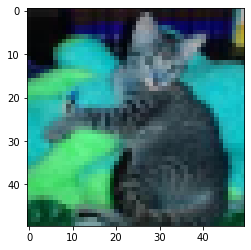

correct class is 0 but predict is 1


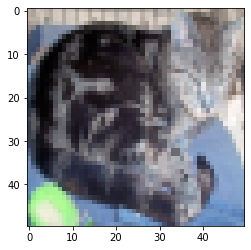

correct class is 0 but predict is 1


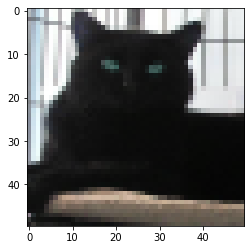

correct class is 0 but predict is 1


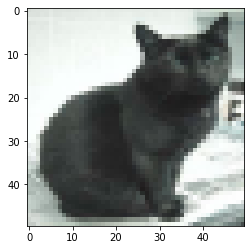

correct class is 0 but predict is 1


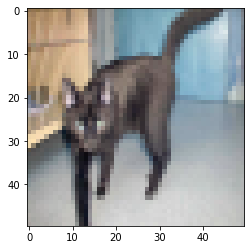

correct class is 0 but predict is 0


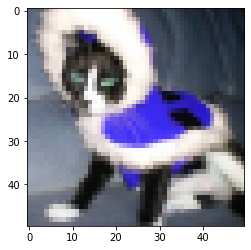

correct class is 0 but predict is 1


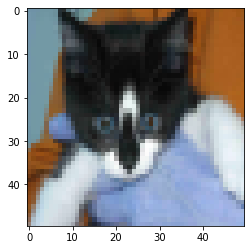

correct class is 0 but predict is 1


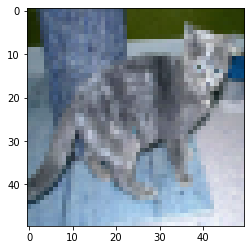

correct class is 0 but predict is 1


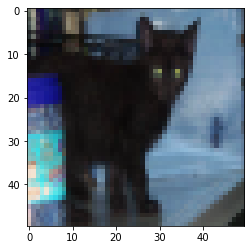

correct class is 0 but predict is 1


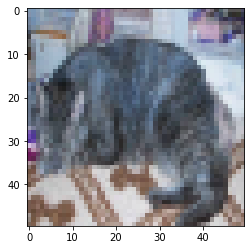

correct class is 0 but predict is 0


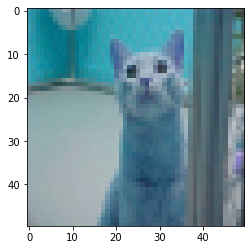

correct class is 0 but predict is 1


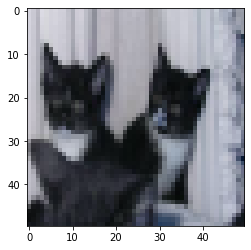

correct class is 0 but predict is 1


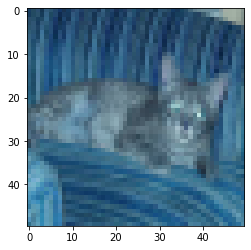

correct class is 0 but predict is 1


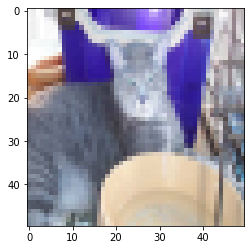

correct class is 0 but predict is 1


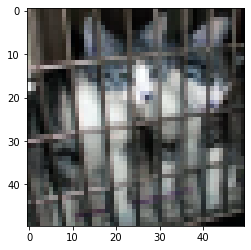

correct class is 0 but predict is 1


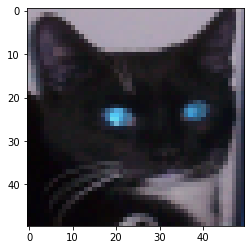

correct class is 0 but predict is 1


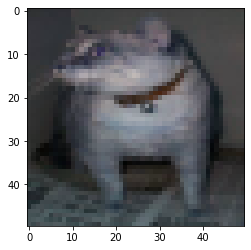

correct class is 0 but predict is 1


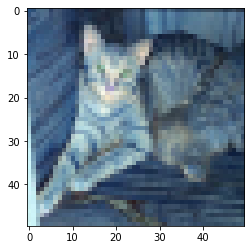

correct class is 0 but predict is 0


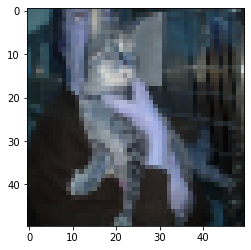

correct class is 0 but predict is 1


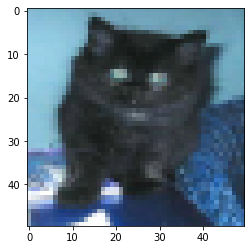

correct class is 0 but predict is 0


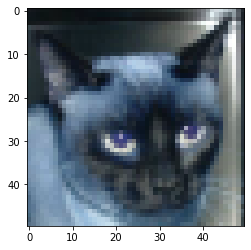

correct class is 0 but predict is 1


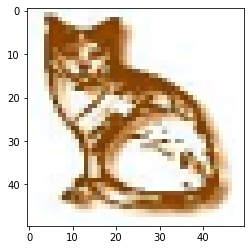

correct class is 0 but predict is 1


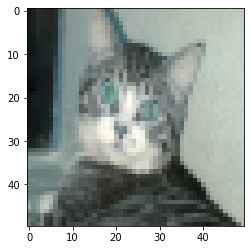

correct class is 0 but predict is 1


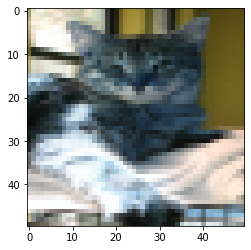

correct class is 0 but predict is 1


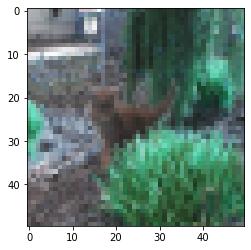

correct class is 0 but predict is 1


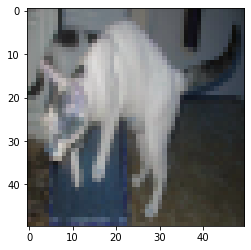

correct class is 0 but predict is 1


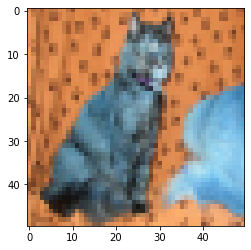

correct class is 0 but predict is 1


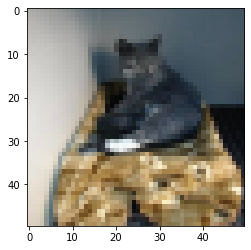

correct class is 0 but predict is 0


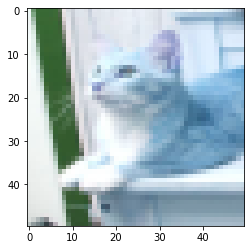

correct class is 0 but predict is 1


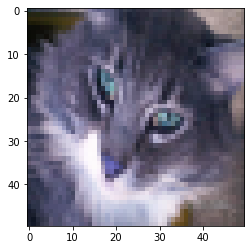

correct class is 0 but predict is 1


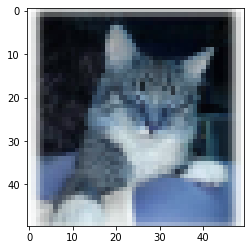

correct class is 0 but predict is 1


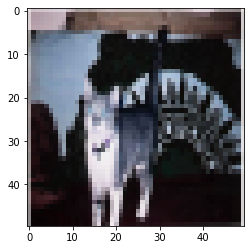

correct class is 0 but predict is 0


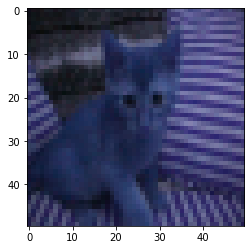

correct class is 0 but predict is 1


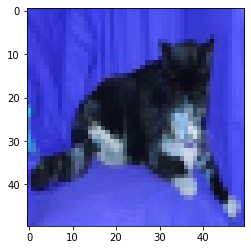

correct class is 0 but predict is 1


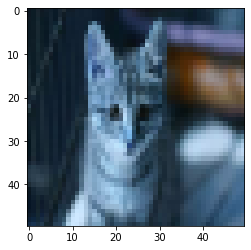

correct class is 0 but predict is 1


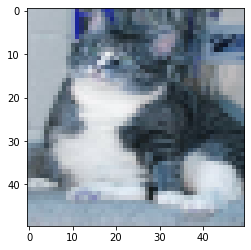

correct class is 0 but predict is 0


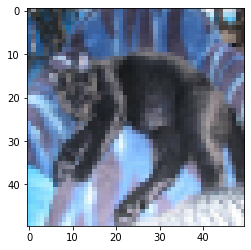

correct class is 0 but predict is 0


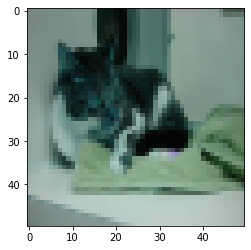

correct class is 0 but predict is 0


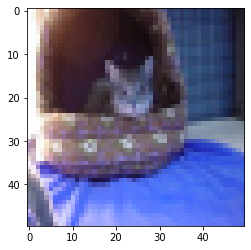

correct class is 0 but predict is 1


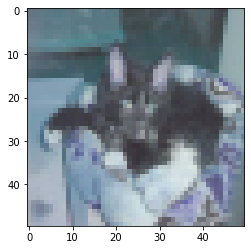

correct class is 0 but predict is 1


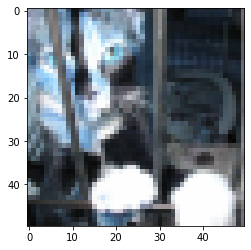

correct class is 0 but predict is 1


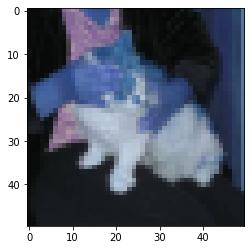

correct class is 0 but predict is 1


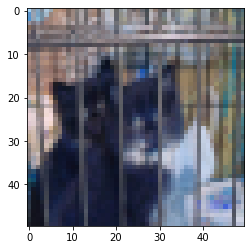

correct class is 0 but predict is 1


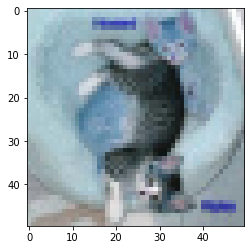

correct class is 0 but predict is 1


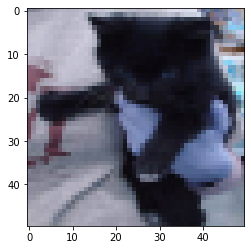

correct class is 0 but predict is 1


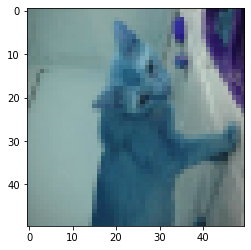

correct class is 0 but predict is 1


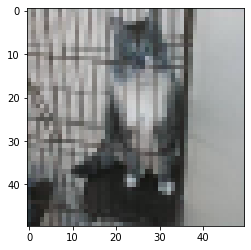

correct class is 0 but predict is 1


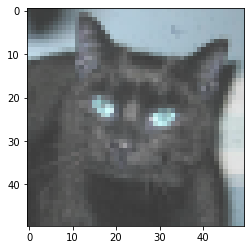

correct class is 0 but predict is 1


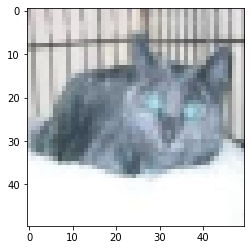

correct class is 0 but predict is 0


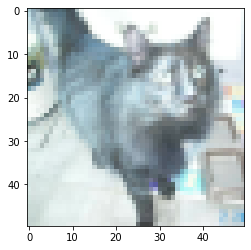

correct class is 0 but predict is 1


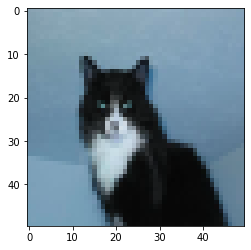

correct class is 0 but predict is 0


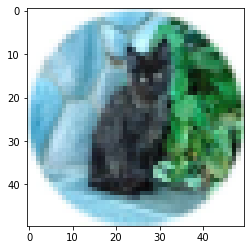

correct class is 0 but predict is 1


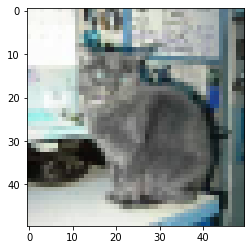

correct class is 0 but predict is 1


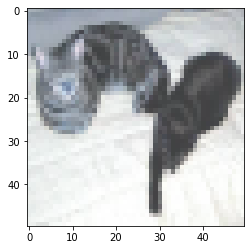

correct class is 0 but predict is 1


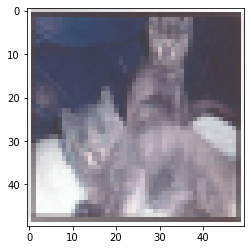

correct class is 0 but predict is 1


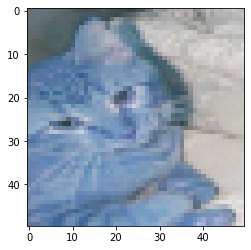

correct class is 0 but predict is 1


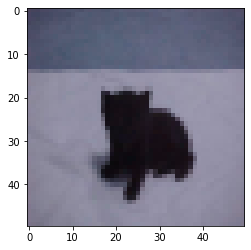

correct class is 0 but predict is 1


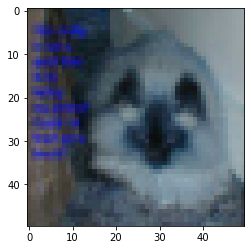

correct class is 0 but predict is 1


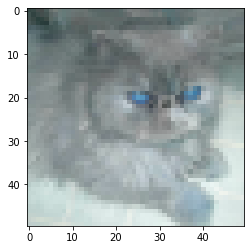

correct class is 0 but predict is 1


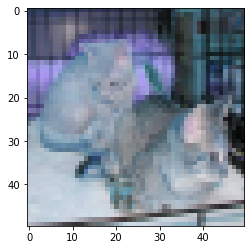

correct class is 0 but predict is 1


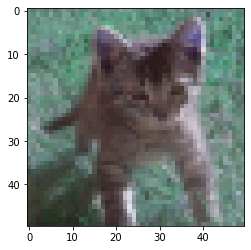

correct class is 0 but predict is 1


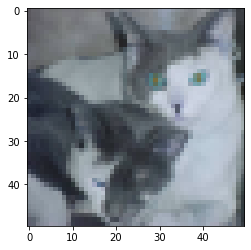

correct class is 0 but predict is 1


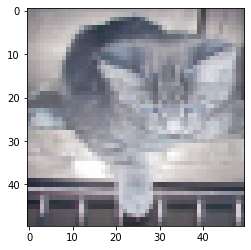

correct class is 0 but predict is 0


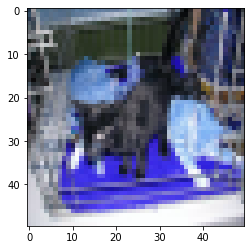

correct class is 0 but predict is 1


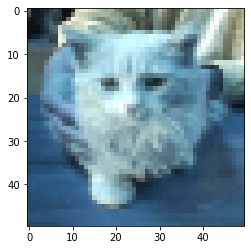

correct class is 0 but predict is 1


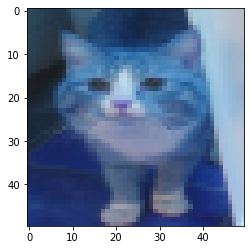

correct class is 0 but predict is 1


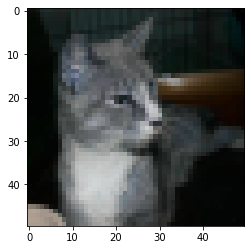

correct class is 0 but predict is 0


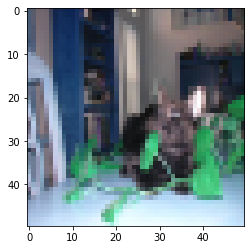

correct class is 0 but predict is 1


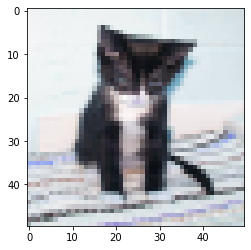

correct class is 0 but predict is 1


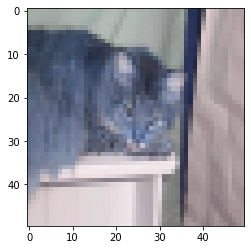

correct class is 0 but predict is 1


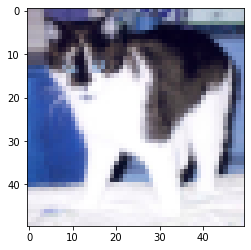

correct class is 0 but predict is 0


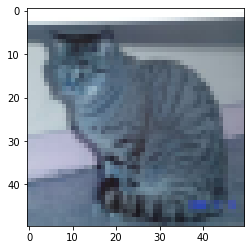

correct class is 0 but predict is 1


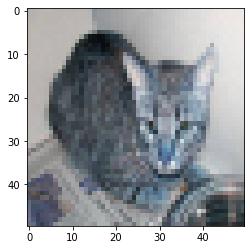

correct class is 0 but predict is 1


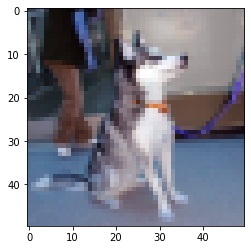

correct class is 1 but predict is 1


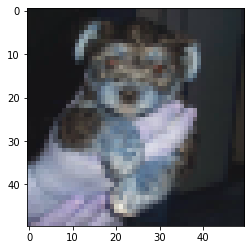

correct class is 1 but predict is 0


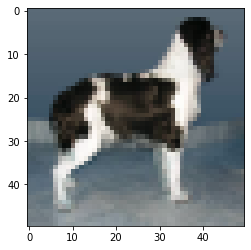

correct class is 1 but predict is 0


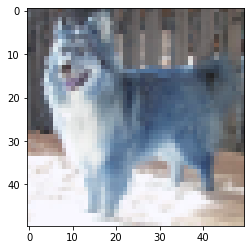

correct class is 1 but predict is 0


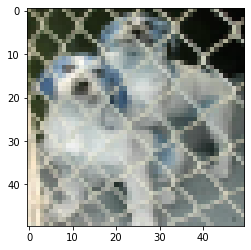

correct class is 1 but predict is 0


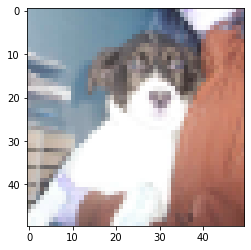

correct class is 1 but predict is 0


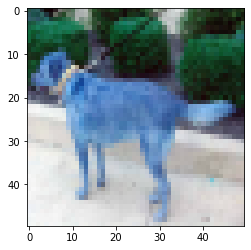

correct class is 1 but predict is 1


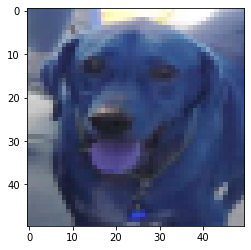

correct class is 1 but predict is 1


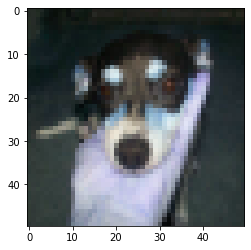

correct class is 1 but predict is 0


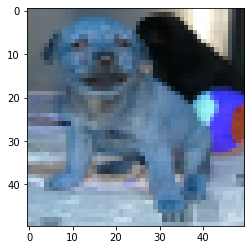

correct class is 1 but predict is 1


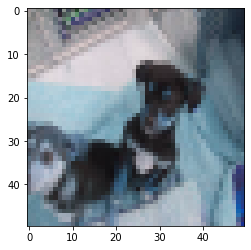

correct class is 1 but predict is 0


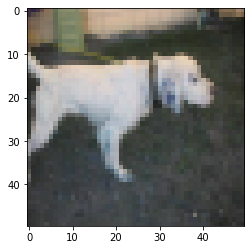

correct class is 1 but predict is 0


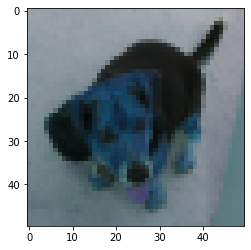

correct class is 1 but predict is 0


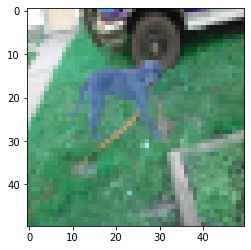

correct class is 1 but predict is 1


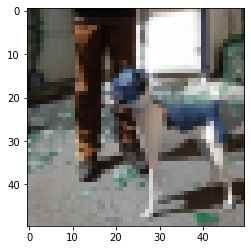

correct class is 1 but predict is 0


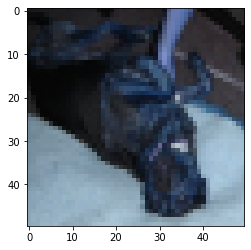

correct class is 1 but predict is 0


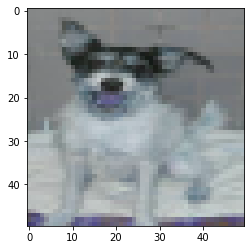

correct class is 1 but predict is 0


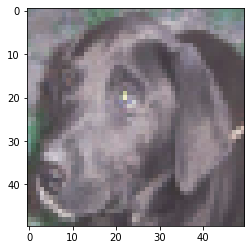

correct class is 1 but predict is 1


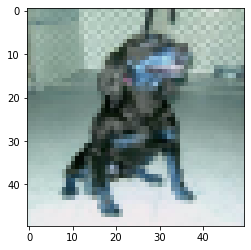

correct class is 1 but predict is 0


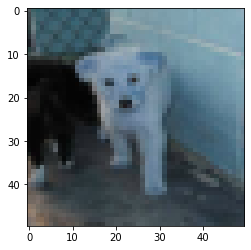

correct class is 1 but predict is 0


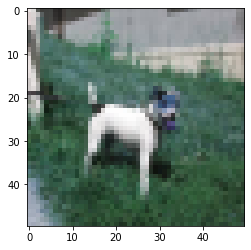

correct class is 1 but predict is 0


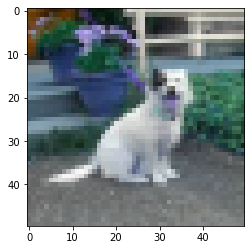

correct class is 1 but predict is 0


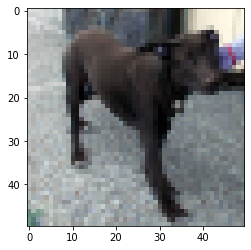

correct class is 1 but predict is 1


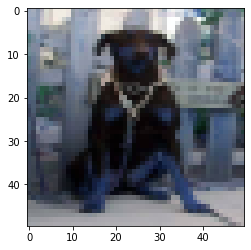

correct class is 1 but predict is 0


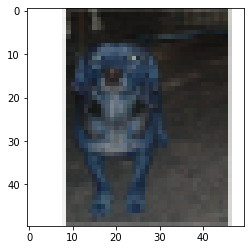

correct class is 1 but predict is 1


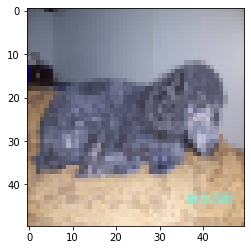

correct class is 1 but predict is 0


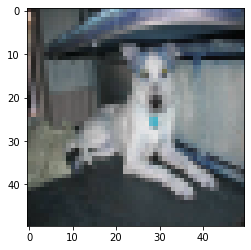

correct class is 1 but predict is 0


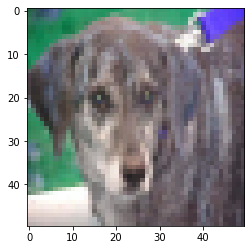

correct class is 1 but predict is 0


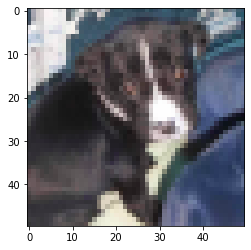

correct class is 1 but predict is 0


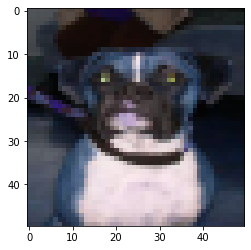

correct class is 1 but predict is 0


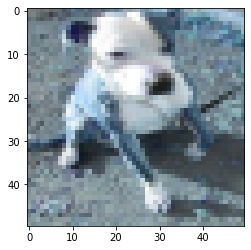

correct class is 1 but predict is 1


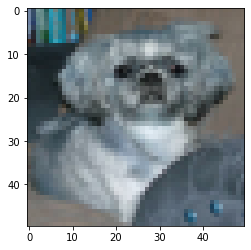

correct class is 1 but predict is 0


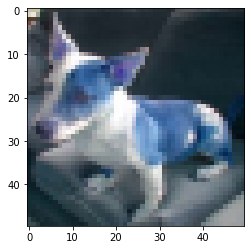

correct class is 1 but predict is 0


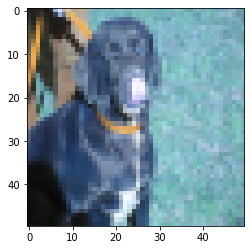

correct class is 1 but predict is 0


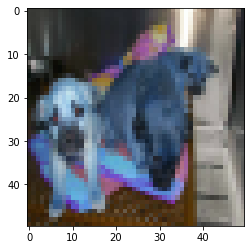

correct class is 1 but predict is 0


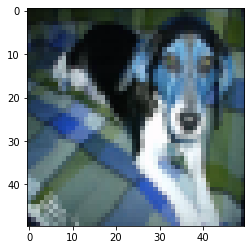

correct class is 1 but predict is 0


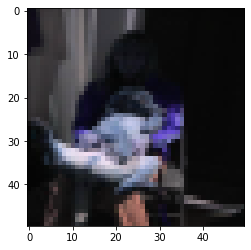

correct class is 1 but predict is 0


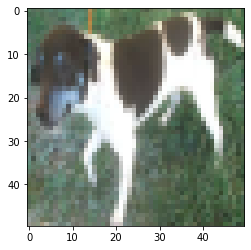

correct class is 1 but predict is 0


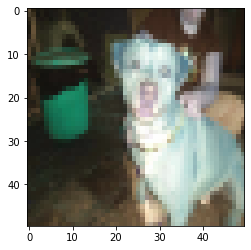

correct class is 1 but predict is 0


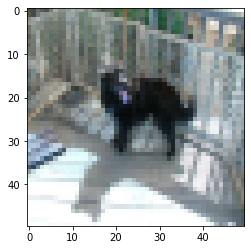

correct class is 1 but predict is 0


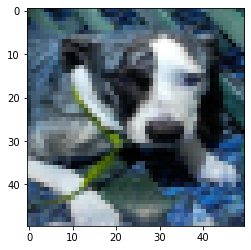

correct class is 1 but predict is 0


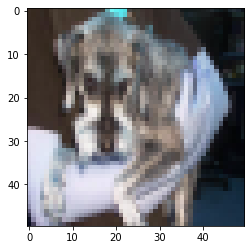

correct class is 1 but predict is 0


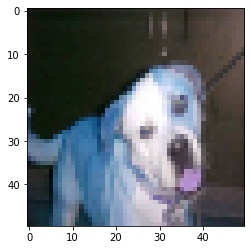

correct class is 1 but predict is 0


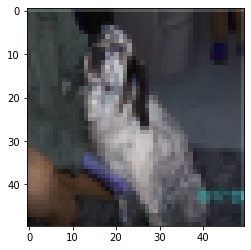

correct class is 1 but predict is 0


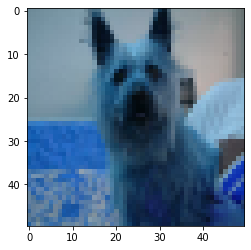

correct class is 1 but predict is 0


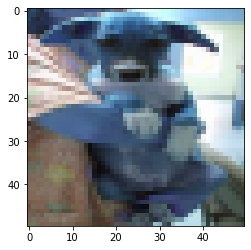

correct class is 1 but predict is 1


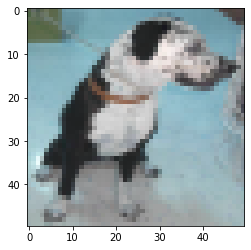

correct class is 1 but predict is 0


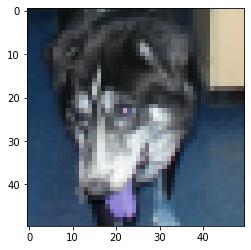

correct class is 1 but predict is 0


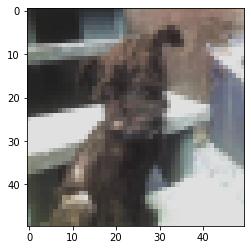

correct class is 1 but predict is 1


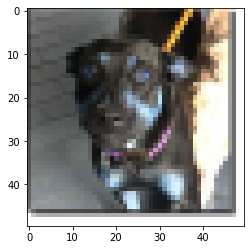

correct class is 1 but predict is 0


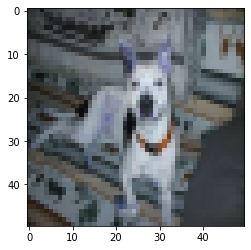

correct class is 1 but predict is 0


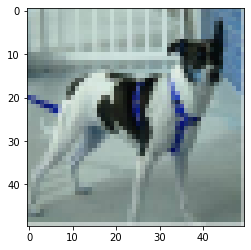

correct class is 1 but predict is 1


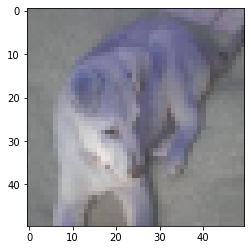

correct class is 1 but predict is 1


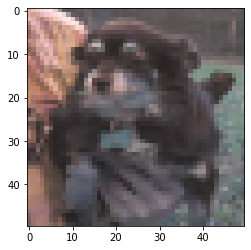

correct class is 1 but predict is 0


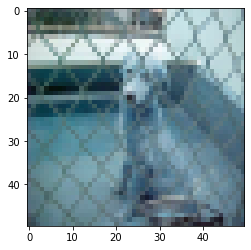

correct class is 1 but predict is 1


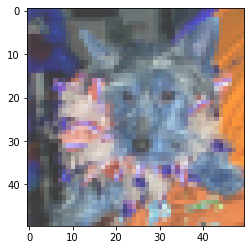

correct class is 1 but predict is 0


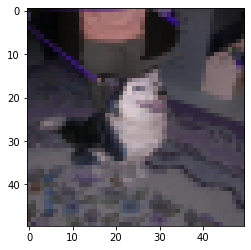

correct class is 1 but predict is 1


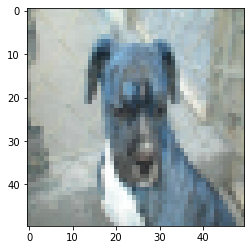

correct class is 1 but predict is 0


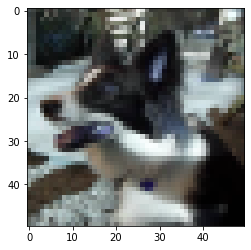

correct class is 1 but predict is 0


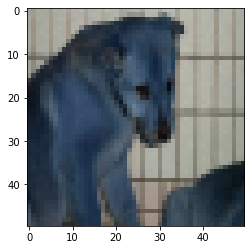

correct class is 1 but predict is 0


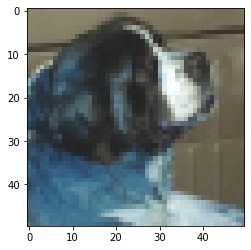

correct class is 1 but predict is 0


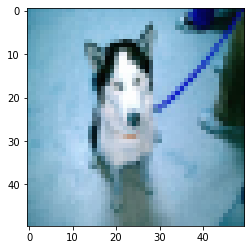

correct class is 1 but predict is 0


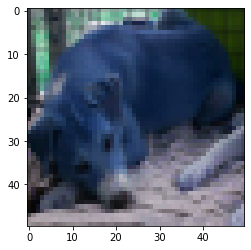

correct class is 1 but predict is 0


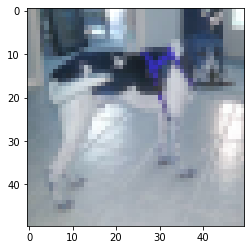

correct class is 1 but predict is 1


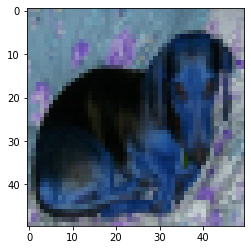

correct class is 1 but predict is 0


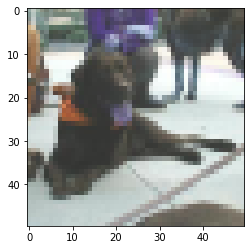

correct class is 1 but predict is 0


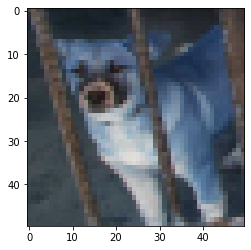

correct class is 1 but predict is 0


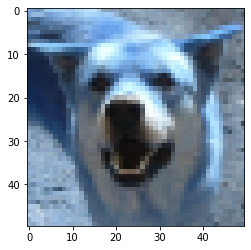

correct class is 1 but predict is 0


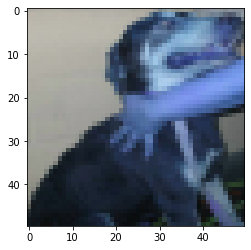

correct class is 1 but predict is 0


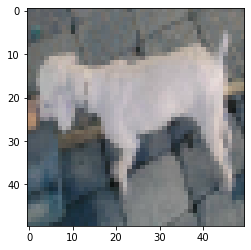

correct class is 1 but predict is 0


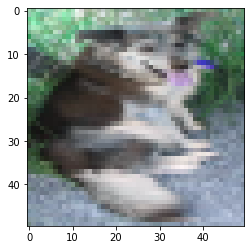

correct class is 1 but predict is 0


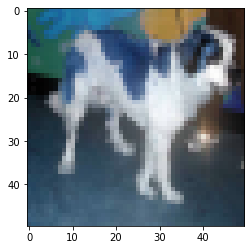

correct class is 1 but predict is 0


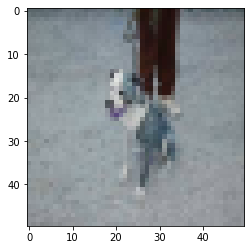

correct class is 1 but predict is 0


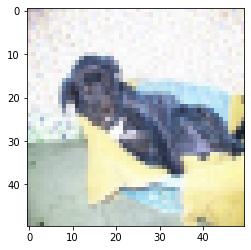

correct class is 1 but predict is 1


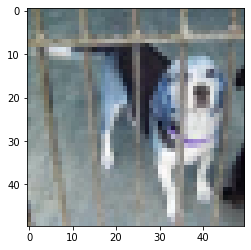

correct class is 1 but predict is 0


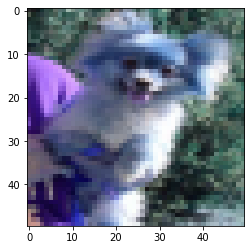

correct class is 1 but predict is 0


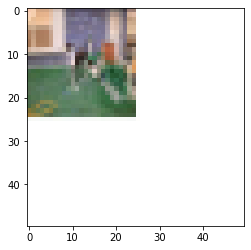

correct class is 1 but predict is 0


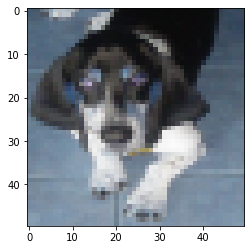

correct class is 1 but predict is 1


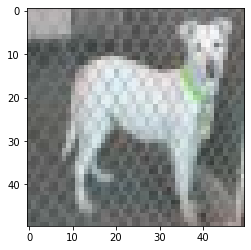

correct class is 1 but predict is 1


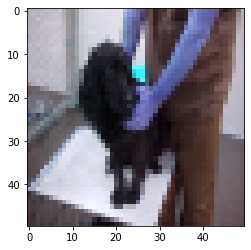

correct class is 1 but predict is 1


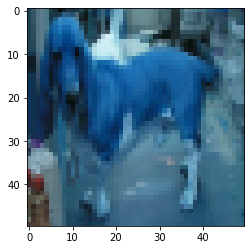

correct class is 1 but predict is 0


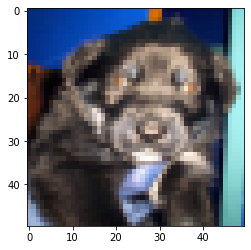

correct class is 1 but predict is 0


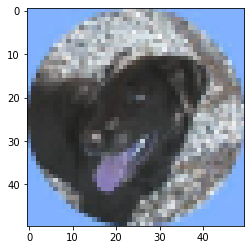

correct class is 1 but predict is 0


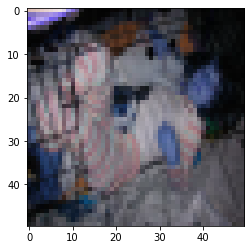

correct class is 1 but predict is 0


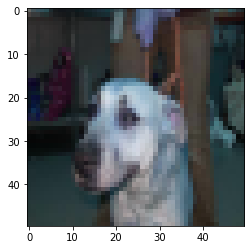

correct class is 1 but predict is 0


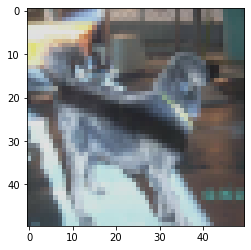

correct class is 1 but predict is 0


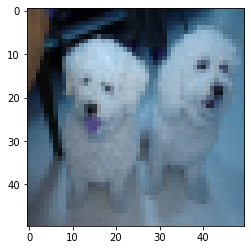

correct class is 1 but predict is 1


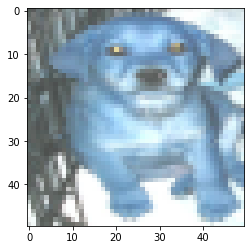

correct class is 1 but predict is 1


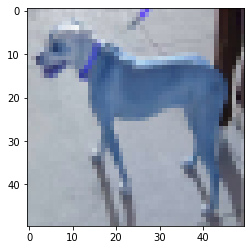

correct class is 1 but predict is 1


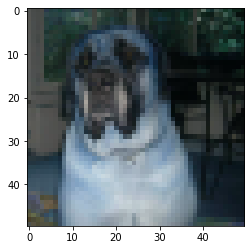

correct class is 1 but predict is 0


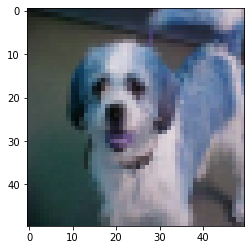

correct class is 1 but predict is 0


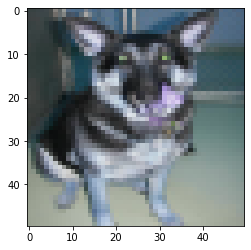

correct class is 1 but predict is 0


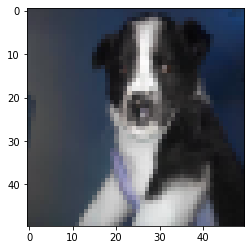

correct class is 1 but predict is 0


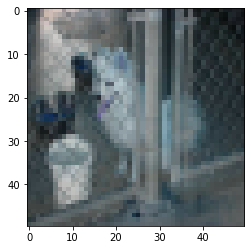

correct class is 1 but predict is 0


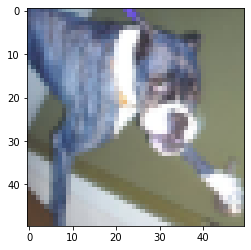

correct class is 1 but predict is 1


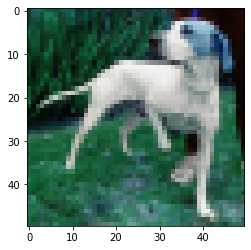

correct class is 1 but predict is 1


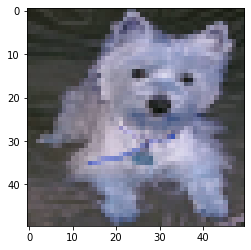

correct class is 1 but predict is 0


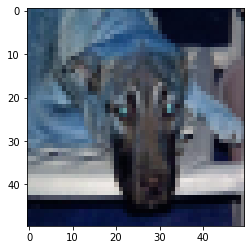

correct class is 1 but predict is 0


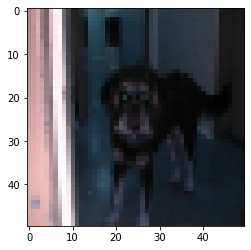

correct class is 1 but predict is 0


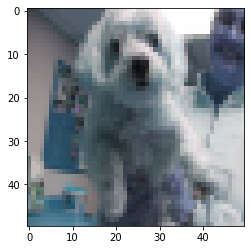

correct class is 1 but predict is 0


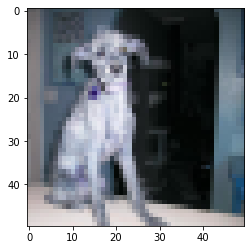

correct class is 1 but predict is 0


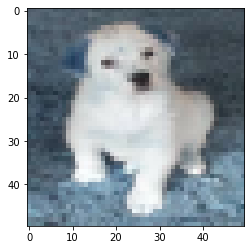

correct class is 1 but predict is 0


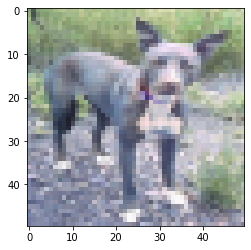

correct class is 1 but predict is 1


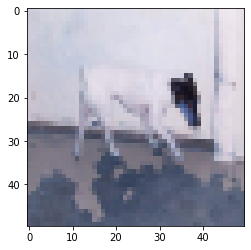

correct class is 1 but predict is 0


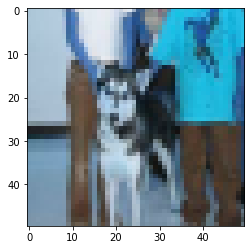

correct class is 1 but predict is 1


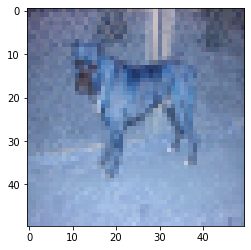

correct class is 1 but predict is 1


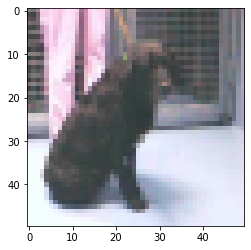

correct class is 1 but predict is 0


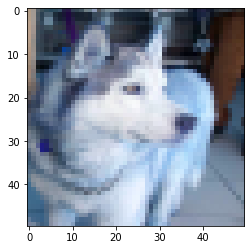

correct class is 1 but predict is 1


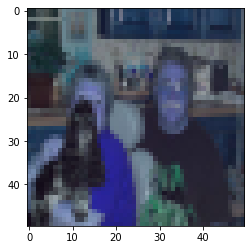

correct class is 1 but predict is 0


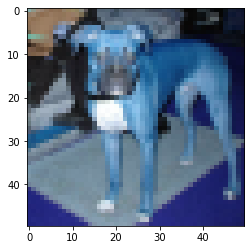

correct class is 1 but predict is 0


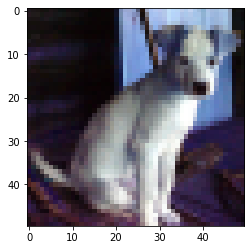

correct class is 1 but predict is 0


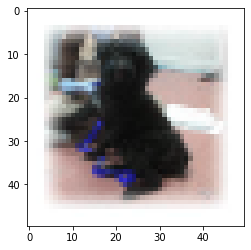

correct class is 1 but predict is 0


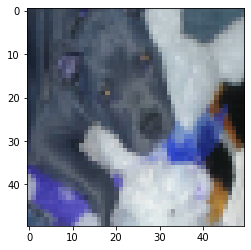

correct class is 1 but predict is 0


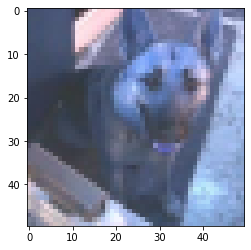

correct class is 1 but predict is 0


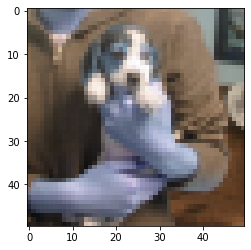

correct class is 1 but predict is 0


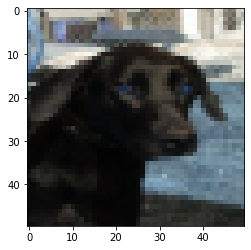

correct class is 1 but predict is 1


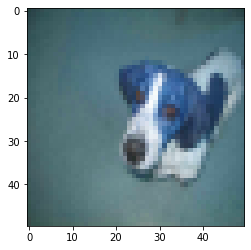

correct class is 1 but predict is 0


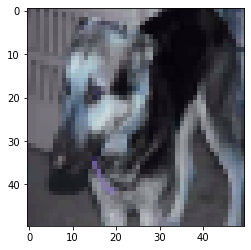

correct class is 1 but predict is 1


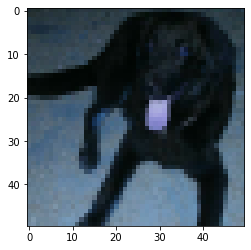

correct class is 1 but predict is 1


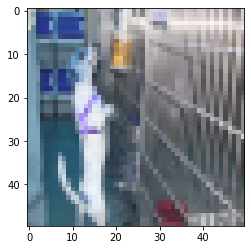

correct class is 1 but predict is 0


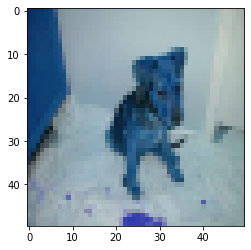

correct class is 1 but predict is 0


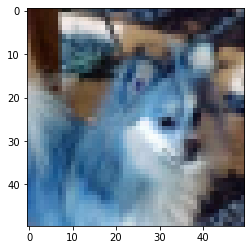

correct class is 1 but predict is 0


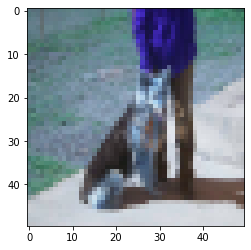

correct class is 1 but predict is 1


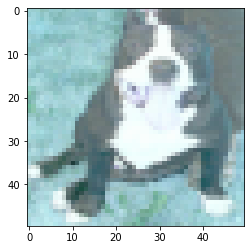

correct class is 1 but predict is 0


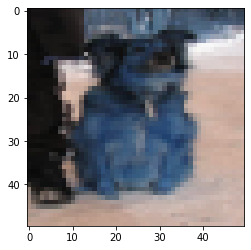

correct class is 1 but predict is 0


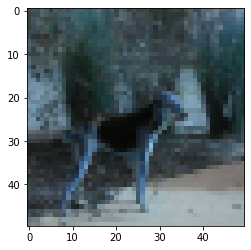

correct class is 1 but predict is 1


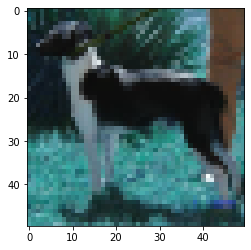

correct class is 1 but predict is 0


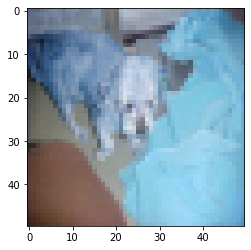

correct class is 1 but predict is 0


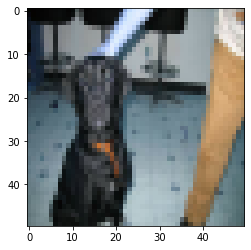

correct class is 1 but predict is 0


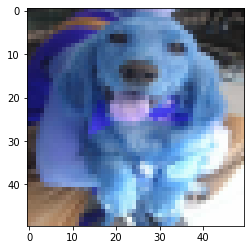

correct class is 1 but predict is 1


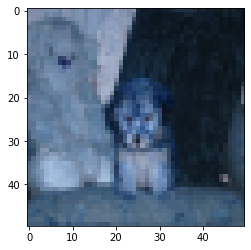

correct class is 1 but predict is 1


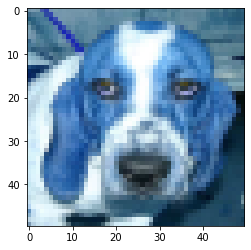

correct class is 1 but predict is 0


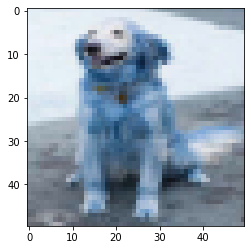

correct class is 1 but predict is 0


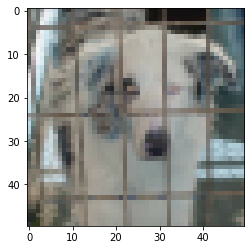

correct class is 1 but predict is 0


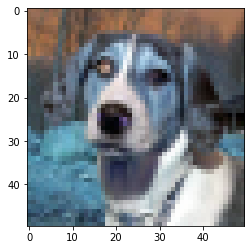

correct class is 1 but predict is 1


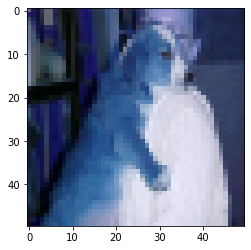

correct class is 1 but predict is 0


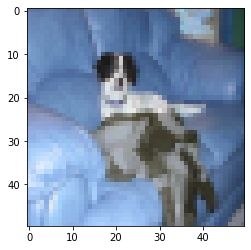

correct class is 1 but predict is 0


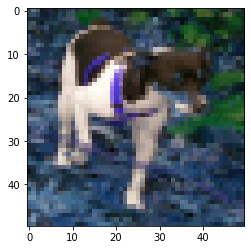

correct class is 1 but predict is 0


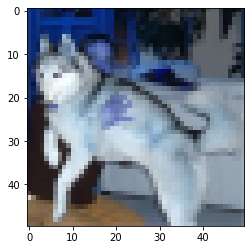

correct class is 1 but predict is 0


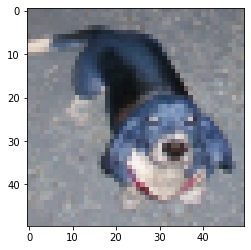

correct class is 1 but predict is 1


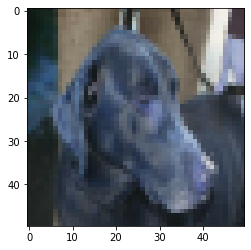

correct class is 1 but predict is 1


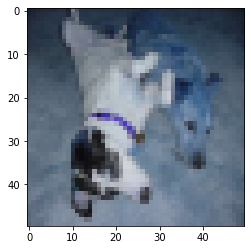

correct class is 1 but predict is 0


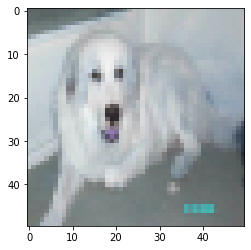

correct class is 1 but predict is 0


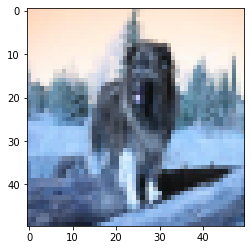

correct class is 1 but predict is 0


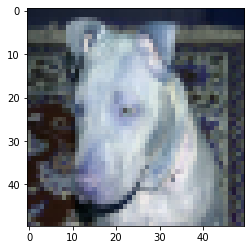

correct class is 1 but predict is 0


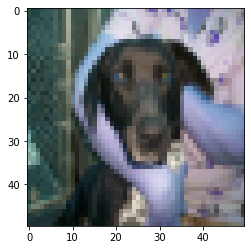

correct class is 1 but predict is 0


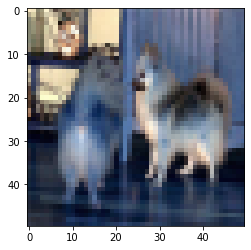

correct class is 1 but predict is 0


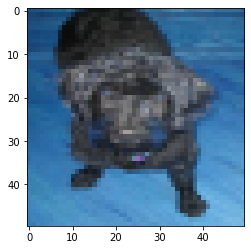

correct class is 1 but predict is 1


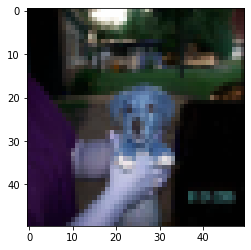

correct class is 1 but predict is 0


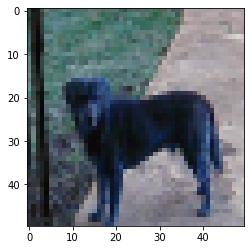

correct class is 1 but predict is 1


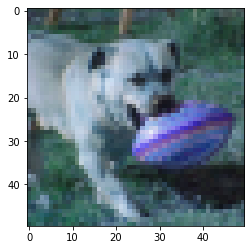

correct class is 1 but predict is 0


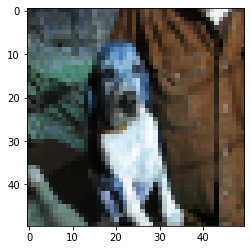

correct class is 1 but predict is 0


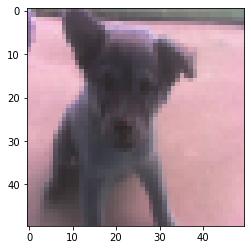

correct class is 1 but predict is 0


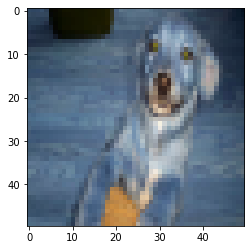

correct class is 1 but predict is 1


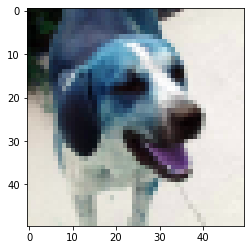

correct class is 1 but predict is 0


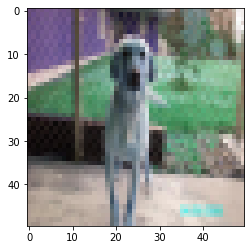

correct class is 1 but predict is 0


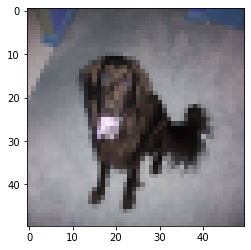

correct class is 1 but predict is 0


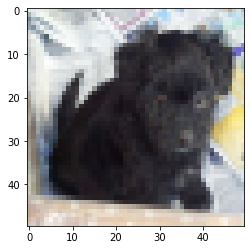

correct class is 1 but predict is 0


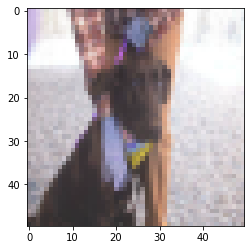

correct class is 1 but predict is 1


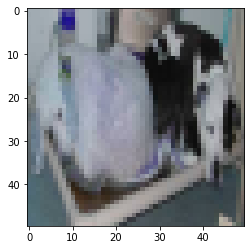

correct class is 1 but predict is 0


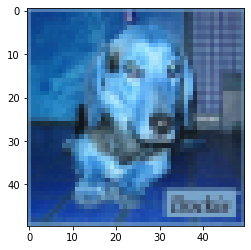

correct class is 1 but predict is 0


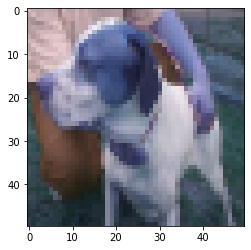

correct class is 1 but predict is 0


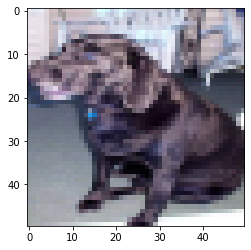

correct class is 1 but predict is 0


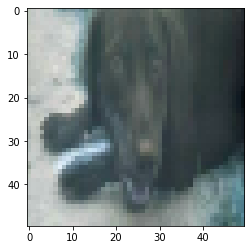

correct class is 1 but predict is 0


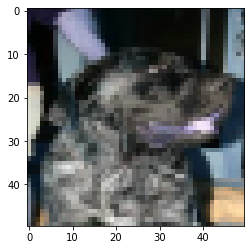

correct class is 1 but predict is 0


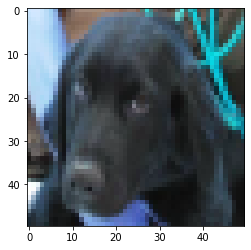

correct class is 1 but predict is 0


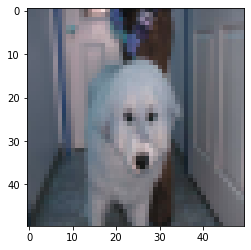

correct class is 1 but predict is 1


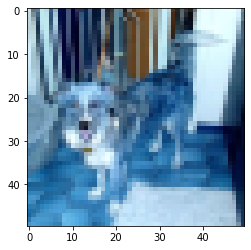

correct class is 1 but predict is 0


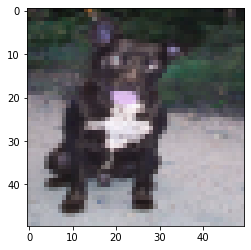

correct class is 1 but predict is 0


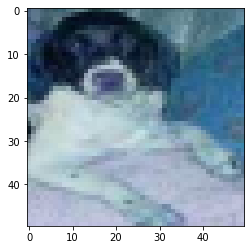

correct class is 1 but predict is 0


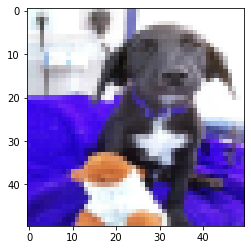

correct class is 1 but predict is 0


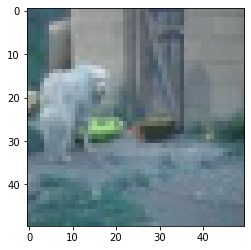

correct class is 1 but predict is 0


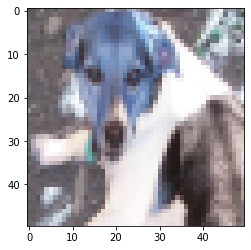

correct class is 1 but predict is 0


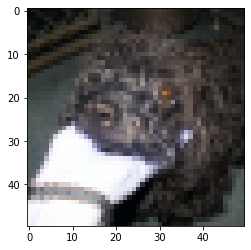

correct class is 1 but predict is 0


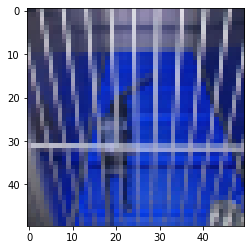

correct class is 1 but predict is 0


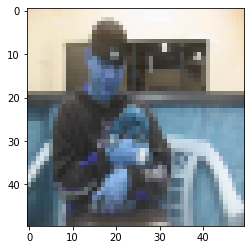

correct class is 1 but predict is 0


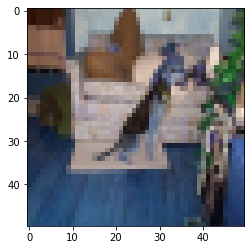

correct class is 1 but predict is 0


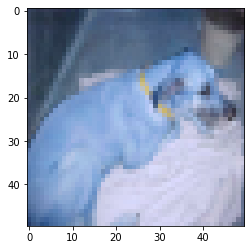

correct class is 1 but predict is 0


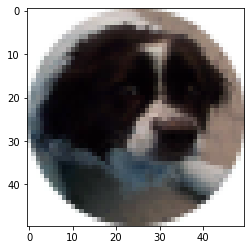

correct class is 1 but predict is 0


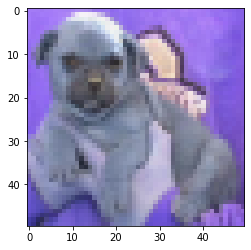

correct class is 1 but predict is 0


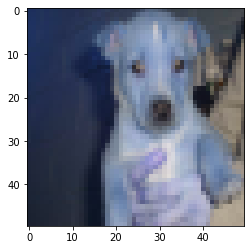

correct class is 1 but predict is 0


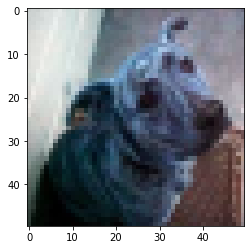

correct class is 1 but predict is 0


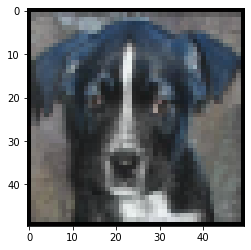

correct class is 1 but predict is 0


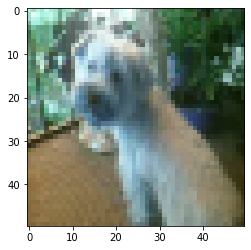

correct class is 1 but predict is 0


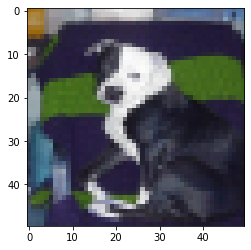

correct class is 1 but predict is 1


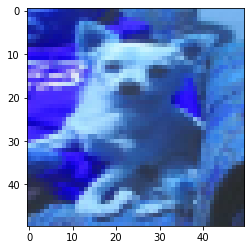

correct class is 1 but predict is 1


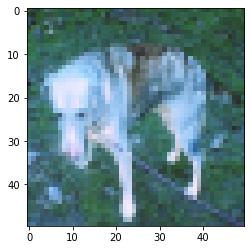

correct class is 1 but predict is 0


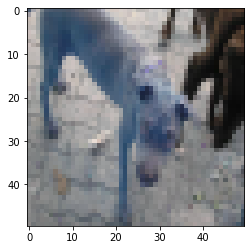

correct class is 1 but predict is 0


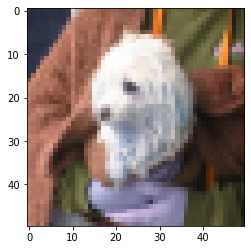

correct class is 1 but predict is 0


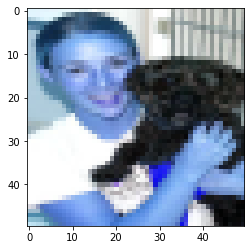

correct class is 1 but predict is 0


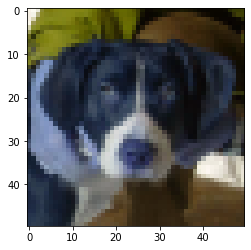

correct class is 1 but predict is 1


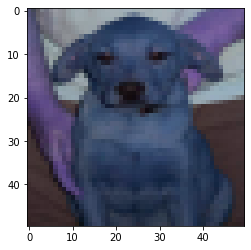

correct class is 1 but predict is 0


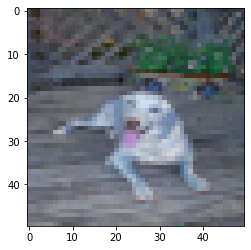

correct class is 1 but predict is 0


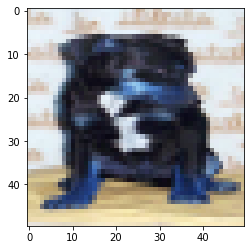

correct class is 1 but predict is 1


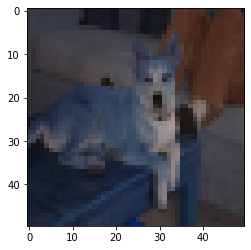

correct class is 1 but predict is 0


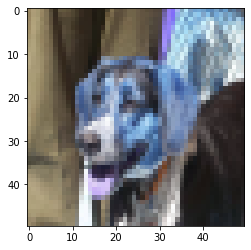

correct class is 1 but predict is 1


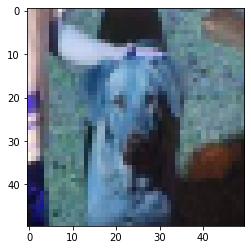

correct class is 1 but predict is 0


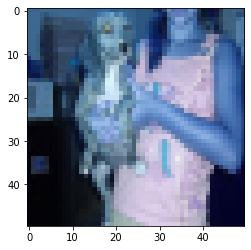

correct class is 1 but predict is 0


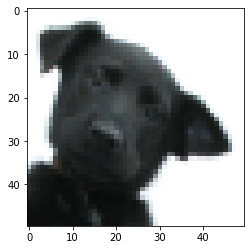

correct class is 1 but predict is 0


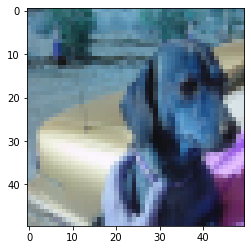

correct class is 1 but predict is 1


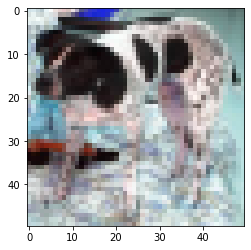

correct class is 1 but predict is 1


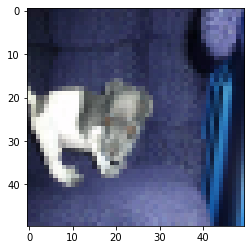

correct class is 1 but predict is 0


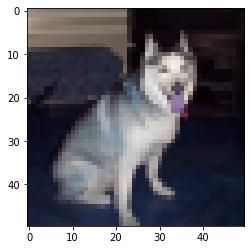

correct class is 1 but predict is 0


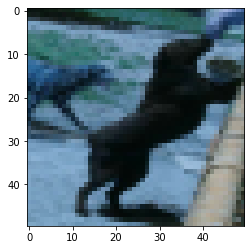

correct class is 1 but predict is 0


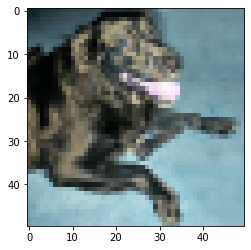

correct class is 1 but predict is 1


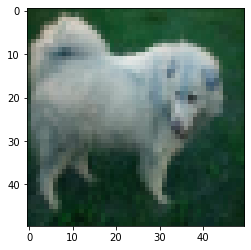

correct class is 1 but predict is 0


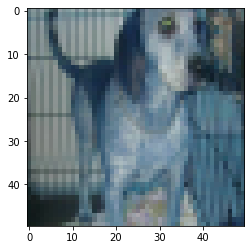

correct class is 1 but predict is 0


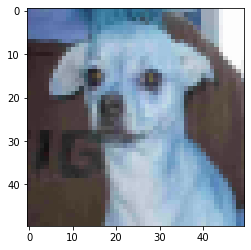

correct class is 1 but predict is 0


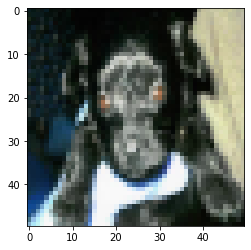

correct class is 1 but predict is 1


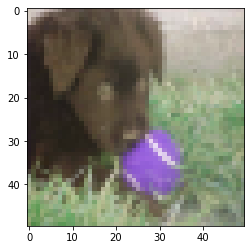

correct class is 1 but predict is 0


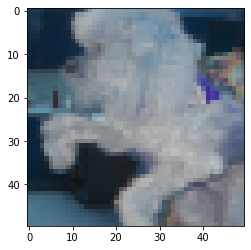

correct class is 1 but predict is 0


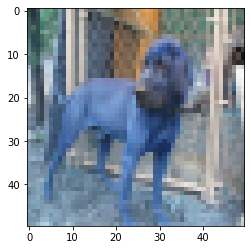

correct class is 1 but predict is 1


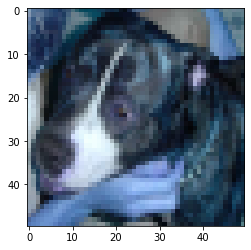

correct class is 1 but predict is 0


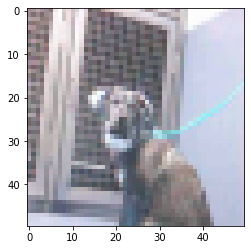

correct class is 1 but predict is 0


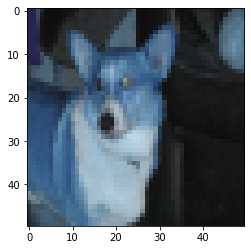

correct class is 1 but predict is 0


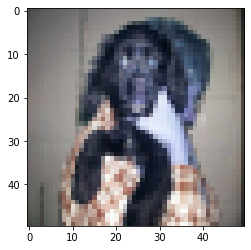

correct class is 1 but predict is 0


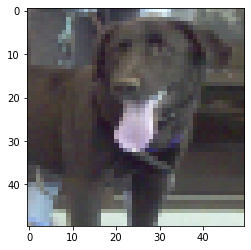

correct class is 1 but predict is 0


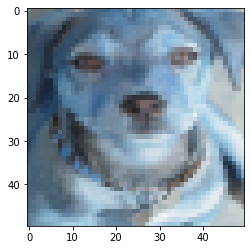

correct class is 1 but predict is 0


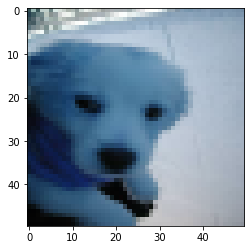

correct class is 1 but predict is 0


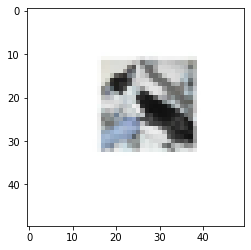

correct class is 1 but predict is 1


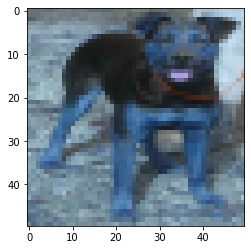

correct class is 1 but predict is 1


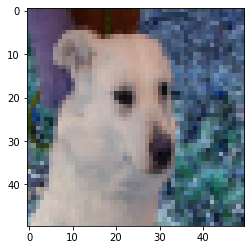

correct class is 1 but predict is 0


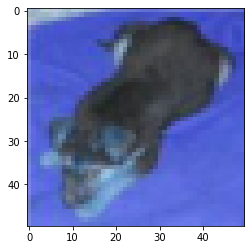

correct class is 1 but predict is 1


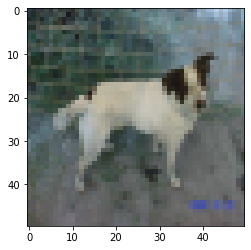

correct class is 1 but predict is 0


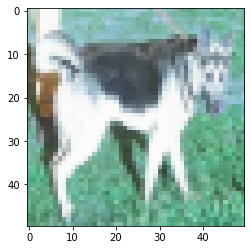

correct class is 1 but predict is 0


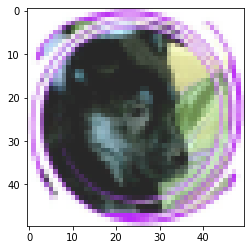

correct class is 1 but predict is 0


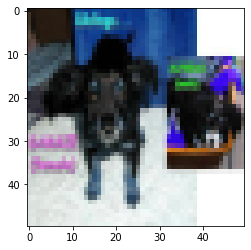

correct class is 1 but predict is 0


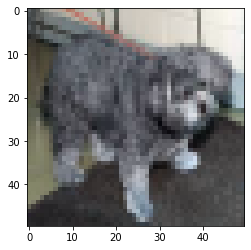

correct class is 1 but predict is 0


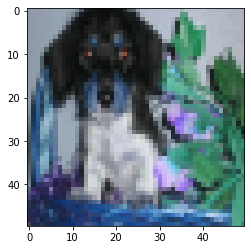

correct class is 1 but predict is 0


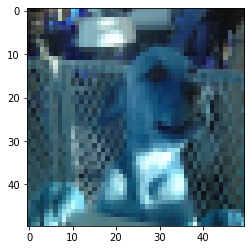

correct class is 1 but predict is 0


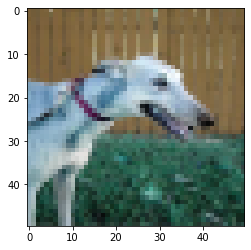

correct class is 1 but predict is 0


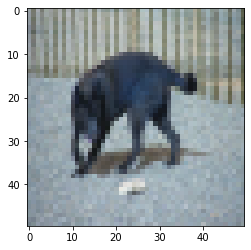

correct class is 1 but predict is 0


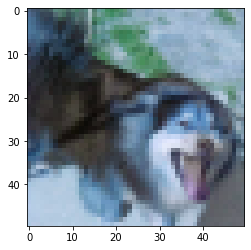

correct class is 1 but predict is 0


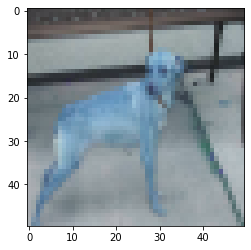

correct class is 1 but predict is 0


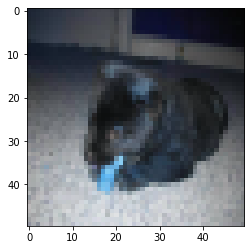

correct class is 1 but predict is 0


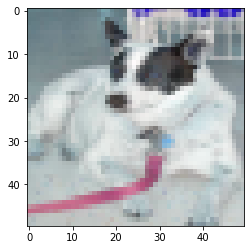

correct class is 1 but predict is 0


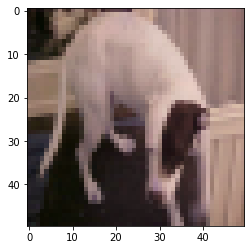

correct class is 1 but predict is 1


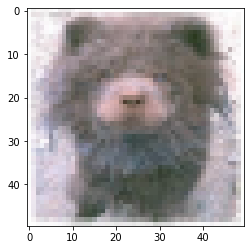

correct class is 1 but predict is 1


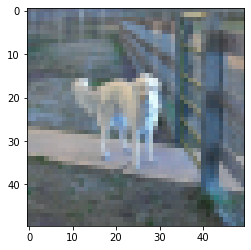

correct class is 1 but predict is 0


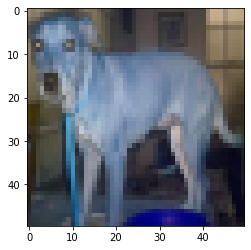

correct class is 1 but predict is 0


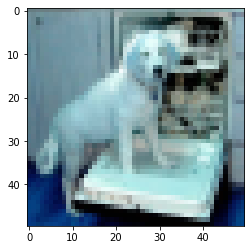

correct class is 1 but predict is 0


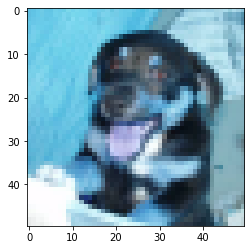

correct class is 1 but predict is 1


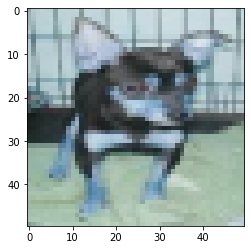

correct class is 1 but predict is 0


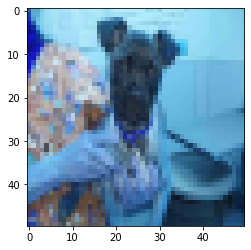

correct class is 1 but predict is 0


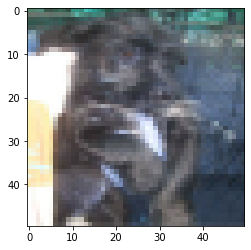

correct class is 1 but predict is 0


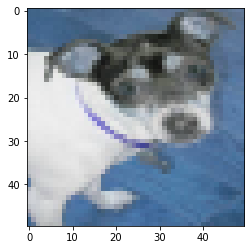

correct class is 1 but predict is 0


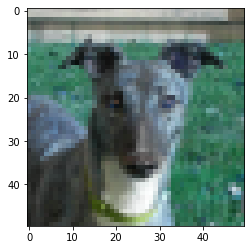

correct class is 1 but predict is 0


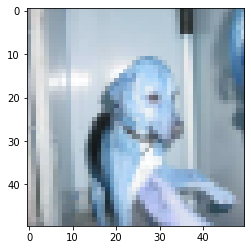

correct class is 1 but predict is 1


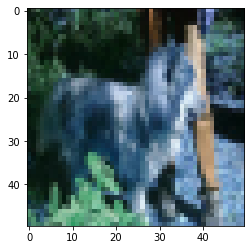

correct class is 1 but predict is 0


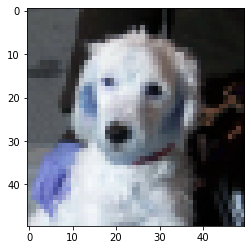

correct class is 1 but predict is 0


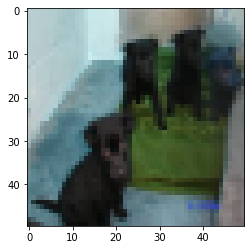

correct class is 1 but predict is 0


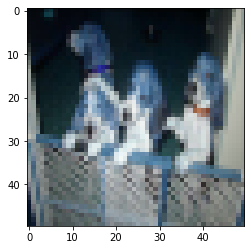

correct class is 1 but predict is 0


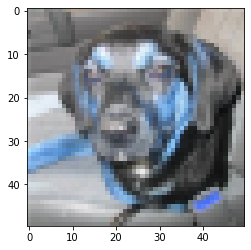

correct class is 1 but predict is 1


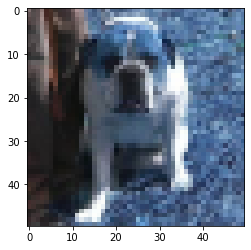

correct class is 1 but predict is 0


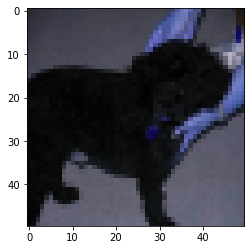

correct class is 1 but predict is 0


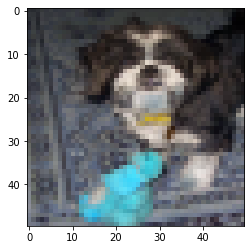

correct class is 1 but predict is 0


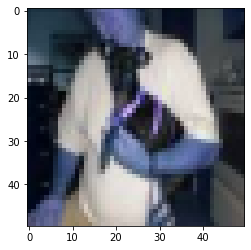

correct class is 1 but predict is 0


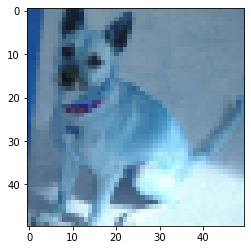

correct class is 1 but predict is 0


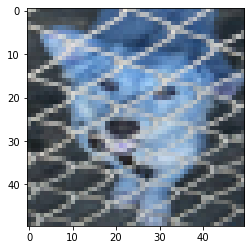

correct class is 1 but predict is 0


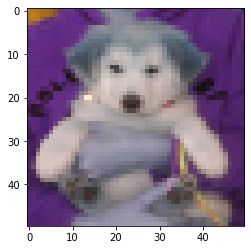

correct class is 1 but predict is 0


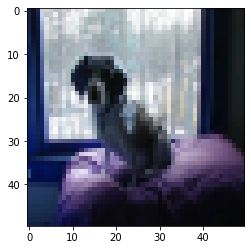

correct class is 1 but predict is 0


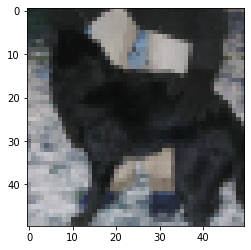

correct class is 1 but predict is 0


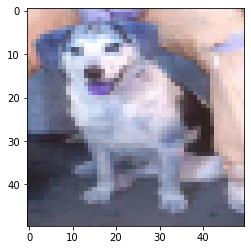

correct class is 1 but predict is 1


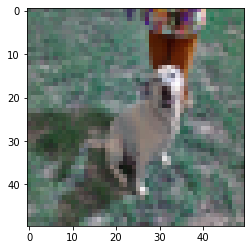

correct class is 1 but predict is 0


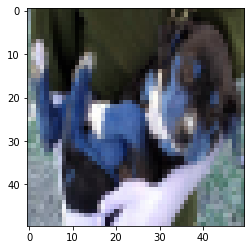

correct class is 1 but predict is 0


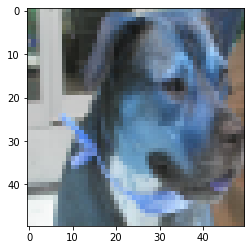

correct class is 1 but predict is 0


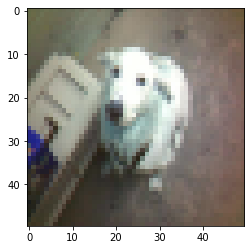

correct class is 1 but predict is 0


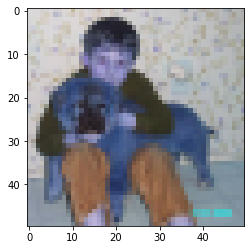

correct class is 1 but predict is 1


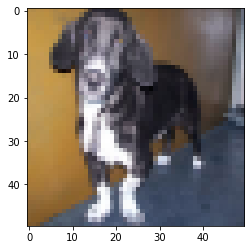

correct class is 1 but predict is 0


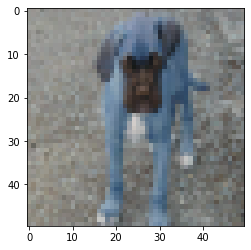

correct class is 1 but predict is 0


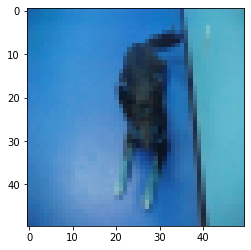

correct class is 1 but predict is 1


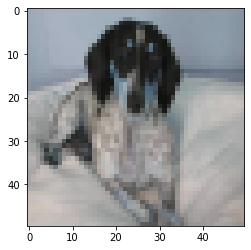

correct class is 1 but predict is 1


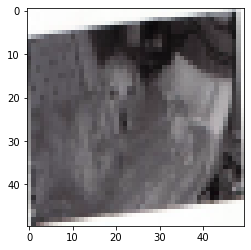

correct class is 1 but predict is 0


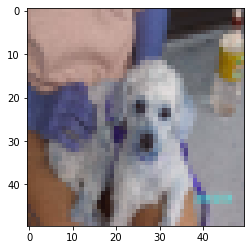

correct class is 1 but predict is 0


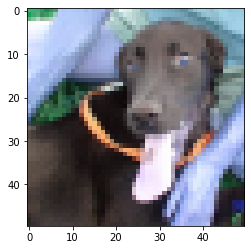

correct class is 1 but predict is 1


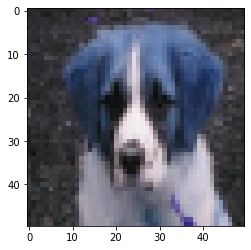

correct class is 1 but predict is 1


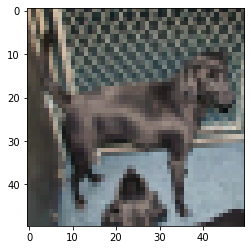

correct class is 1 but predict is 0


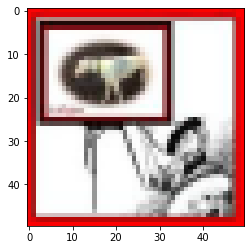

correct class is 1 but predict is 0


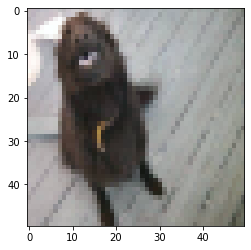

correct class is 1 but predict is 0


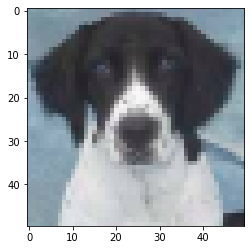

correct class is 1 but predict is 1


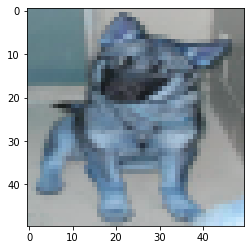

correct class is 1 but predict is 1


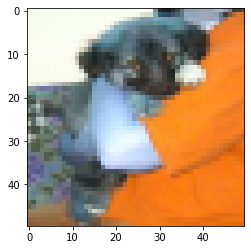

correct class is 1 but predict is 0


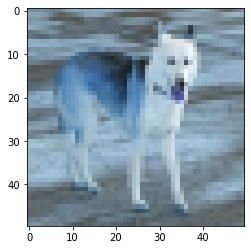

correct class is 1 but predict is 0


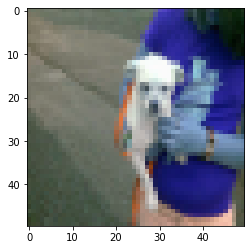

correct class is 1 but predict is 0


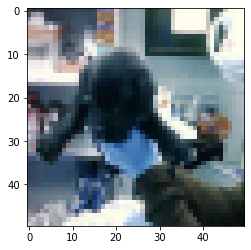

correct class is 1 but predict is 0


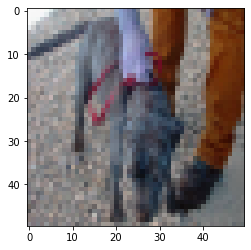

correct class is 1 but predict is 1


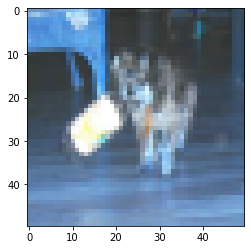

correct class is 1 but predict is 0


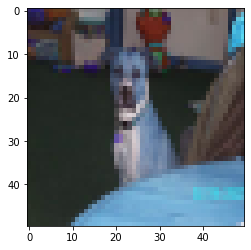

correct class is 1 but predict is 0


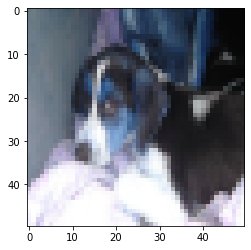

correct class is 1 but predict is 0


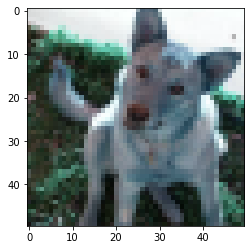

correct class is 1 but predict is 0


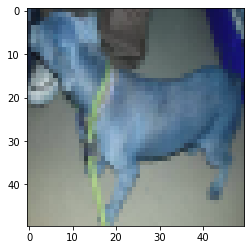

correct class is 1 but predict is 0


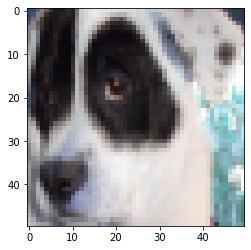

correct class is 1 but predict is 0


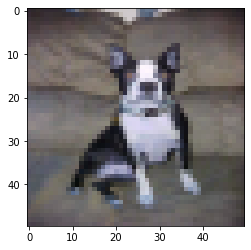

correct class is 1 but predict is 0


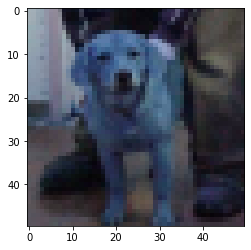

correct class is 1 but predict is 0


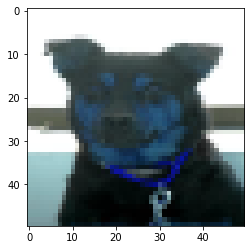

correct class is 1 but predict is 0


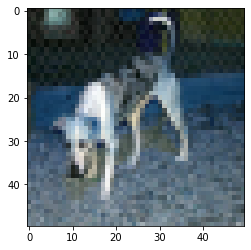

correct class is 1 but predict is 0


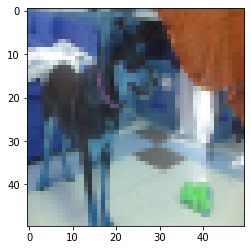

correct class is 1 but predict is 0


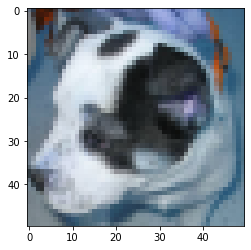

correct class is 1 but predict is 0


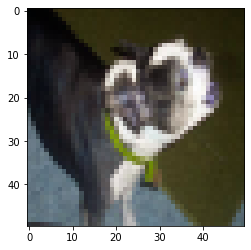

correct class is 1 but predict is 0


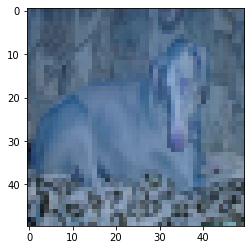

correct class is 1 but predict is 0


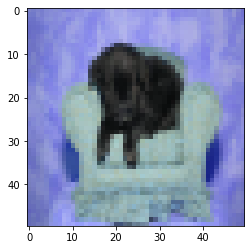

correct class is 1 but predict is 0


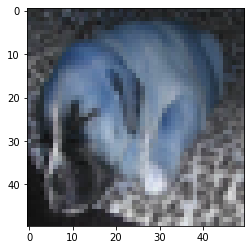

correct class is 1 but predict is 0


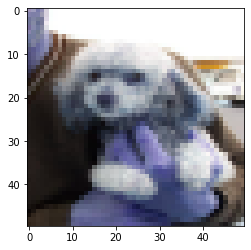

correct class is 1 but predict is 0


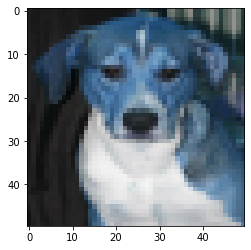

correct class is 1 but predict is 0


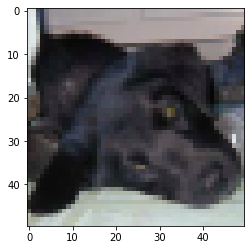

correct class is 1 but predict is 0


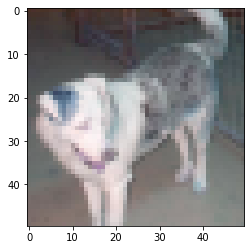

correct class is 1 but predict is 0


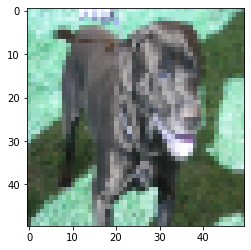

correct class is 1 but predict is 1


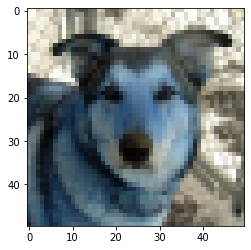

correct class is 1 but predict is 0


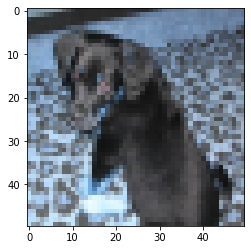

correct class is 1 but predict is 1


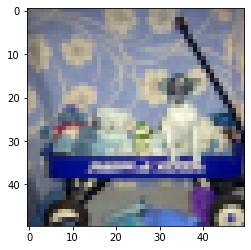

correct class is 1 but predict is 0


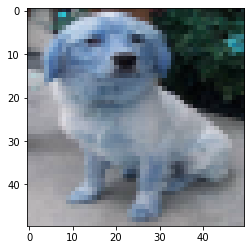

correct class is 1 but predict is 0


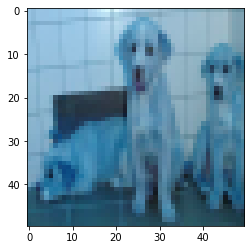

correct class is 1 but predict is 0


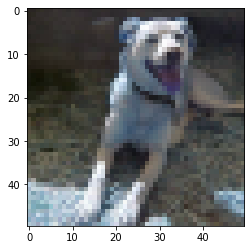

correct class is 1 but predict is 0


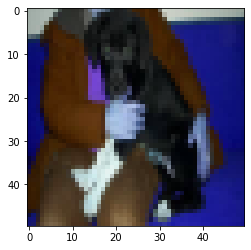

correct class is 1 but predict is 1


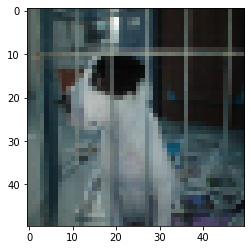

correct class is 1 but predict is 0


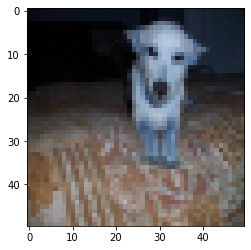

correct class is 1 but predict is 0


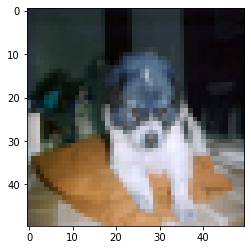

correct class is 1 but predict is 0


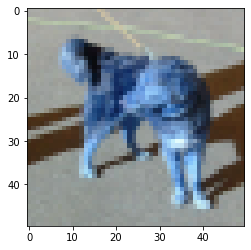

correct class is 1 but predict is 1


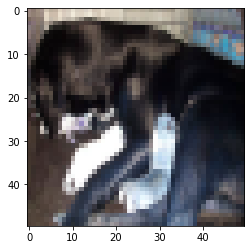

correct class is 1 but predict is 0


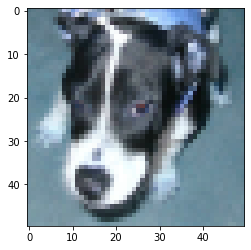

correct class is 1 but predict is 0


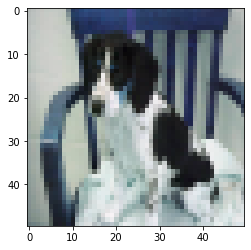

correct class is 1 but predict is 0


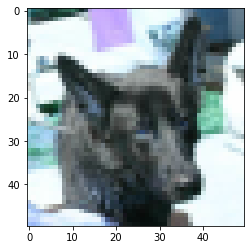

correct class is 1 but predict is 1


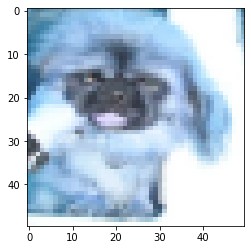

correct class is 1 but predict is 0


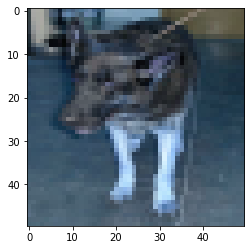

correct class is 1 but predict is 1


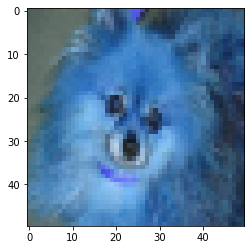

correct class is 1 but predict is 0


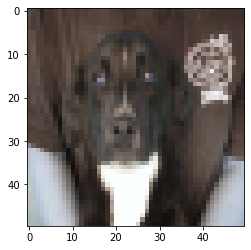

correct class is 1 but predict is 0


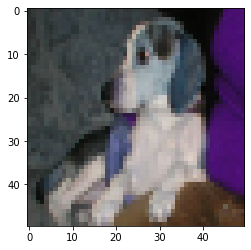

correct class is 1 but predict is 0


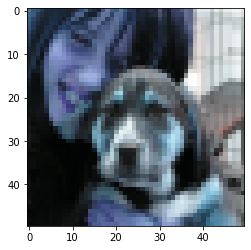

correct class is 1 but predict is 0


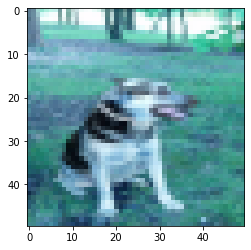

correct class is 1 but predict is 1


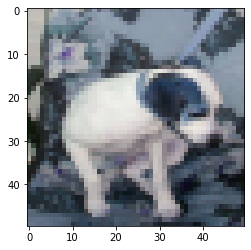

correct class is 1 but predict is 0


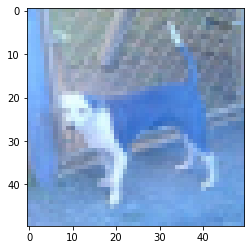

correct class is 1 but predict is 0


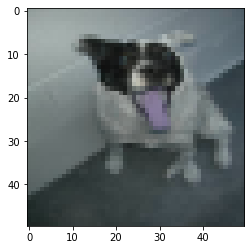

correct class is 1 but predict is 0


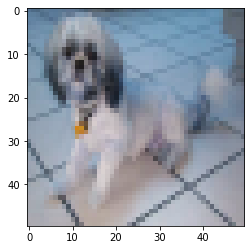

correct class is 1 but predict is 1


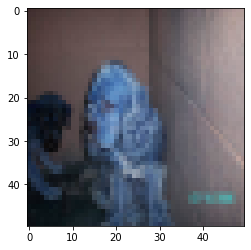

correct class is 1 but predict is 0


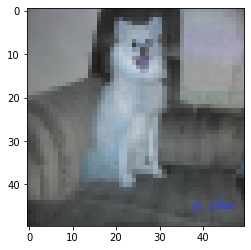

correct class is 1 but predict is 0


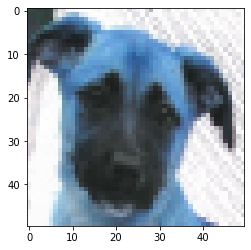

correct class is 1 but predict is 0


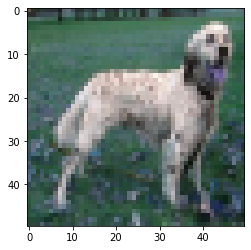

correct class is 1 but predict is 1


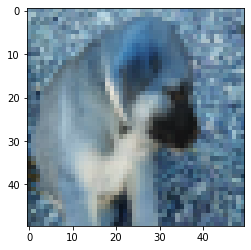

correct class is 1 but predict is 0


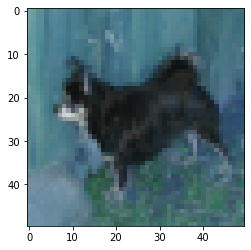

correct class is 1 but predict is 0


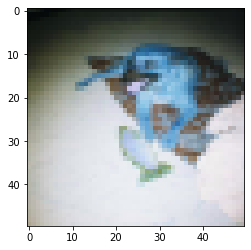

correct class is 1 but predict is 0


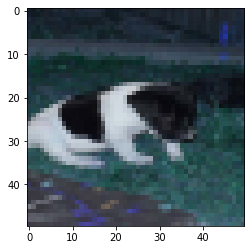

correct class is 1 but predict is 0


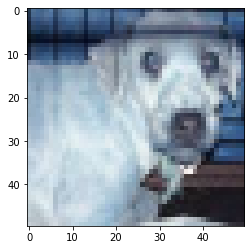

correct class is 1 but predict is 0


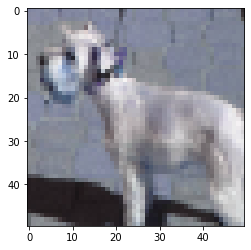

correct class is 1 but predict is 1


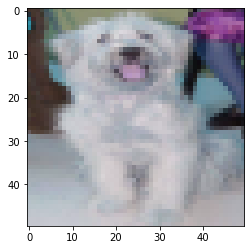

correct class is 1 but predict is 0


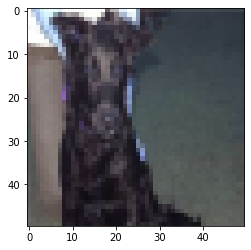

correct class is 1 but predict is 1


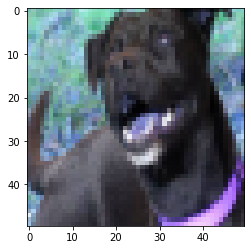

correct class is 1 but predict is 0


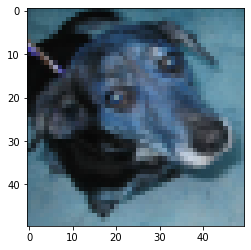

correct class is 1 but predict is 0


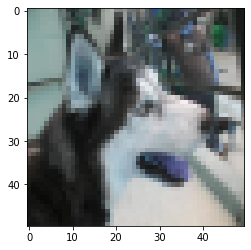

correct class is 1 but predict is 0


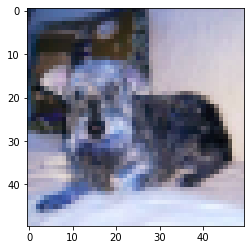

correct class is 1 but predict is 1


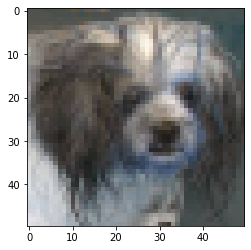

correct class is 1 but predict is 0


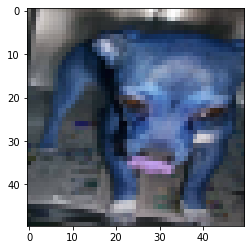

correct class is 1 but predict is 0


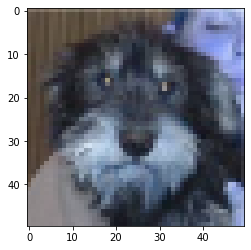

correct class is 1 but predict is 1


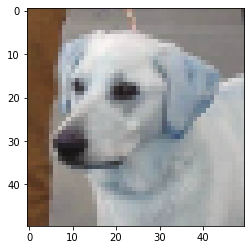

correct class is 1 but predict is 0


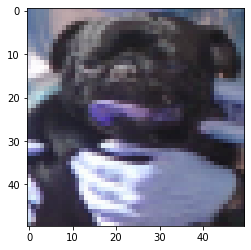

correct class is 1 but predict is 0


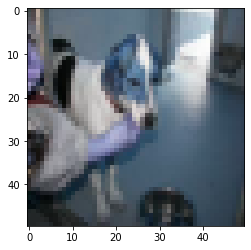

correct class is 1 but predict is 0


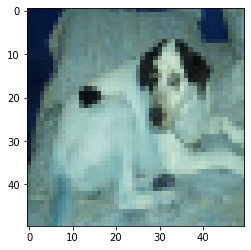

correct class is 1 but predict is 0


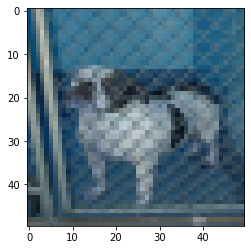

correct class is 1 but predict is 0


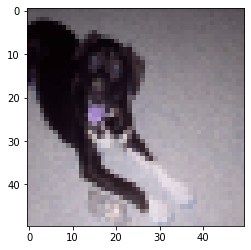

correct class is 1 but predict is 0


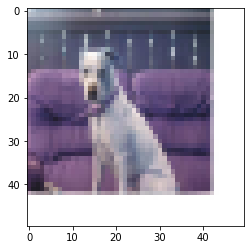

correct class is 1 but predict is 1


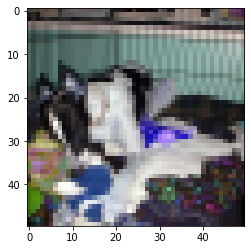

correct class is 1 but predict is 0


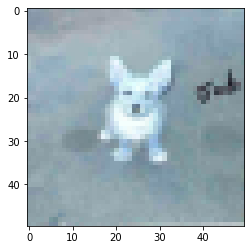

correct class is 1 but predict is 1


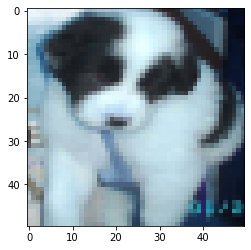

correct class is 1 but predict is 0


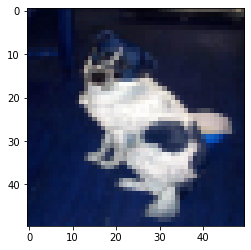

correct class is 1 but predict is 0


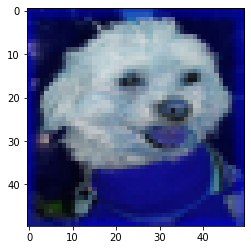

correct class is 1 but predict is 0


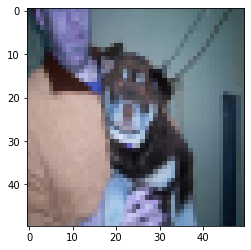

correct class is 1 but predict is 0


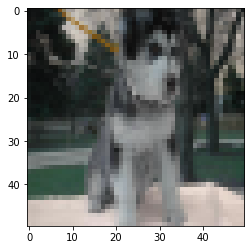

correct class is 1 but predict is 0


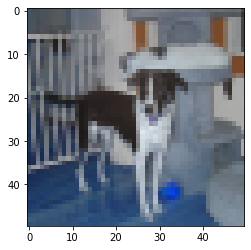

correct class is 1 but predict is 0


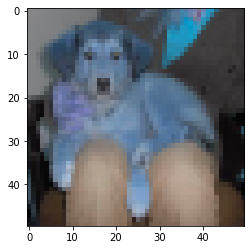

correct class is 1 but predict is 0


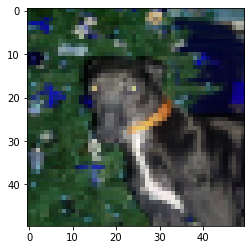

correct class is 1 but predict is 0


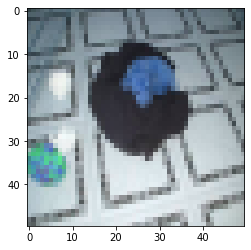

correct class is 1 but predict is 1


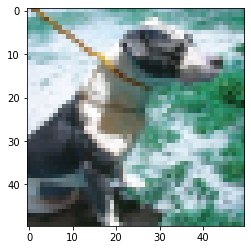

correct class is 1 but predict is 0


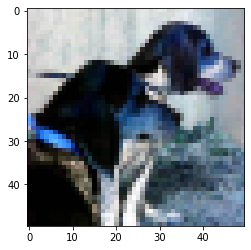

correct class is 1 but predict is 0


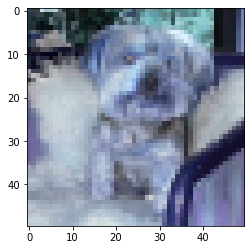

correct class is 1 but predict is 0


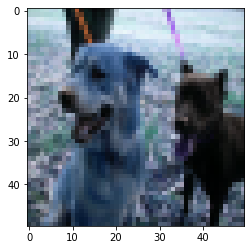

correct class is 1 but predict is 0


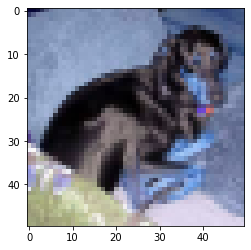

correct class is 1 but predict is 1


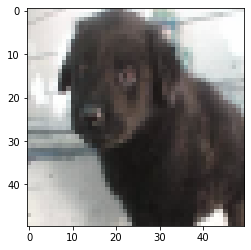

correct class is 1 but predict is 1


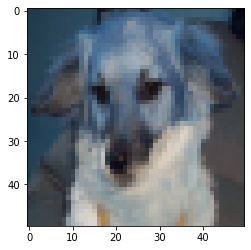

correct class is 1 but predict is 0


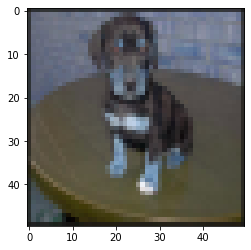

correct class is 1 but predict is 0


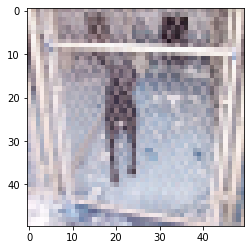

correct class is 1 but predict is 0


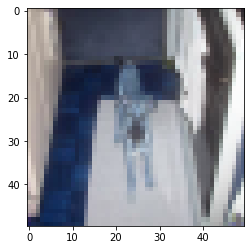

correct class is 1 but predict is 0


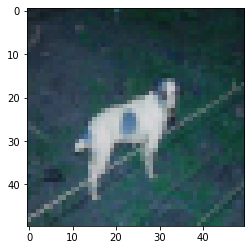

correct class is 1 but predict is 1


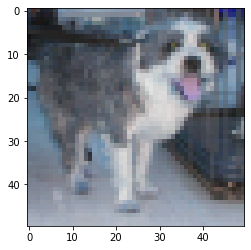

correct class is 1 but predict is 0


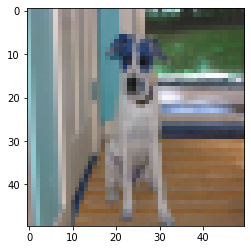

correct class is 1 but predict is 0


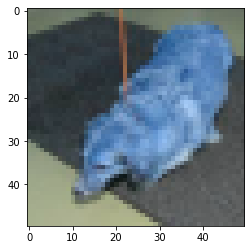

correct class is 1 but predict is 1


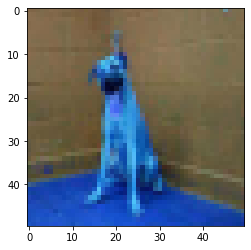

correct class is 1 but predict is 0


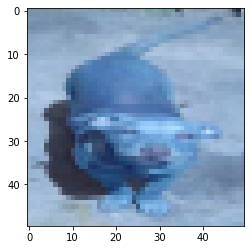

correct class is 1 but predict is 0


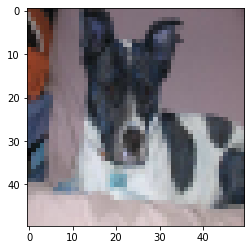

correct class is 1 but predict is 0


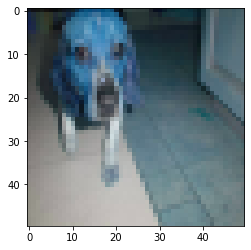

correct class is 1 but predict is 0


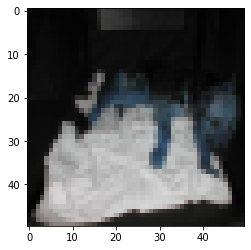

correct class is 1 but predict is 0


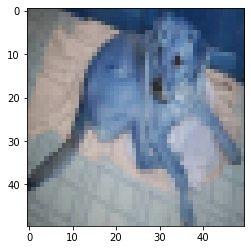

correct class is 1 but predict is 0


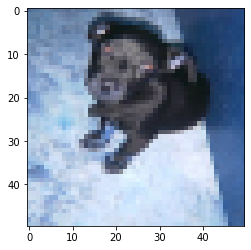

correct class is 1 but predict is 0


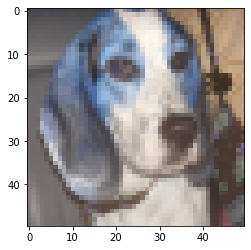

correct class is 1 but predict is 0


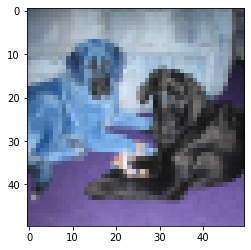

correct class is 1 but predict is 0


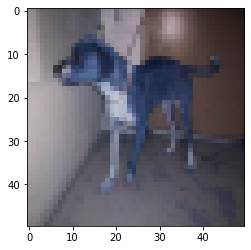

correct class is 1 but predict is 1


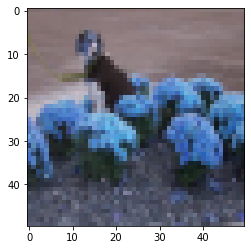

correct class is 1 but predict is 0


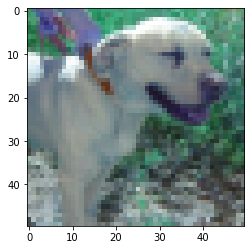

correct class is 1 but predict is 0


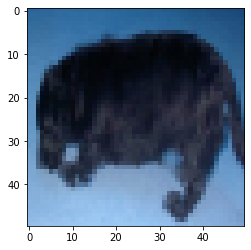

correct class is 1 but predict is 1


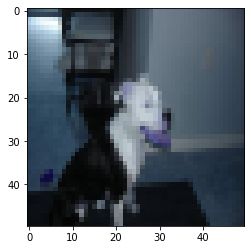

correct class is 1 but predict is 0


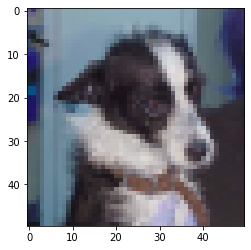

correct class is 1 but predict is 0


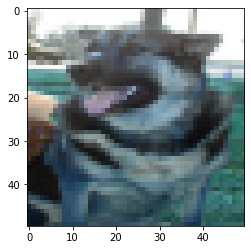

correct class is 1 but predict is 0


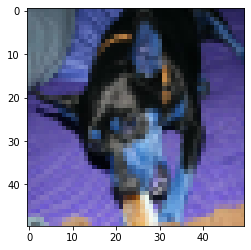

correct class is 1 but predict is 0


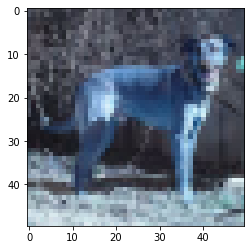

correct class is 1 but predict is 0


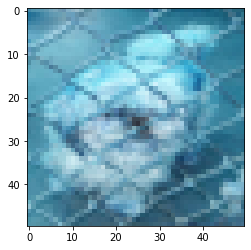

correct class is 1 but predict is 0


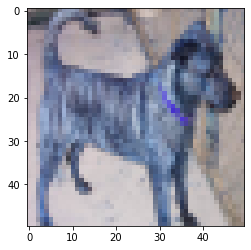

correct class is 1 but predict is 1


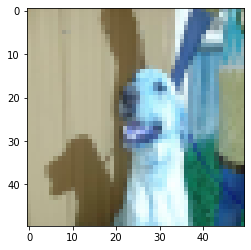

correct class is 1 but predict is 0


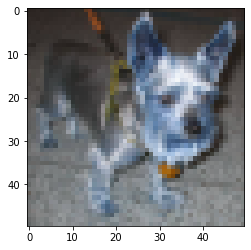

correct class is 1 but predict is 0


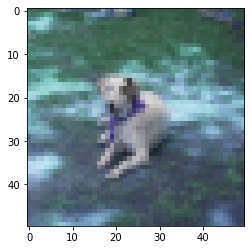

correct class is 1 but predict is 0


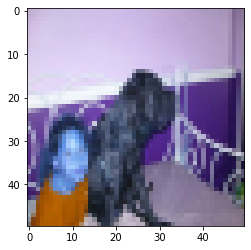

correct class is 1 but predict is 0


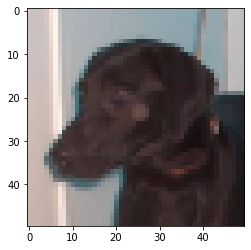

correct class is 1 but predict is 0


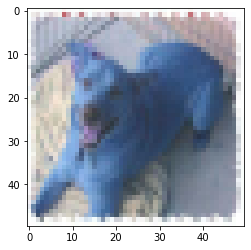

correct class is 1 but predict is 1


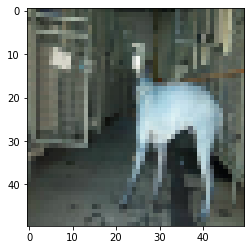

correct class is 1 but predict is 0


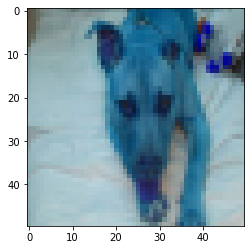

correct class is 1 but predict is 1


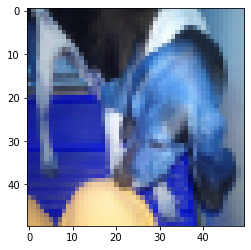

correct class is 1 but predict is 0


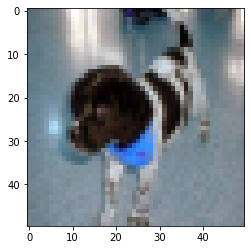

correct class is 1 but predict is 1


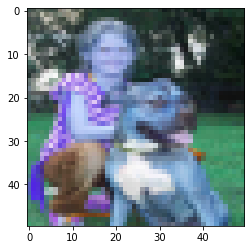

correct class is 1 but predict is 1


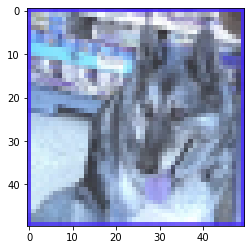

correct class is 1 but predict is 0


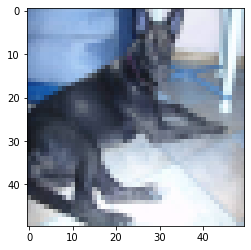

correct class is 1 but predict is 0


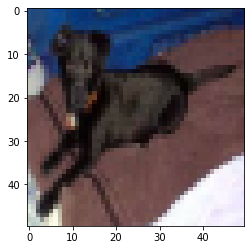

correct class is 1 but predict is 0


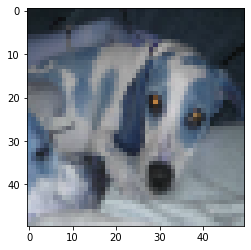

correct class is 1 but predict is 0


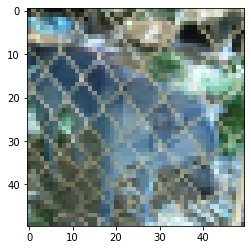

correct class is 1 but predict is 0


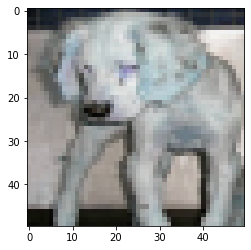

correct class is 1 but predict is 0


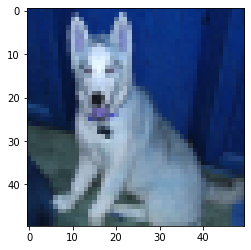

correct class is 1 but predict is 0


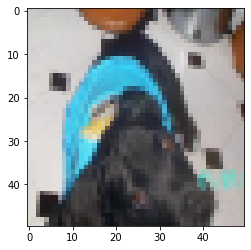

correct class is 1 but predict is 0


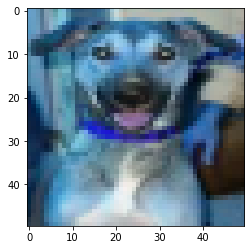

correct class is 1 but predict is 0


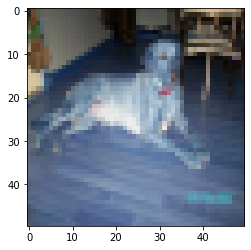

correct class is 1 but predict is 0


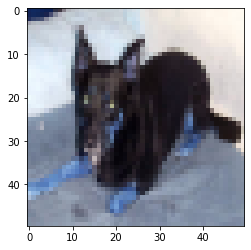

correct class is 1 but predict is 0


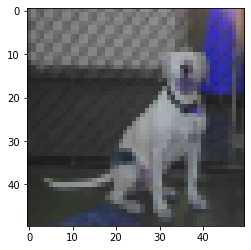

correct class is 1 but predict is 0


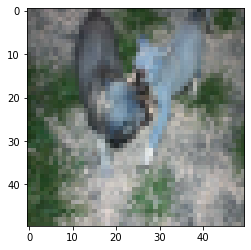

correct class is 1 but predict is 0


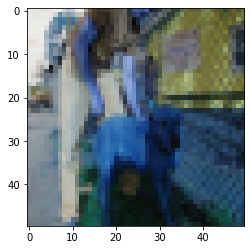

correct class is 1 but predict is 0


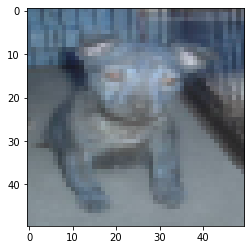

correct class is 1 but predict is 1


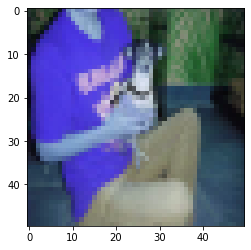

correct class is 1 but predict is 0


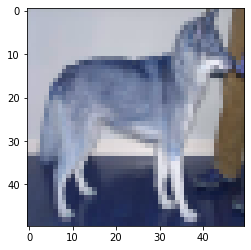

correct class is 1 but predict is 0


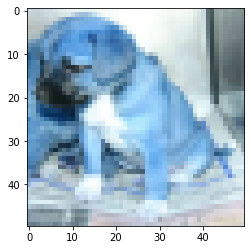

correct class is 1 but predict is 0


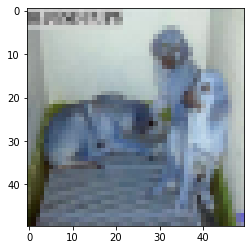

correct class is 1 but predict is 1


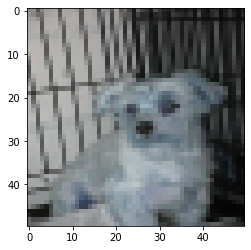

correct class is 1 but predict is 0


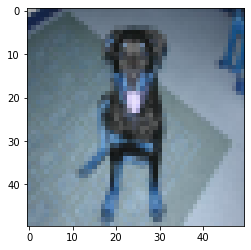

correct class is 1 but predict is 1


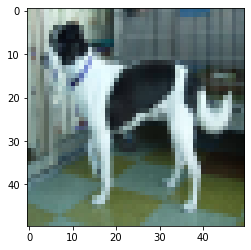

correct class is 1 but predict is 0


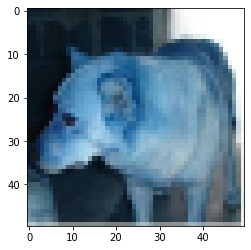

correct class is 1 but predict is 0


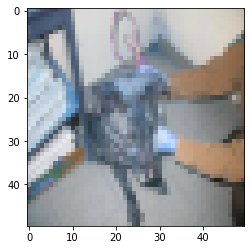

correct class is 1 but predict is 1


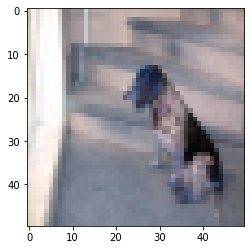

correct class is 1 but predict is 0


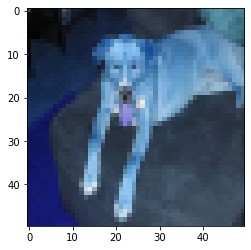

correct class is 1 but predict is 0


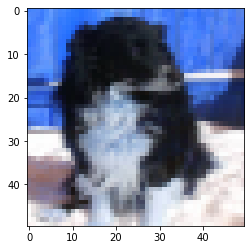

correct class is 1 but predict is 0


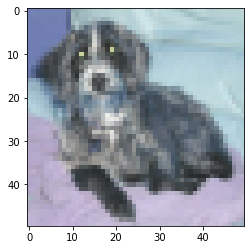

correct class is 1 but predict is 0


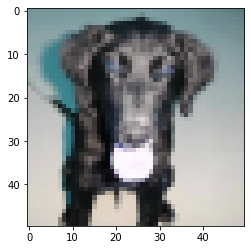

correct class is 1 but predict is 1


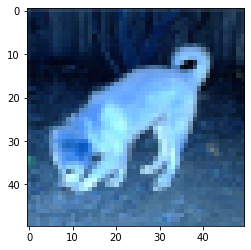

correct class is 1 but predict is 0


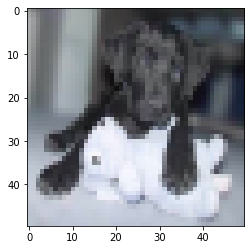

correct class is 1 but predict is 0


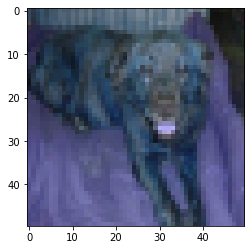

correct class is 1 but predict is 0


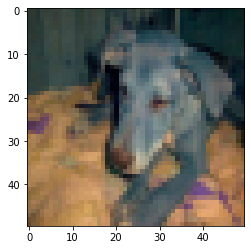

correct class is 1 but predict is 0


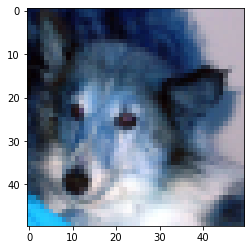

correct class is 1 but predict is 0


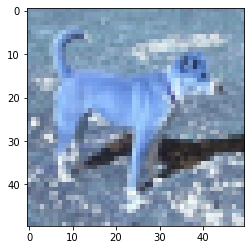

correct class is 1 but predict is 1


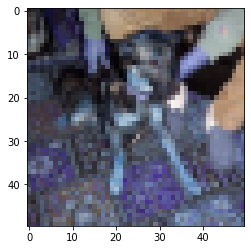

correct class is 1 but predict is 0


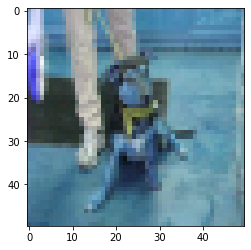

correct class is 1 but predict is 0


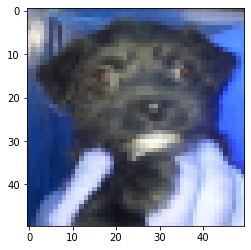

correct class is 1 but predict is 1


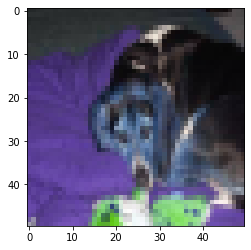

correct class is 1 but predict is 0


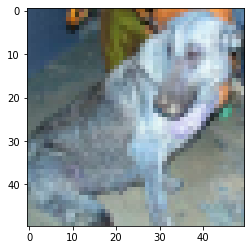

correct class is 1 but predict is 0


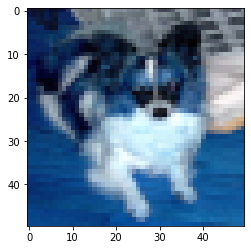

correct class is 1 but predict is 0


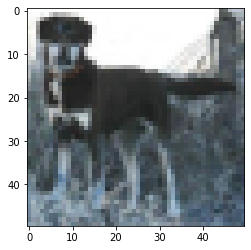

correct class is 1 but predict is 0


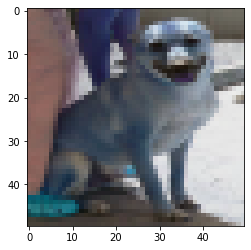

correct class is 1 but predict is 1


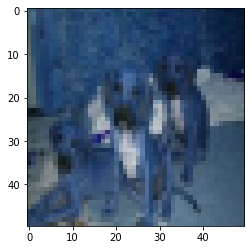

correct class is 1 but predict is 1


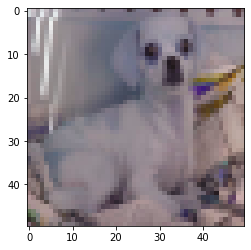

correct class is 1 but predict is 0


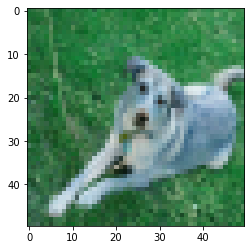

correct class is 1 but predict is 0


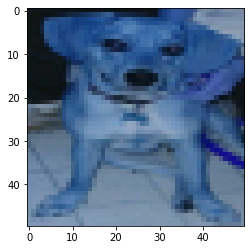

correct class is 1 but predict is 0


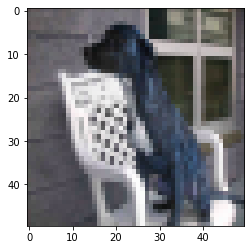

correct class is 1 but predict is 0


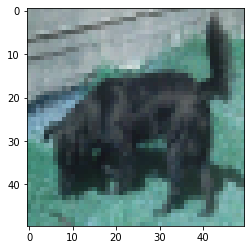

correct class is 1 but predict is 0


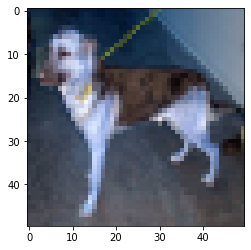

correct class is 1 but predict is 0


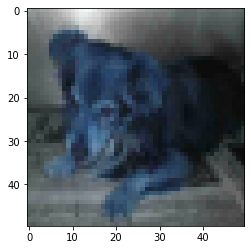

correct class is 1 but predict is 0


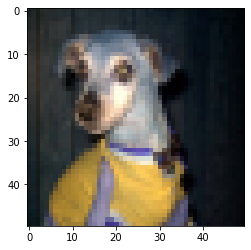

correct class is 1 but predict is 0


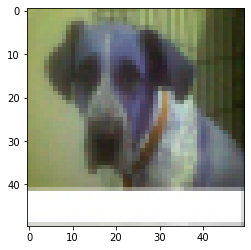

correct class is 1 but predict is 1


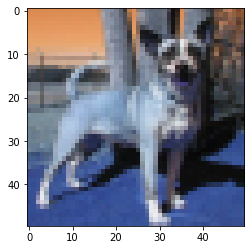

correct class is 1 but predict is 0


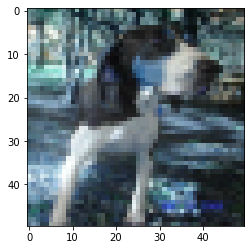

correct class is 1 but predict is 0


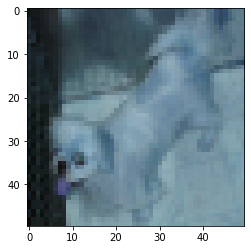

correct class is 1 but predict is 0


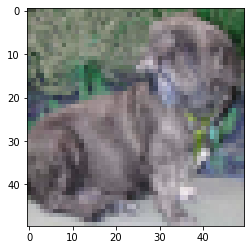

correct class is 1 but predict is 0


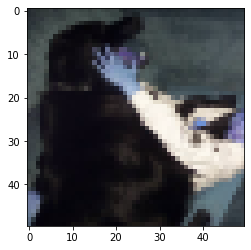

correct class is 1 but predict is 1


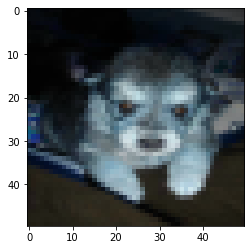

correct class is 1 but predict is 0


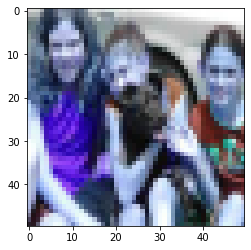

correct class is 1 but predict is 1


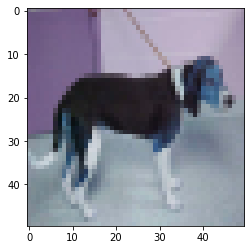

correct class is 1 but predict is 1


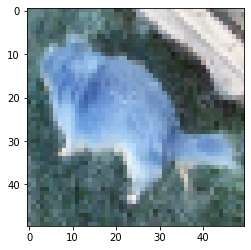

correct class is 1 but predict is 0


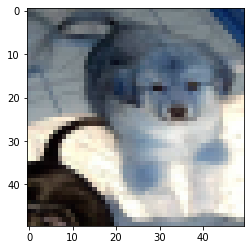

correct class is 1 but predict is 1


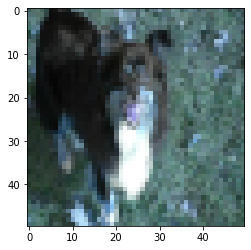

correct class is 1 but predict is 0


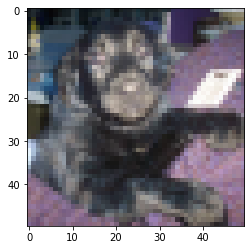

correct class is 1 but predict is 1


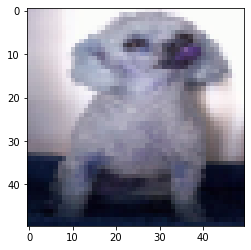

correct class is 1 but predict is 0


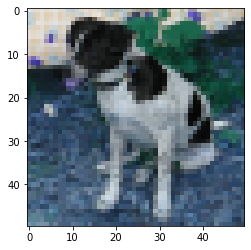

correct class is 1 but predict is 1


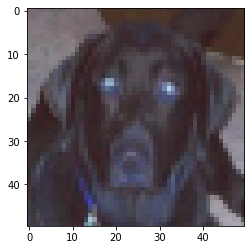

correct class is 1 but predict is 0


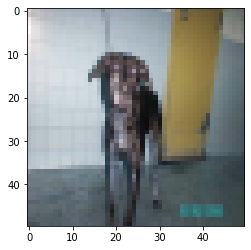

correct class is 1 but predict is 0


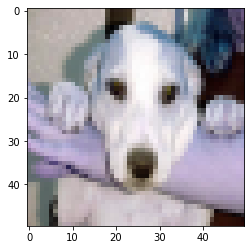

correct class is 1 but predict is 0


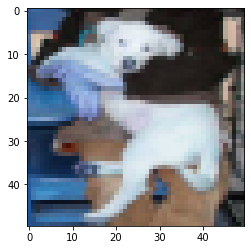

correct class is 1 but predict is 0


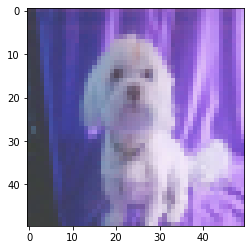

correct class is 1 but predict is 0


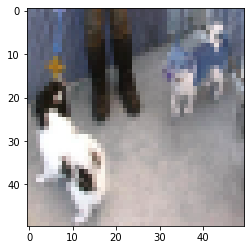

correct class is 1 but predict is 0


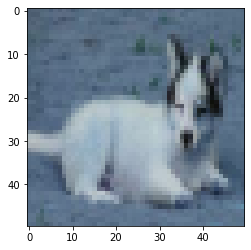

correct class is 1 but predict is 0


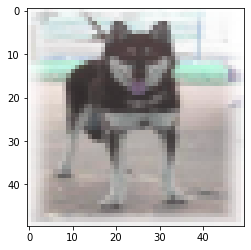

correct class is 1 but predict is 1


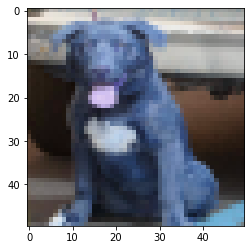

correct class is 1 but predict is 0


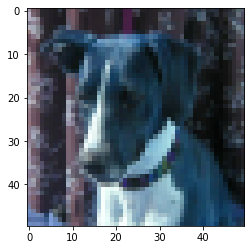

correct class is 1 but predict is 0


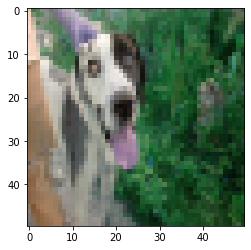

correct class is 1 but predict is 0


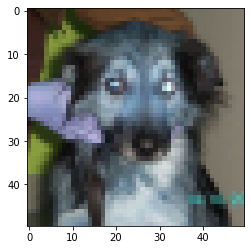

correct class is 1 but predict is 1


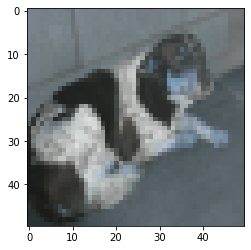

correct class is 1 but predict is 0


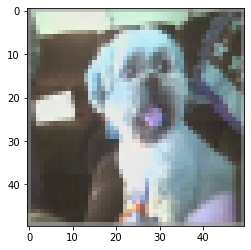

correct class is 1 but predict is 0


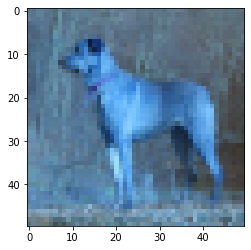

correct class is 1 but predict is 0


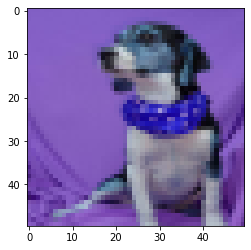

correct class is 1 but predict is 1


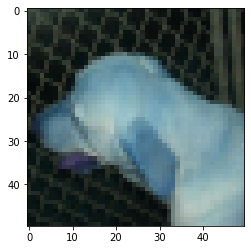

correct class is 1 but predict is 0


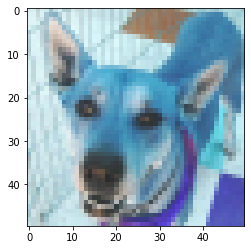

correct class is 1 but predict is 1


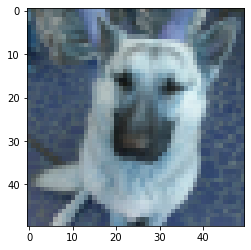

correct class is 1 but predict is 0


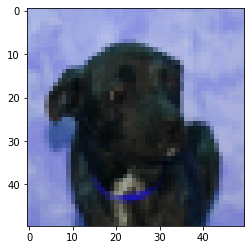

correct class is 1 but predict is 0


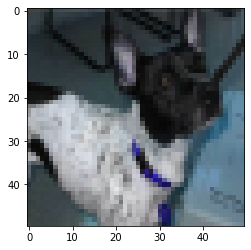

correct class is 1 but predict is 0


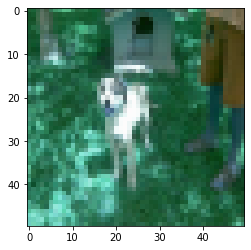

correct class is 1 but predict is 0


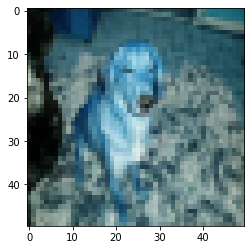

correct class is 1 but predict is 1


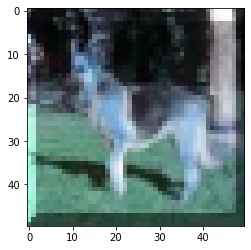

correct class is 1 but predict is 1


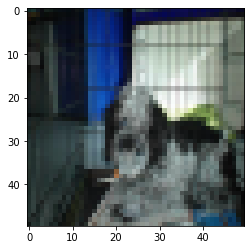

correct class is 1 but predict is 0


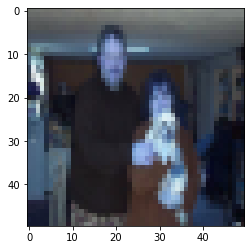

correct class is 1 but predict is 1


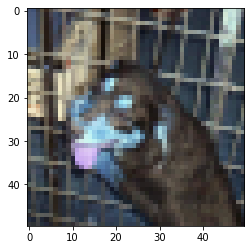

correct class is 1 but predict is 0


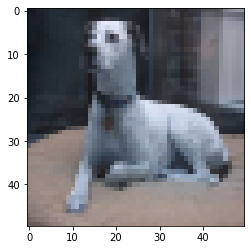

correct class is 1 but predict is 0


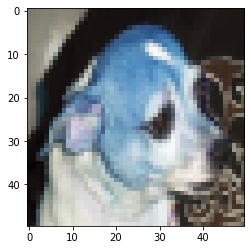

correct class is 1 but predict is 0


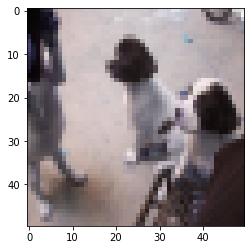

correct class is 1 but predict is 1


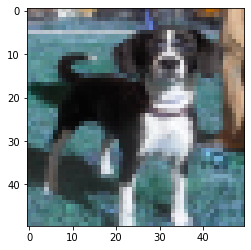

correct class is 1 but predict is 0


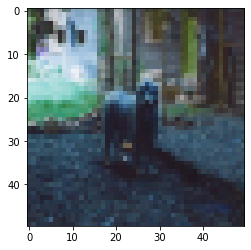

correct class is 1 but predict is 0


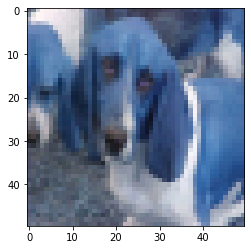

correct class is 1 but predict is 1


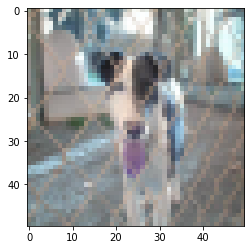

correct class is 1 but predict is 0


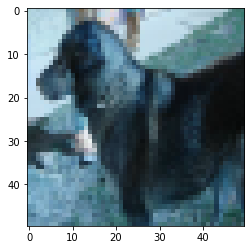

correct class is 1 but predict is 0


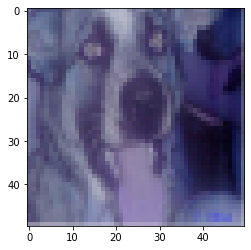

correct class is 1 but predict is 1


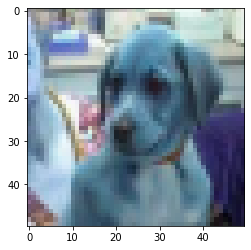

correct class is 1 but predict is 1


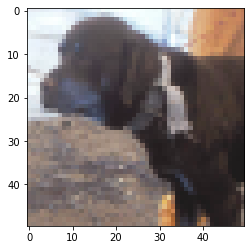

correct class is 1 but predict is 0


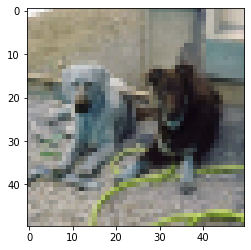

correct class is 1 but predict is 1


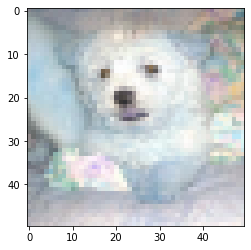

correct class is 1 but predict is 0


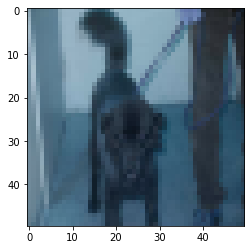

correct class is 1 but predict is 0


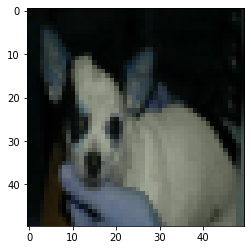

correct class is 1 but predict is 0


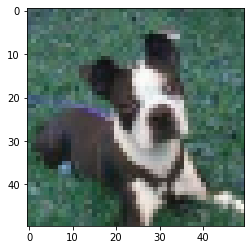

correct class is 1 but predict is 0


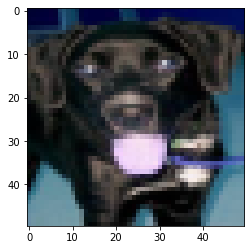

correct class is 1 but predict is 0


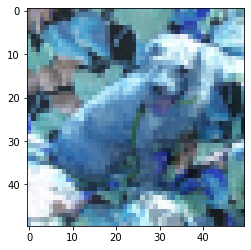

correct class is 1 but predict is 0


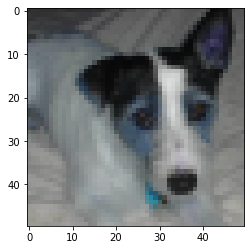

correct class is 1 but predict is 0


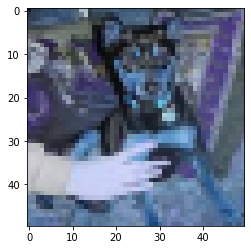

correct class is 1 but predict is 0


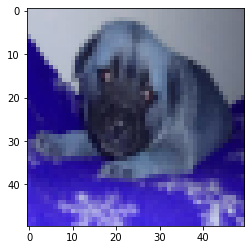

correct class is 1 but predict is 0


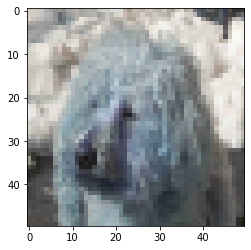

correct class is 1 but predict is 0


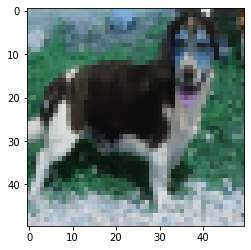

correct class is 1 but predict is 0


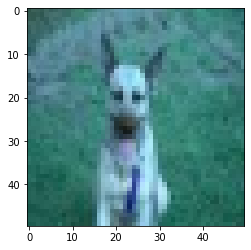

correct class is 1 but predict is 0


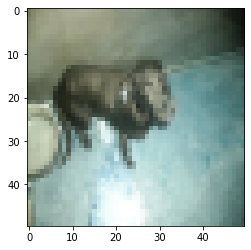

correct class is 1 but predict is 0


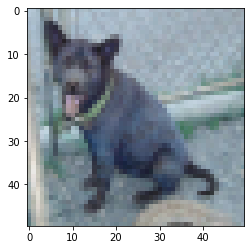

correct class is 1 but predict is 0


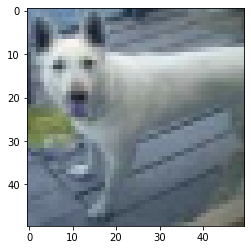

correct class is 1 but predict is 0


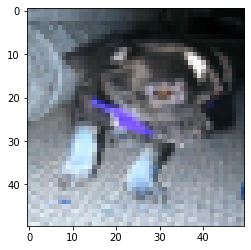

correct class is 1 but predict is 0


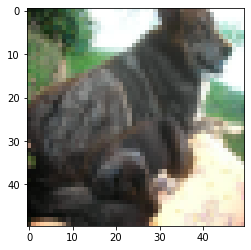

correct class is 1 but predict is 1


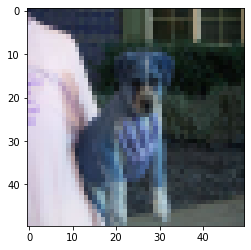

correct class is 1 but predict is 1


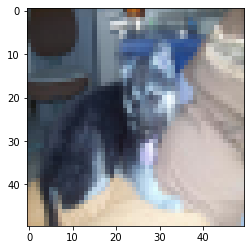

correct class is 1 but predict is 0


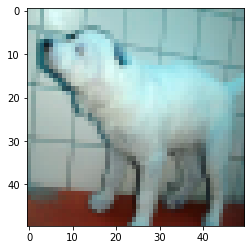

correct class is 1 but predict is 0


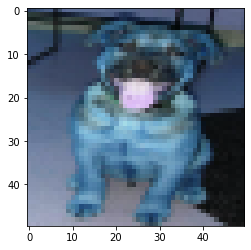

correct class is 1 but predict is 0


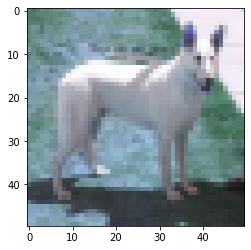

correct class is 1 but predict is 0


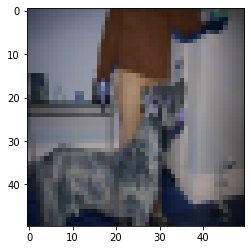

correct class is 1 but predict is 0


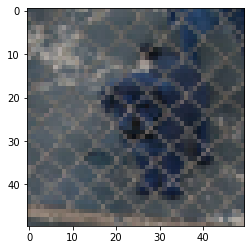

correct class is 1 but predict is 0


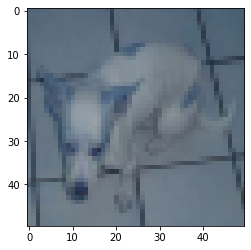

correct class is 1 but predict is 1


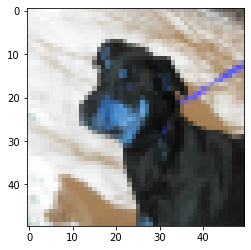

correct class is 1 but predict is 0
number of images with this property : 941


In [146]:
count=0
for i in range(len(Y)):
    if(logs[i][Y[i]]<0.5):
        count+=1
        plt.figure(i)
        plt.imshow(X_test[i], interpolation='none', cmap='gray')
        plt.show()
        print(f"correct class is {Y[i]} but predict is {(max_idxs[i])}")
print(f"number of images with this property : {count}")

تست ۵ لایه :

دراین قسمت یک شبکه ی پیچیده تر با پنج لایه نرون طراحی و آموزش داده شده 

In [147]:
def nn_5_layer(x_input, W1, b1, W2, b2, W3, b3,W4,b4,W5,b5):
    # flatten the input image from 28 x 28 to 784
    x_input = tf.reshape(x_input, (x_input.shape[0], -1))
    x = tf.add(tf.matmul(tf.cast(x_input, tf.float32), W1), b1)
    x = tf.nn.relu(x)
    x2 =tf.add(tf.matmul(x, W2), b2)
    x2 = tf.nn.relu(x2)
    x3 =tf.add(tf.matmul(x2, W3), b3)
    x3 = tf.nn.relu(x3)
    x4 =tf.add(tf.matmul(x3, W4), b4)
    x4 = tf.nn.relu(x4)
    logits = tf.add(tf.matmul(x4, W5), b5)
    return logits

In [152]:
# now declare the weights connecting the input to the hidden layer1
W1 = tf.Variable(tf.random.normal([7500, 1000], stddev=0.03), name='W1')
b1 = tf.Variable(tf.random.normal([1000]), name='b1')
# and the weights connecting the hidden layer1 to the hidden layer2
W2 = tf.Variable(tf.random.normal([1000, 1000], stddev=0.03), name='W2')
b2 = tf.Variable(tf.random.normal([1000]), name='b2')
# and the weights connecting the hidden layer2 to the hidden layer3
W3 = tf.Variable(tf.random.normal([1000, 1000], stddev=0.03), name='W3')
b3 = tf.Variable(tf.random.normal([1000]), name='b3')
# and the weights connecting the hidden layer2 to the hidden layer3
W4 = tf.Variable(tf.random.normal([1000, 1000], stddev=0.03), name='W4')
b4 = tf.Variable(tf.random.normal([1000]), name='b4')
# and the weights connecting the hidden layer3 to the output layer
W5 = tf.Variable(tf.random.normal([1000, 2], stddev=0.03), name='W5')
b5 = tf.Variable(tf.random.normal([2]), name='b5')

In [153]:
epoch_num=[]
test_errors=[]
train_errors=[]
batch_size = 100
train_errors4=[]

total_batch = int(len(Y_train) / batch_size)
epoch_num.clear()
epochs=15
for epoch in range(epochs):
    total_loss = 0
    for i in range(total_batch):
        batch_x, batch_y = get_batch(X_train, Y_train, batch_size=batch_size)
        # create tensors
        batch_x = tf.Variable(batch_x)
        batch_y = tf.Variable(batch_y)
        with tf.GradientTape() as tape:
            logits = nn_5_layer(batch_x, W1, b1, W2, b2, W3, b3,W4,b4,W5,b5)
            loss = loss_fn(logits, batch_y)
        gradients = tape.gradient(loss, [W1, b1, W2, b2, W3, b3,W4,b4,W5,b5])
        optimizer.apply_gradients(zip(gradients, [W1, b1, W2, b2, W3, b3,W4,b4,W5,b5]))
        total_loss += loss / total_batch
        
    epoch_num.append(epoch)
    train_errors4.append(total_loss)
    
    print(f"Epoch: {epoch + 1}, loss={total_loss:.3f}")
    
print("\nTraining complete!")


Epoch: 1, loss=2.937
Epoch: 2, loss=0.681
Epoch: 3, loss=0.671
Epoch: 4, loss=0.659
Epoch: 5, loss=0.653
Epoch: 6, loss=0.645
Epoch: 7, loss=0.639
Epoch: 8, loss=0.634
Epoch: 9, loss=0.635
Epoch: 10, loss=0.626
Epoch: 11, loss=0.618
Epoch: 12, loss=0.623
Epoch: 13, loss=0.611
Epoch: 14, loss=0.602
Epoch: 15, loss=0.612

Training complete!


In [154]:
logs = nn_5_layer(X_test, W1, b1, W2, b2, W3, b3,W4,b4,W5,b5)
max_idxs = (tf.argmax(logs, axis=1))
Y=tf.argmax(Y_test, axis=1)
print(f"F1_score: {f1_score(Y, max_idxs, average='macro')}")
print(f"Precision: {precision_score(Y, max_idxs, average='macro')}")
print(f"Recall: {recall_score(Y, max_idxs, average='macro')}")
print(f"Accuracy: {accuracy_score(Y, max_idxs)}")

F1_score: 0.6399201789536362
Precision: 0.6453583595387841
Recall: 0.6419999999999999
Accuracy: 0.642


نکته ی قابل توجه که اینجا پیش می آید این است که عملکرد این شبکه نسبت به شبکه ی ساده تر قبلی بهتر نبود و دلیل آن احتمالا این است که شبکه اورفیت شده است، پس مشکل به طور کلی از ساده بودن شبکه نبوده است، طی تحقیقات و بررسی ها در مورد این ست داده ها به این نتیجه رسیدیم که برای چالشی تر شدن آموزش، این داده ها اصولا با مقداری داده ی غلط همراه هستند یعنی لیبل بعضی از عکس ها میتواند ازابتدا اشتباه باشد و این موجب بخشی از خطای نهایی شده باشد. راه حل ممکن برای این موضوع یک پیش پردازش روی داده های آموزشی برای اصلاح داده های غلط است. هم چنین احتمال دیگری که وجود دارد این است که عدم یکنواخت بودن داده ها موجب کاهش عملکرد خوب شبکه میشود یعنی مثلا اندازه ی کلاس های متفاوت برابر نیست که برطرف کردن این مشکل لازم به راهکار های پیچیده تری دارد مانند تولید داده از روی داده های موجود برای یکنواخت کردن داده ها و یا تنطیم ضریب برای خطای هر دسته وابسته به اندازه ی آن دسته.

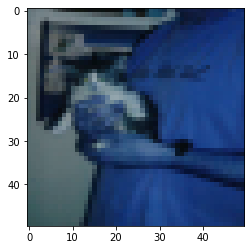

correct class is 0 but predict is 1


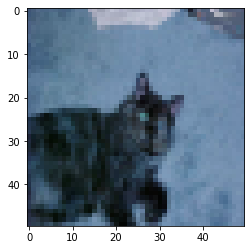

correct class is 0 but predict is 1


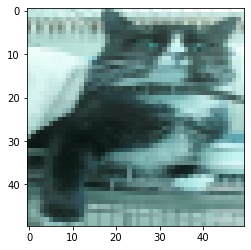

correct class is 0 but predict is 1


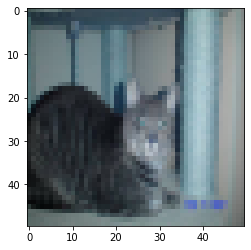

correct class is 0 but predict is 1


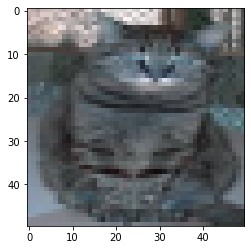

correct class is 0 but predict is 1


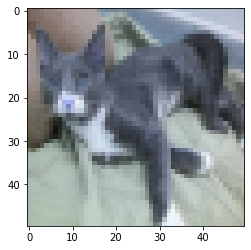

correct class is 0 but predict is 1


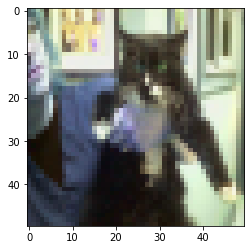

correct class is 0 but predict is 1


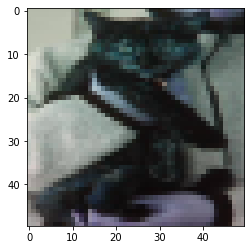

correct class is 0 but predict is 1


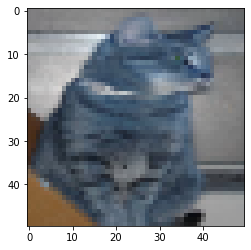

correct class is 0 but predict is 1


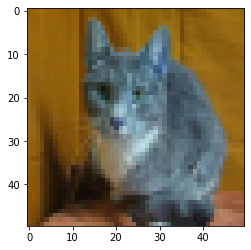

correct class is 0 but predict is 1


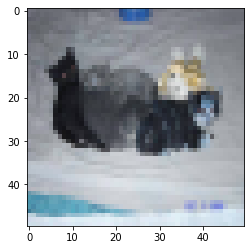

correct class is 0 but predict is 1


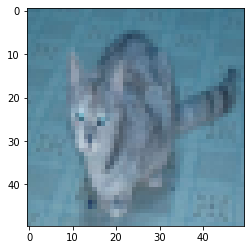

correct class is 0 but predict is 1


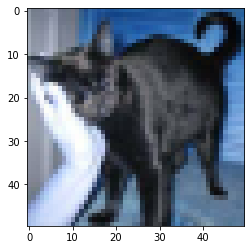

correct class is 0 but predict is 1


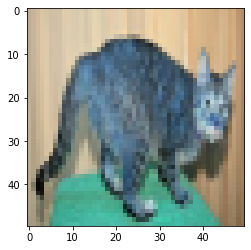

correct class is 0 but predict is 1


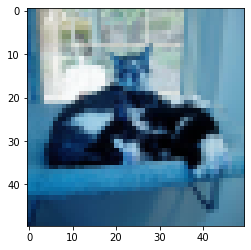

correct class is 0 but predict is 1


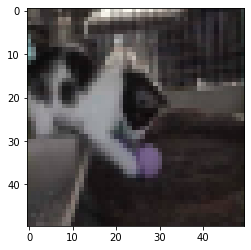

correct class is 0 but predict is 1


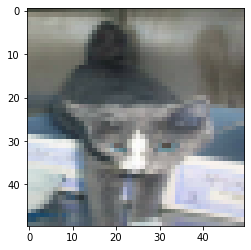

correct class is 0 but predict is 1


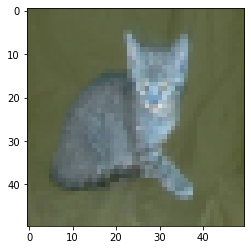

correct class is 0 but predict is 1


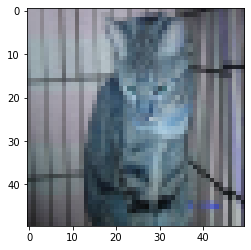

correct class is 0 but predict is 1


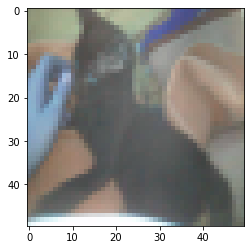

correct class is 0 but predict is 1


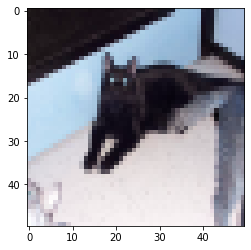

correct class is 0 but predict is 1


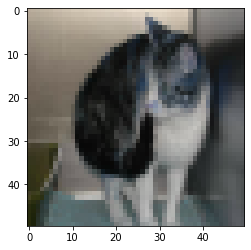

correct class is 0 but predict is 1


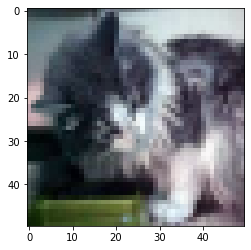

correct class is 0 but predict is 1


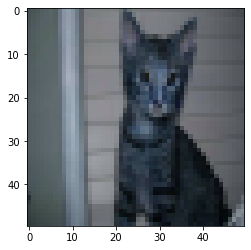

correct class is 0 but predict is 1


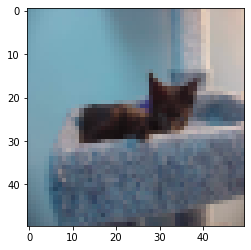

correct class is 0 but predict is 1


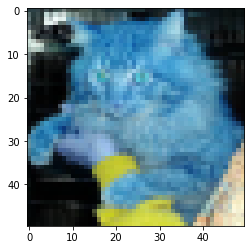

correct class is 0 but predict is 1


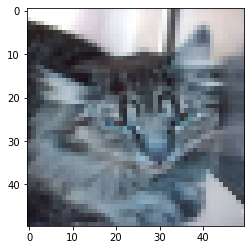

correct class is 0 but predict is 1


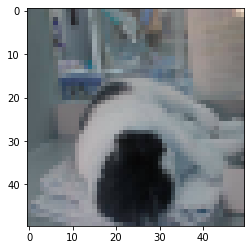

correct class is 0 but predict is 1


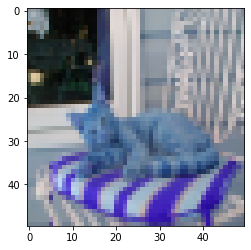

correct class is 0 but predict is 1


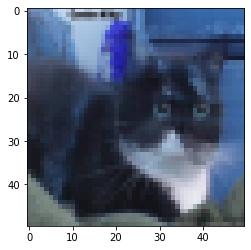

correct class is 0 but predict is 1


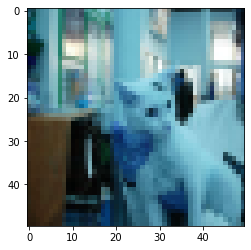

correct class is 0 but predict is 1


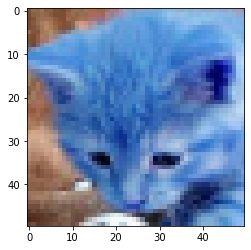

correct class is 0 but predict is 1


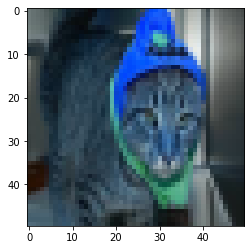

correct class is 0 but predict is 1


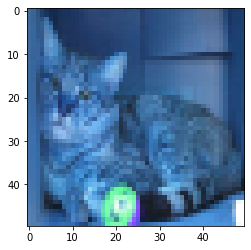

correct class is 0 but predict is 1


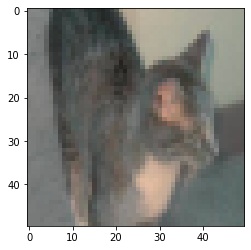

correct class is 0 but predict is 1


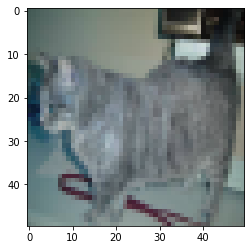

correct class is 0 but predict is 1


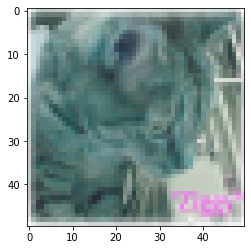

correct class is 0 but predict is 1


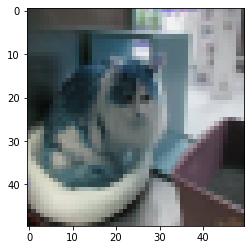

correct class is 0 but predict is 1


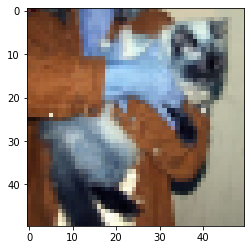

correct class is 0 but predict is 1


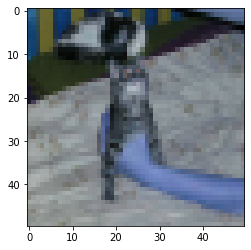

correct class is 0 but predict is 1


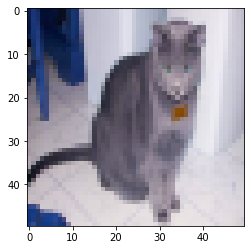

correct class is 0 but predict is 1


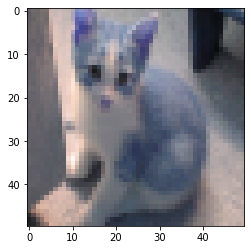

correct class is 0 but predict is 1


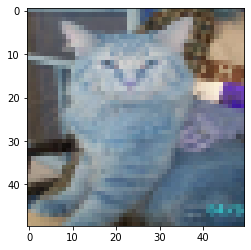

correct class is 0 but predict is 1


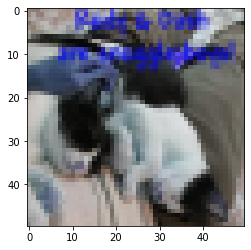

correct class is 0 but predict is 1


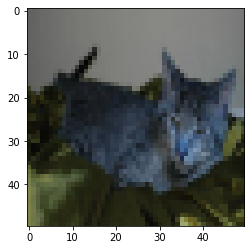

correct class is 0 but predict is 1


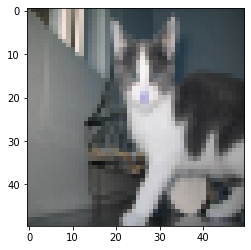

correct class is 0 but predict is 1


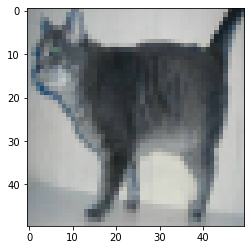

correct class is 0 but predict is 1


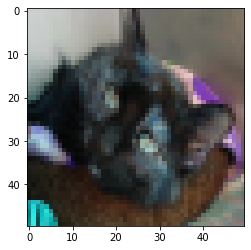

correct class is 0 but predict is 1


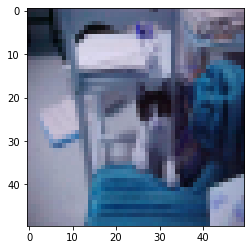

correct class is 0 but predict is 1


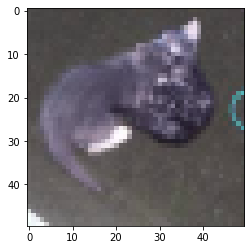

correct class is 0 but predict is 1


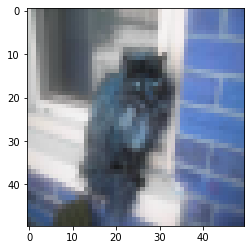

correct class is 0 but predict is 1


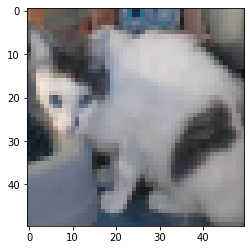

correct class is 0 but predict is 1


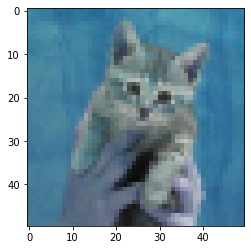

correct class is 0 but predict is 1


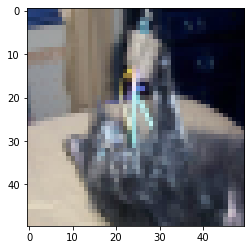

correct class is 0 but predict is 1


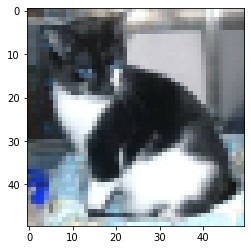

correct class is 0 but predict is 1


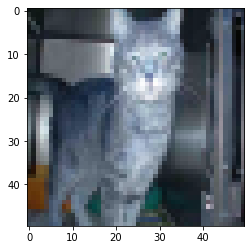

correct class is 0 but predict is 1


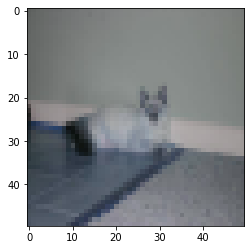

correct class is 0 but predict is 1


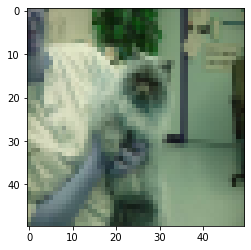

correct class is 0 but predict is 1


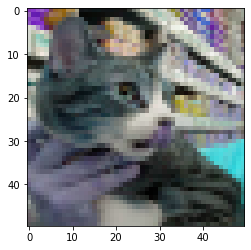

correct class is 0 but predict is 1


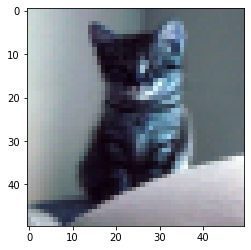

correct class is 0 but predict is 1


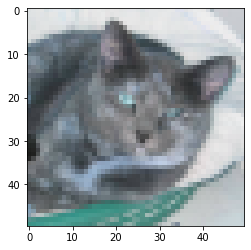

correct class is 0 but predict is 1


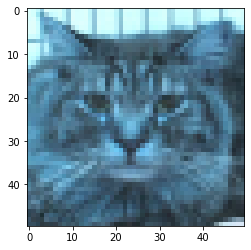

correct class is 0 but predict is 1


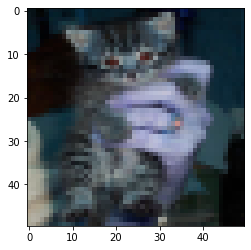

correct class is 0 but predict is 1


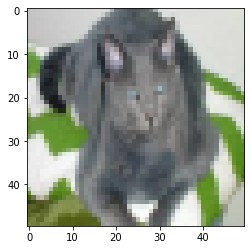

correct class is 0 but predict is 1


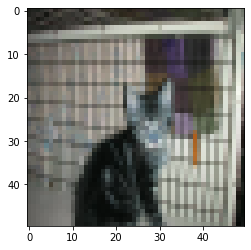

correct class is 0 but predict is 1


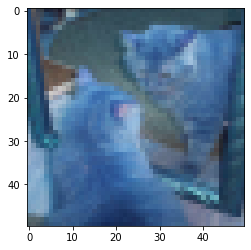

correct class is 0 but predict is 1


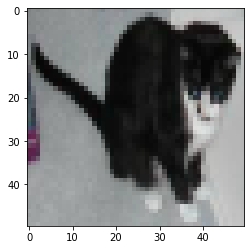

correct class is 0 but predict is 1


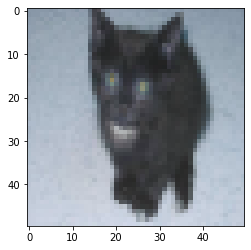

correct class is 0 but predict is 1


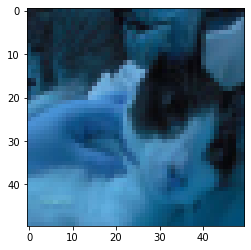

correct class is 0 but predict is 1


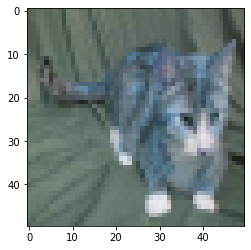

correct class is 0 but predict is 1


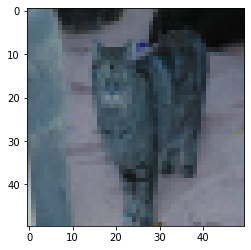

correct class is 0 but predict is 1


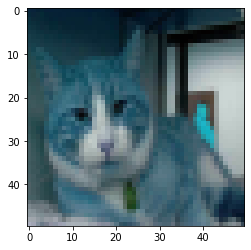

correct class is 0 but predict is 1


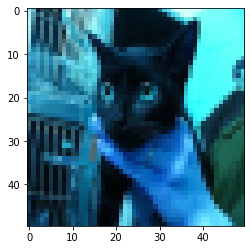

correct class is 0 but predict is 1


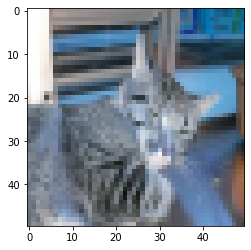

correct class is 0 but predict is 1


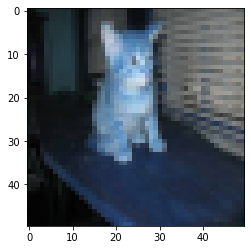

correct class is 0 but predict is 1


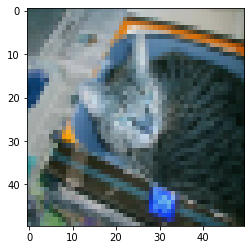

correct class is 0 but predict is 1


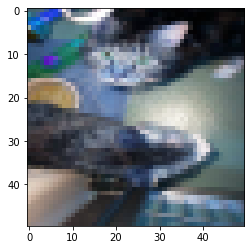

correct class is 0 but predict is 1


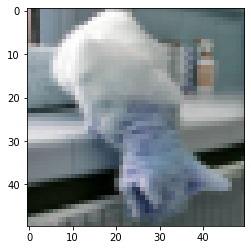

correct class is 0 but predict is 1


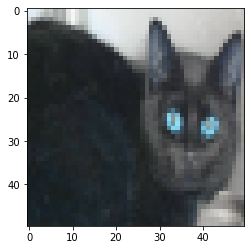

correct class is 0 but predict is 1


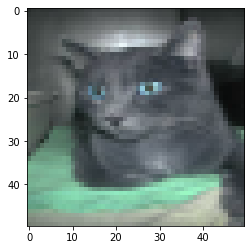

correct class is 0 but predict is 1


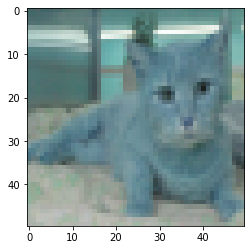

correct class is 0 but predict is 1


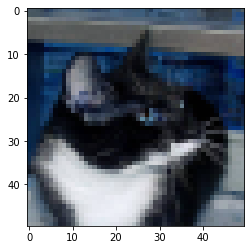

correct class is 0 but predict is 1


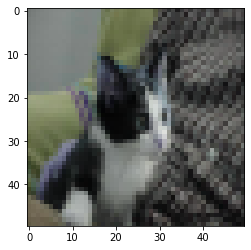

correct class is 0 but predict is 1


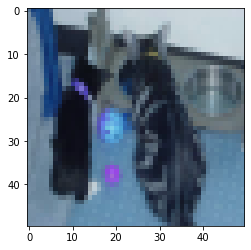

correct class is 0 but predict is 1


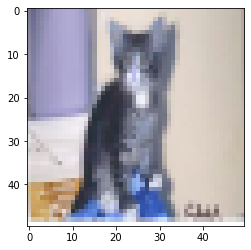

correct class is 0 but predict is 1


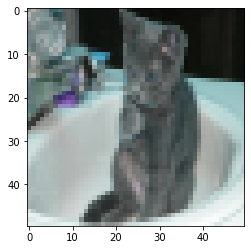

correct class is 0 but predict is 1


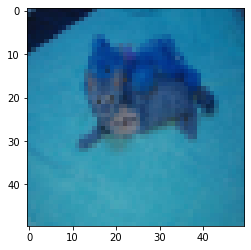

correct class is 0 but predict is 1


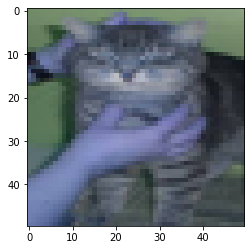

correct class is 0 but predict is 1


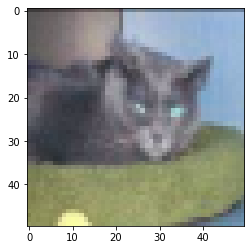

correct class is 0 but predict is 1


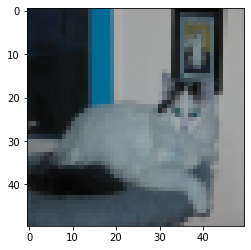

correct class is 0 but predict is 1


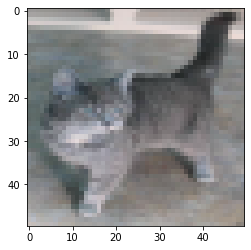

correct class is 0 but predict is 1


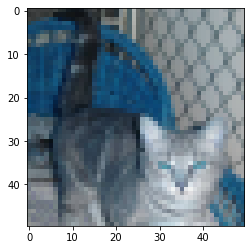

correct class is 0 but predict is 1


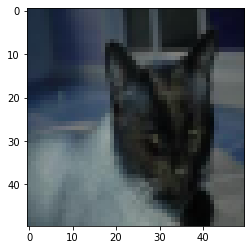

correct class is 0 but predict is 1


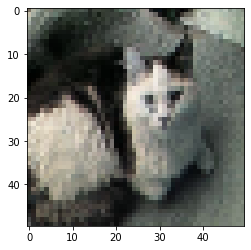

correct class is 0 but predict is 1


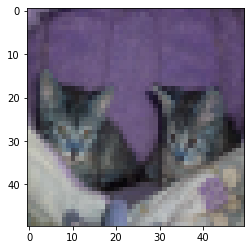

correct class is 0 but predict is 1


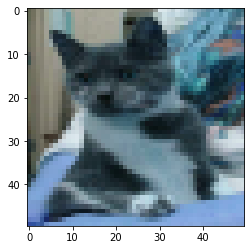

correct class is 0 but predict is 1


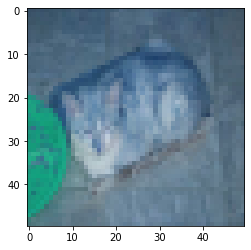

correct class is 0 but predict is 1


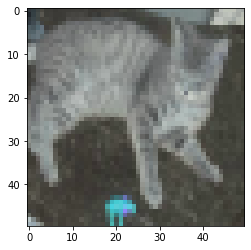

correct class is 0 but predict is 1


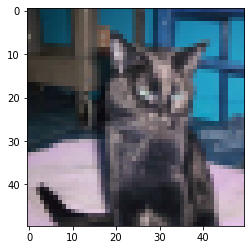

correct class is 0 but predict is 1


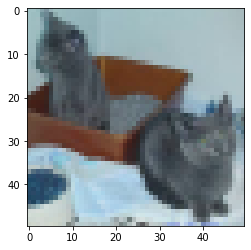

correct class is 0 but predict is 1


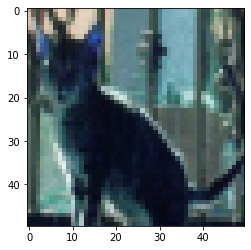

correct class is 0 but predict is 1


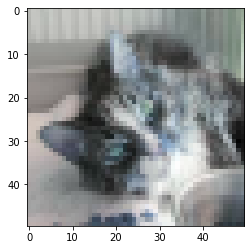

correct class is 0 but predict is 1


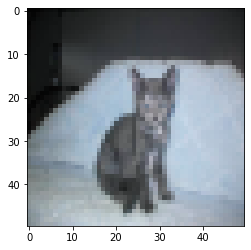

correct class is 0 but predict is 1


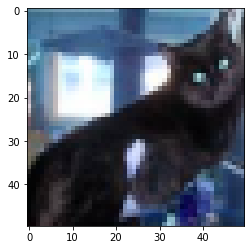

correct class is 0 but predict is 1


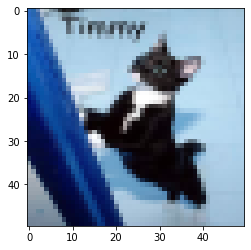

correct class is 0 but predict is 1


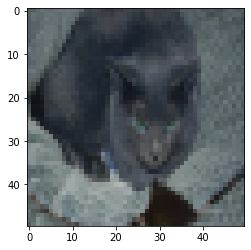

correct class is 0 but predict is 1


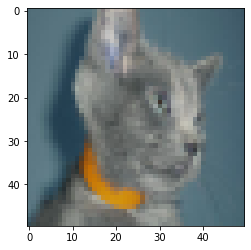

correct class is 0 but predict is 1


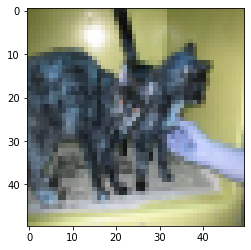

correct class is 0 but predict is 1


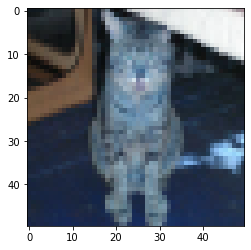

correct class is 0 but predict is 1


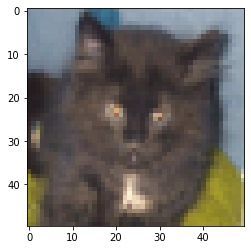

correct class is 0 but predict is 1


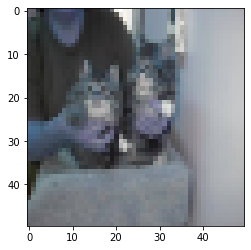

correct class is 0 but predict is 1


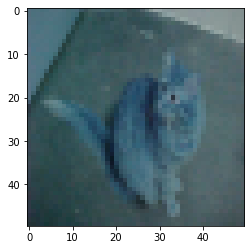

correct class is 0 but predict is 1


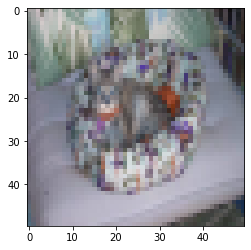

correct class is 0 but predict is 1


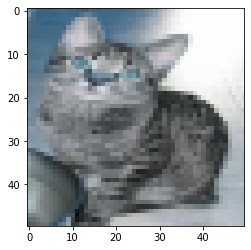

correct class is 0 but predict is 1


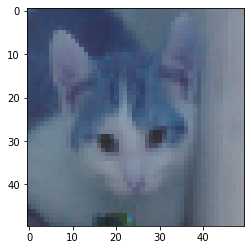

correct class is 0 but predict is 1


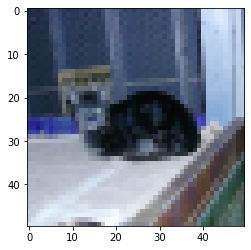

correct class is 0 but predict is 1


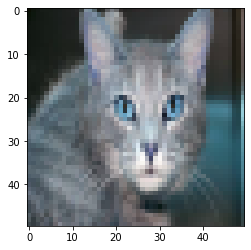

correct class is 0 but predict is 1


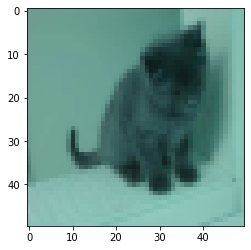

correct class is 0 but predict is 1


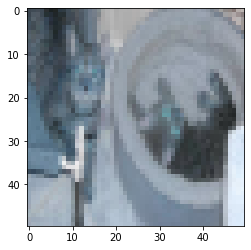

correct class is 0 but predict is 1


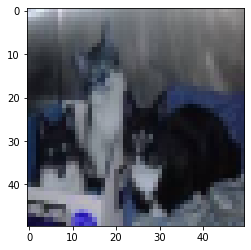

correct class is 0 but predict is 1


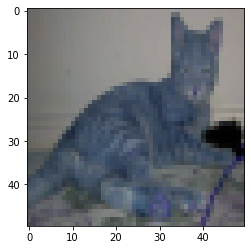

correct class is 0 but predict is 1


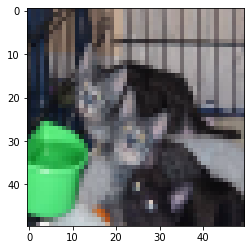

correct class is 0 but predict is 1


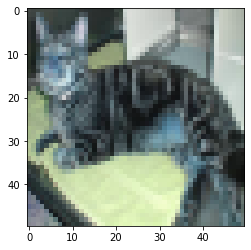

correct class is 0 but predict is 1


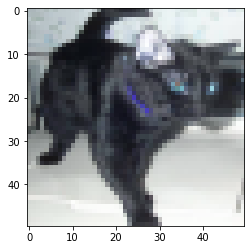

correct class is 0 but predict is 1


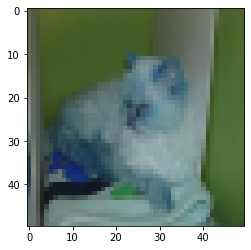

correct class is 0 but predict is 1


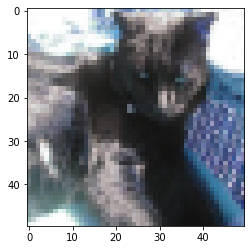

correct class is 0 but predict is 1


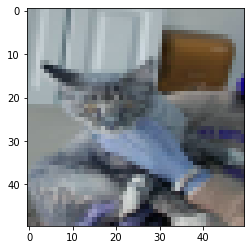

correct class is 0 but predict is 1


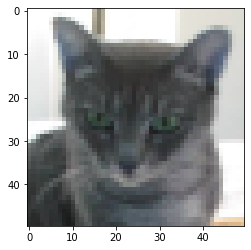

correct class is 0 but predict is 1


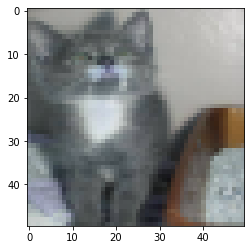

correct class is 0 but predict is 1


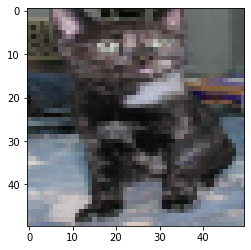

correct class is 0 but predict is 1


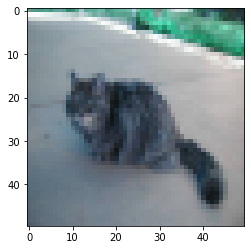

correct class is 0 but predict is 1


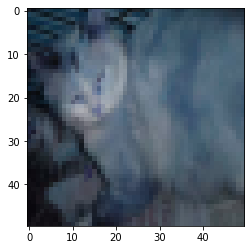

correct class is 0 but predict is 1


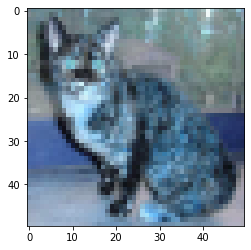

correct class is 0 but predict is 1


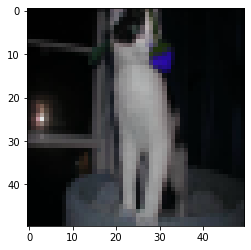

correct class is 0 but predict is 1


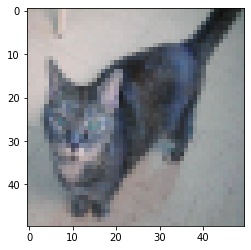

correct class is 0 but predict is 1


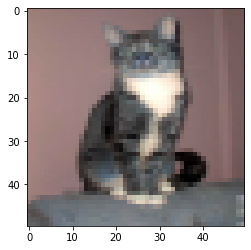

correct class is 0 but predict is 1


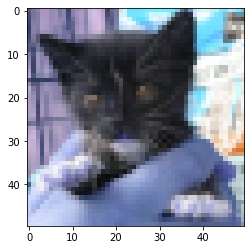

correct class is 0 but predict is 1


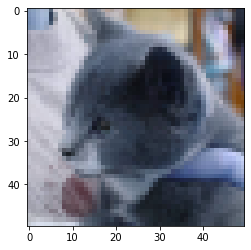

correct class is 0 but predict is 1


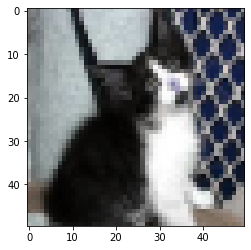

correct class is 0 but predict is 1


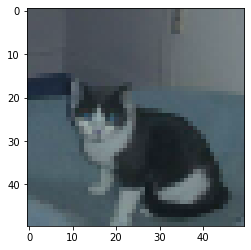

correct class is 0 but predict is 1


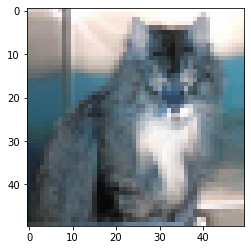

correct class is 0 but predict is 1


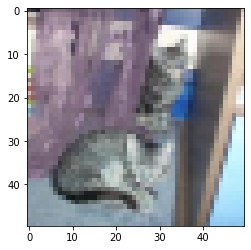

correct class is 0 but predict is 1


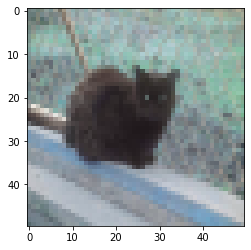

correct class is 0 but predict is 1


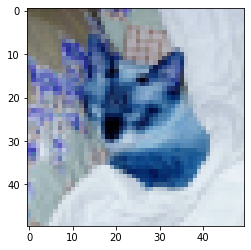

correct class is 0 but predict is 1


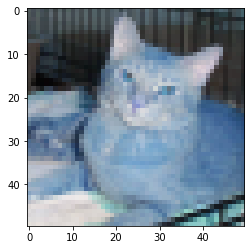

correct class is 0 but predict is 1


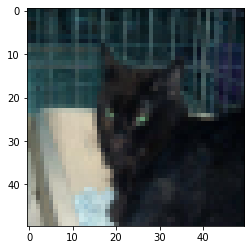

correct class is 0 but predict is 1


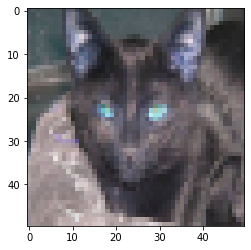

correct class is 0 but predict is 1


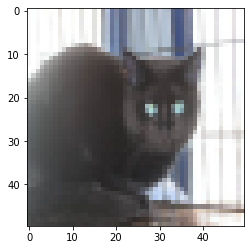

correct class is 0 but predict is 1


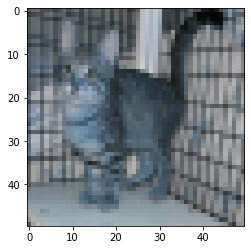

correct class is 0 but predict is 1


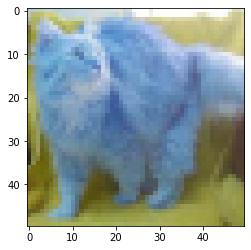

correct class is 0 but predict is 1


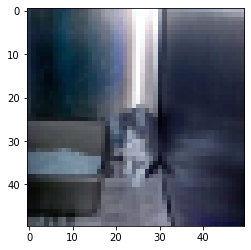

correct class is 0 but predict is 1


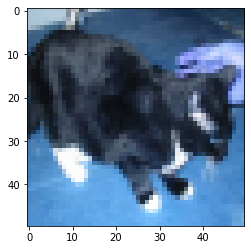

correct class is 0 but predict is 1


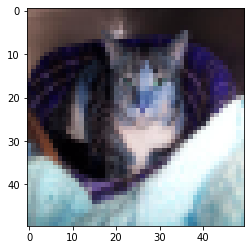

correct class is 0 but predict is 1


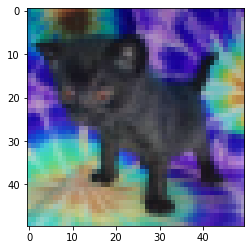

correct class is 0 but predict is 1


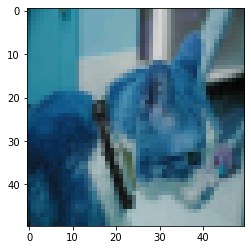

correct class is 0 but predict is 1


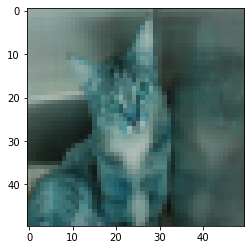

correct class is 0 but predict is 1


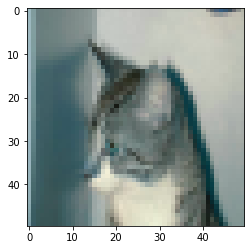

correct class is 0 but predict is 1


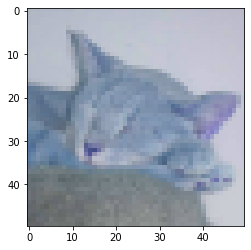

correct class is 0 but predict is 1


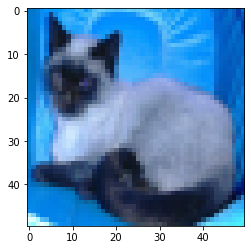

correct class is 0 but predict is 1


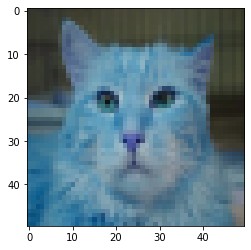

correct class is 0 but predict is 1


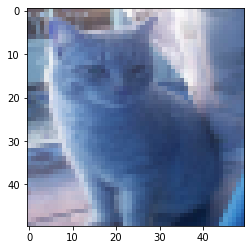

correct class is 0 but predict is 1


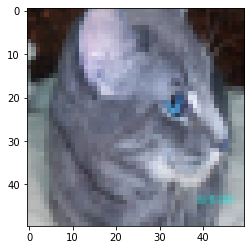

correct class is 0 but predict is 1


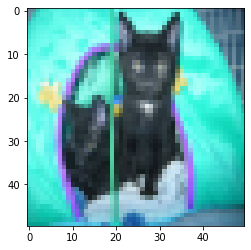

correct class is 0 but predict is 1


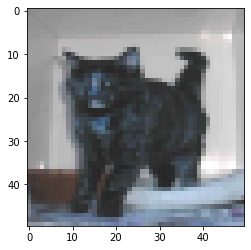

correct class is 0 but predict is 1


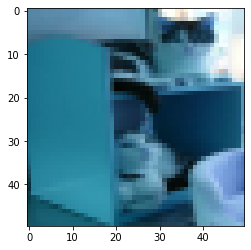

correct class is 0 but predict is 1


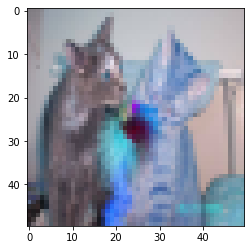

correct class is 0 but predict is 1


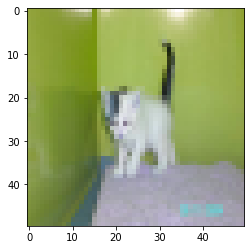

correct class is 0 but predict is 1


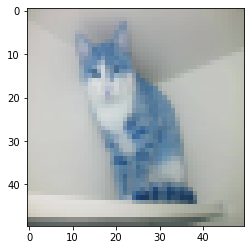

correct class is 0 but predict is 1


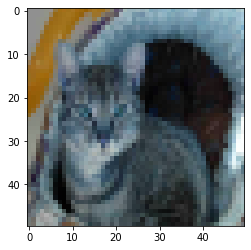

correct class is 0 but predict is 1


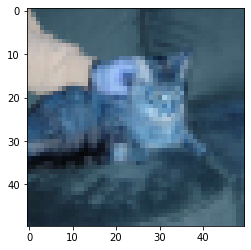

correct class is 0 but predict is 1


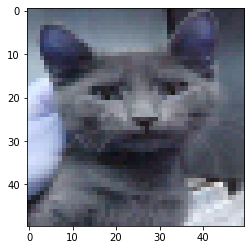

correct class is 0 but predict is 1


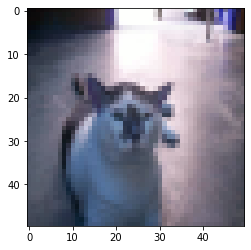

correct class is 0 but predict is 1


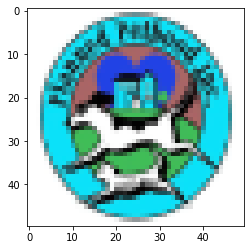

correct class is 0 but predict is 1


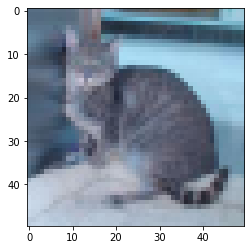

correct class is 0 but predict is 1


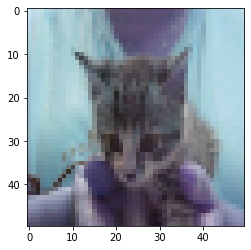

correct class is 0 but predict is 1


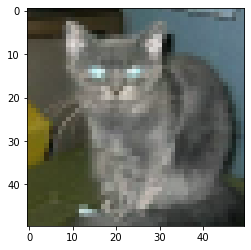

correct class is 0 but predict is 1


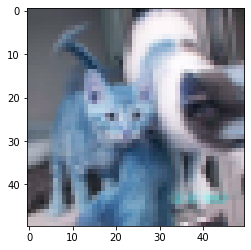

correct class is 0 but predict is 1


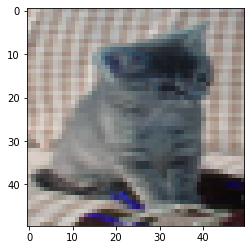

correct class is 0 but predict is 1


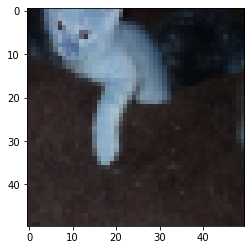

correct class is 0 but predict is 1


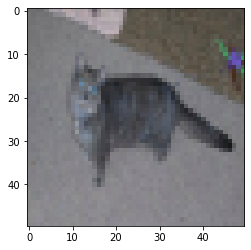

correct class is 0 but predict is 1


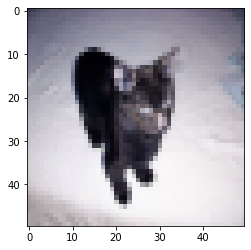

correct class is 0 but predict is 1


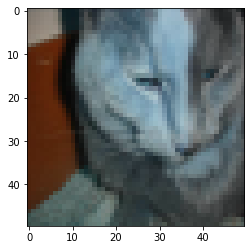

correct class is 0 but predict is 1


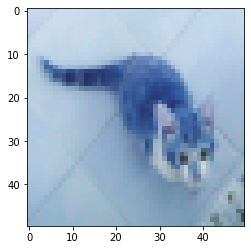

correct class is 0 but predict is 1


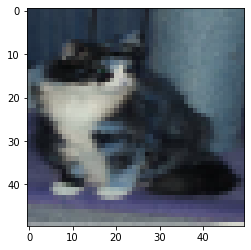

correct class is 0 but predict is 1


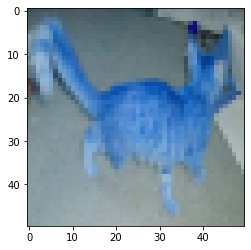

correct class is 0 but predict is 1


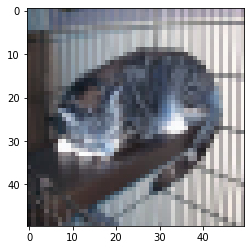

correct class is 0 but predict is 1


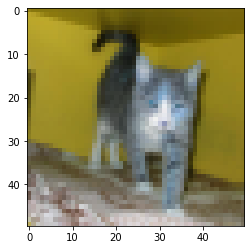

correct class is 0 but predict is 1


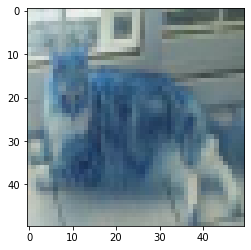

correct class is 0 but predict is 1


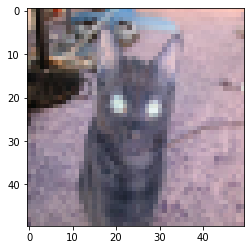

correct class is 0 but predict is 1


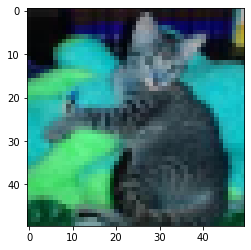

correct class is 0 but predict is 1


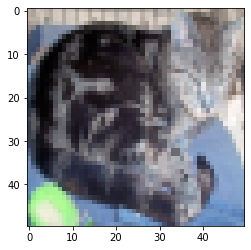

correct class is 0 but predict is 1


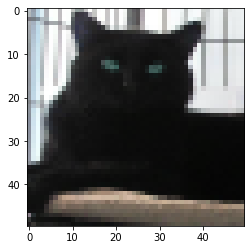

correct class is 0 but predict is 1


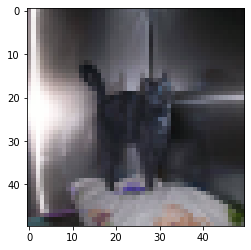

correct class is 0 but predict is 1


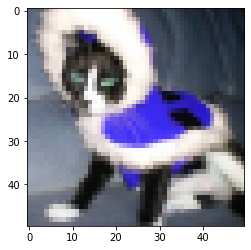

correct class is 0 but predict is 1


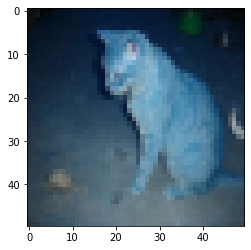

correct class is 0 but predict is 1


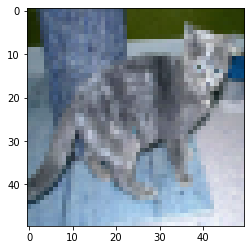

correct class is 0 but predict is 1


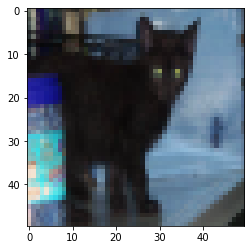

correct class is 0 but predict is 1


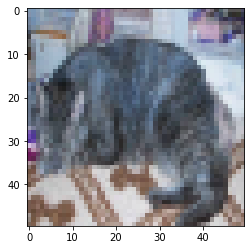

correct class is 0 but predict is 1


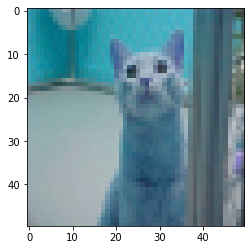

correct class is 0 but predict is 1


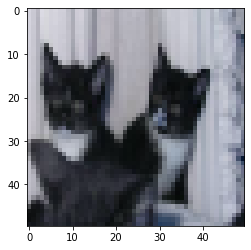

correct class is 0 but predict is 1


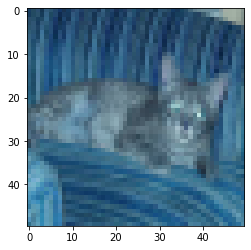

correct class is 0 but predict is 1


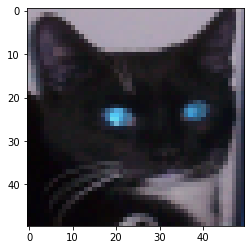

correct class is 0 but predict is 1


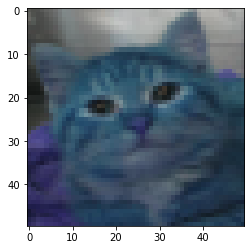

correct class is 0 but predict is 1


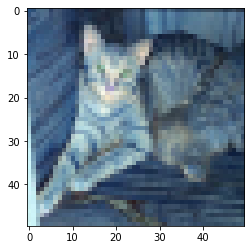

correct class is 0 but predict is 1


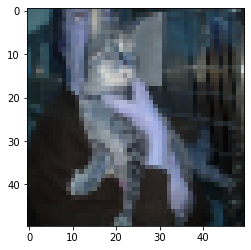

correct class is 0 but predict is 1


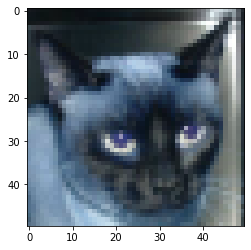

correct class is 0 but predict is 1


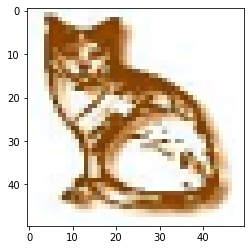

correct class is 0 but predict is 1


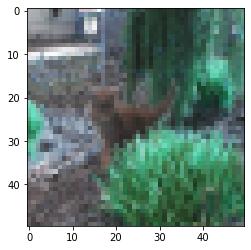

correct class is 0 but predict is 1


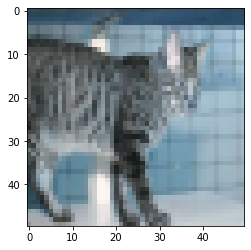

correct class is 0 but predict is 1


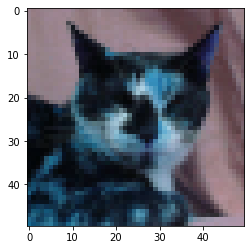

correct class is 0 but predict is 1


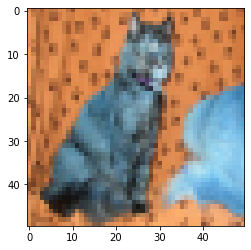

correct class is 0 but predict is 1


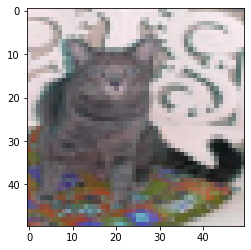

correct class is 0 but predict is 1


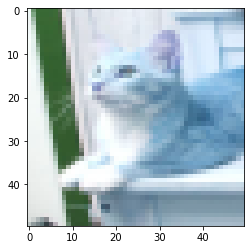

correct class is 0 but predict is 1


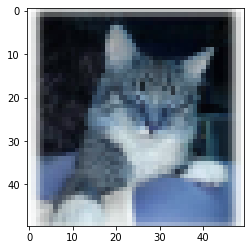

correct class is 0 but predict is 1


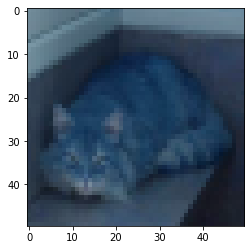

correct class is 0 but predict is 1


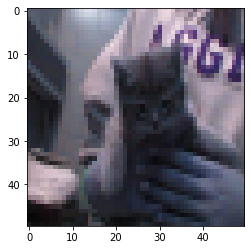

correct class is 0 but predict is 1


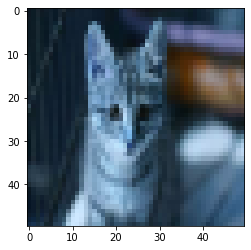

correct class is 0 but predict is 1


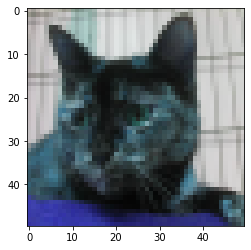

correct class is 0 but predict is 1


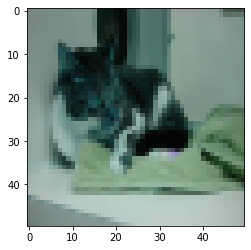

correct class is 0 but predict is 1


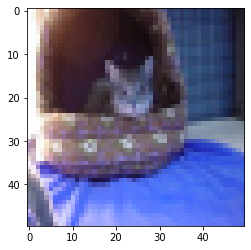

correct class is 0 but predict is 1


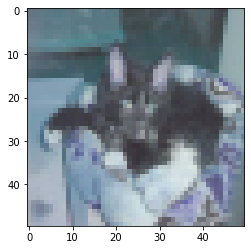

correct class is 0 but predict is 1


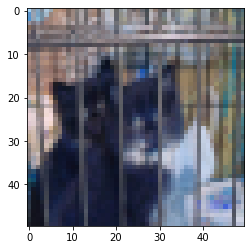

correct class is 0 but predict is 1


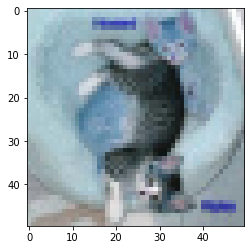

correct class is 0 but predict is 1


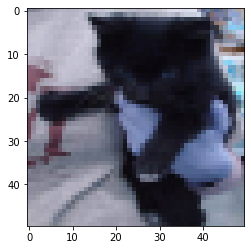

correct class is 0 but predict is 1


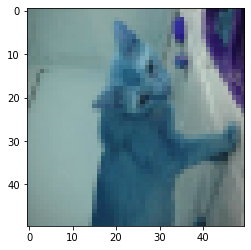

correct class is 0 but predict is 1


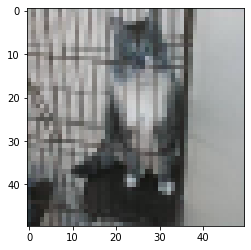

correct class is 0 but predict is 1


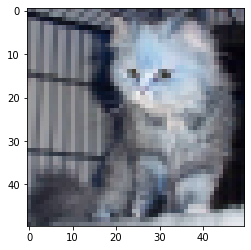

correct class is 0 but predict is 1


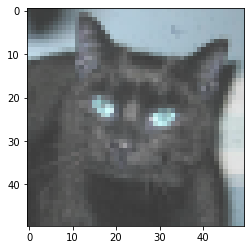

correct class is 0 but predict is 1


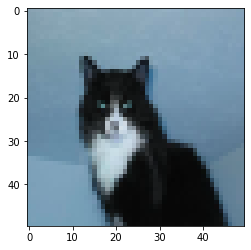

correct class is 0 but predict is 1


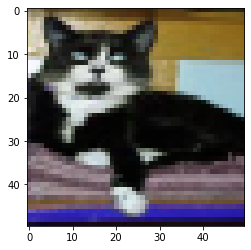

correct class is 0 but predict is 1


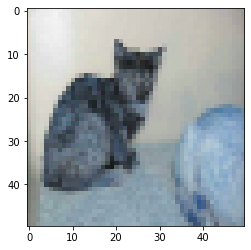

correct class is 0 but predict is 1


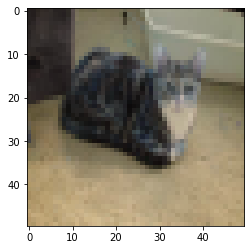

correct class is 0 but predict is 1


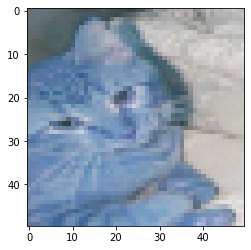

correct class is 0 but predict is 1


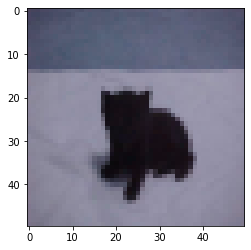

correct class is 0 but predict is 1


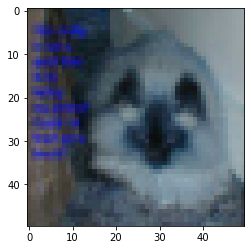

correct class is 0 but predict is 1


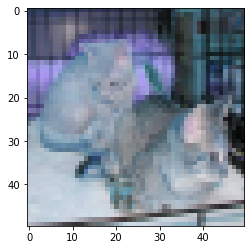

correct class is 0 but predict is 1


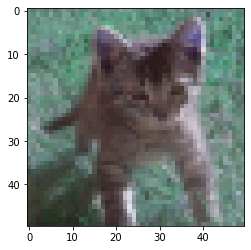

correct class is 0 but predict is 1


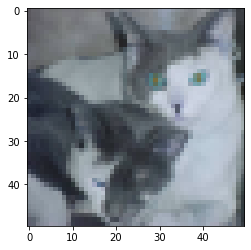

correct class is 0 but predict is 1


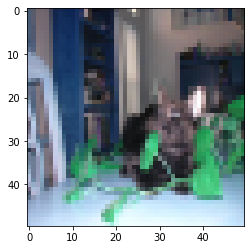

correct class is 0 but predict is 1


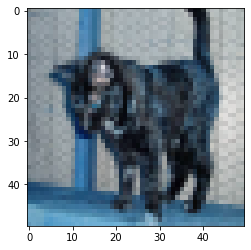

correct class is 0 but predict is 1


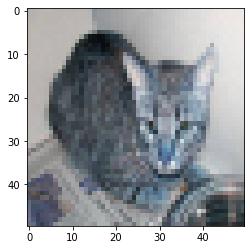

correct class is 0 but predict is 1


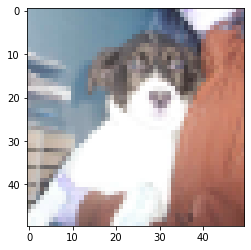

correct class is 1 but predict is 0


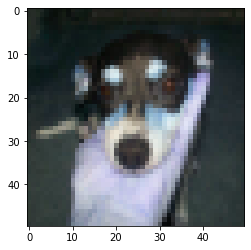

correct class is 1 but predict is 0


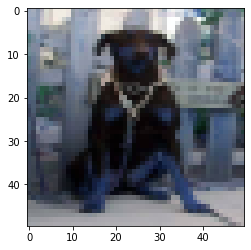

correct class is 1 but predict is 0


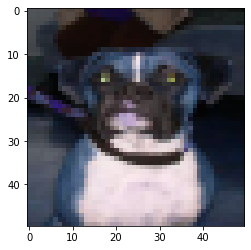

correct class is 1 but predict is 0


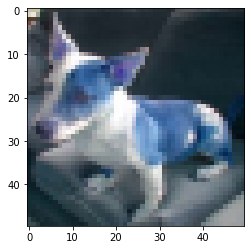

correct class is 1 but predict is 0


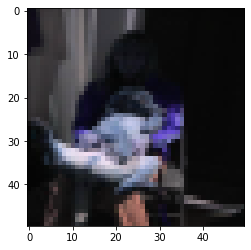

correct class is 1 but predict is 0


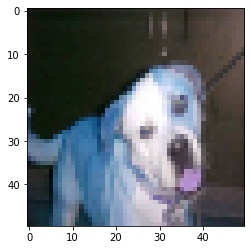

correct class is 1 but predict is 0


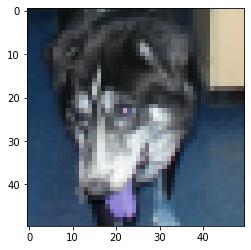

correct class is 1 but predict is 0


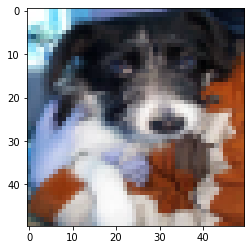

correct class is 1 but predict is 0


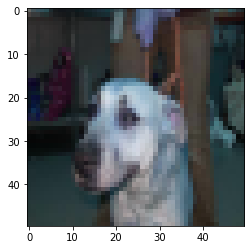

correct class is 1 but predict is 0


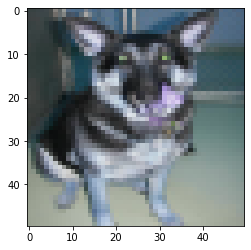

correct class is 1 but predict is 0


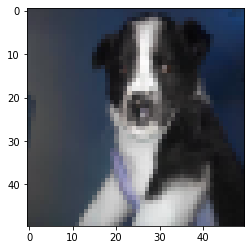

correct class is 1 but predict is 0


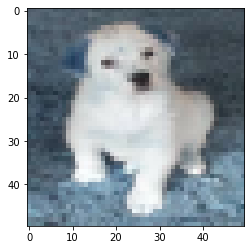

correct class is 1 but predict is 0


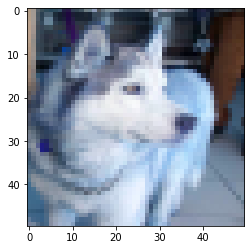

correct class is 1 but predict is 0


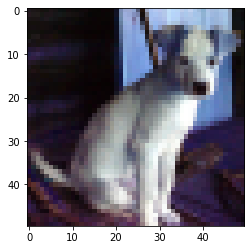

correct class is 1 but predict is 0


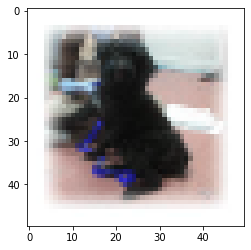

correct class is 1 but predict is 0


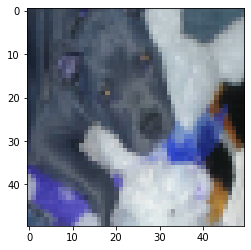

correct class is 1 but predict is 0


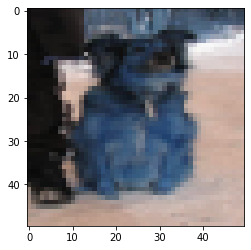

correct class is 1 but predict is 0


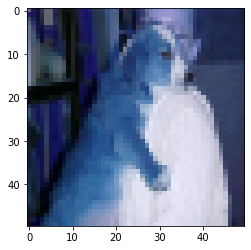

correct class is 1 but predict is 0


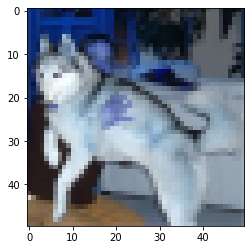

correct class is 1 but predict is 0


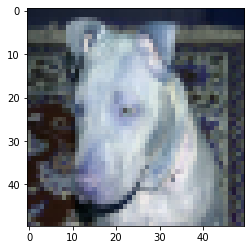

correct class is 1 but predict is 0


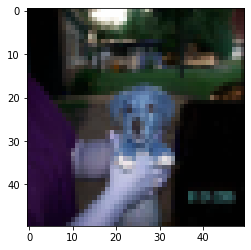

correct class is 1 but predict is 0


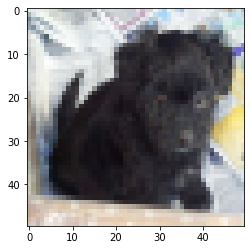

correct class is 1 but predict is 0


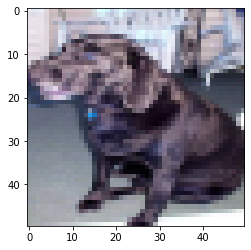

correct class is 1 but predict is 0


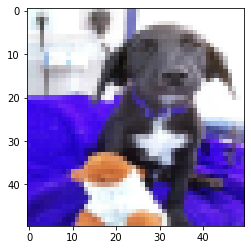

correct class is 1 but predict is 0


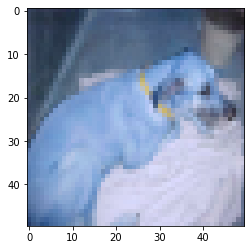

correct class is 1 but predict is 0


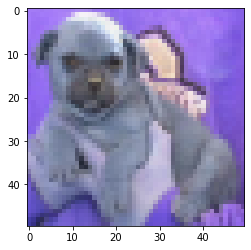

correct class is 1 but predict is 0


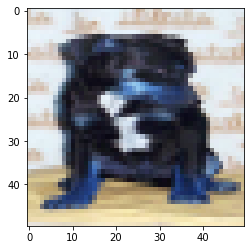

correct class is 1 but predict is 0


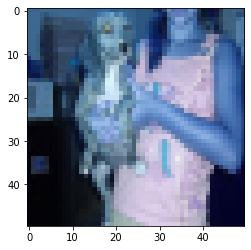

correct class is 1 but predict is 0


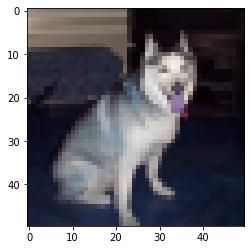

correct class is 1 but predict is 0


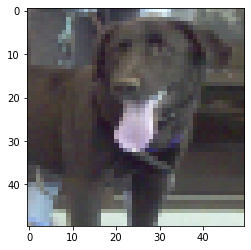

correct class is 1 but predict is 0


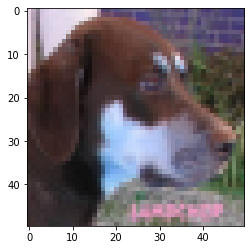

correct class is 1 but predict is 0


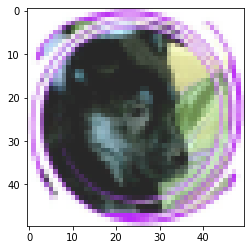

correct class is 1 but predict is 0


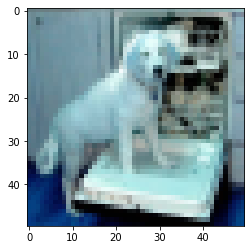

correct class is 1 but predict is 0


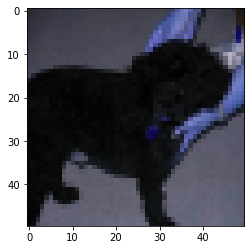

correct class is 1 but predict is 0


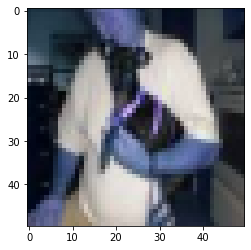

correct class is 1 but predict is 0


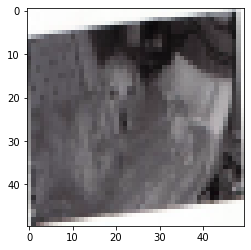

correct class is 1 but predict is 0


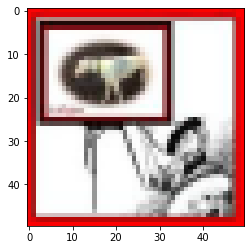

correct class is 1 but predict is 0


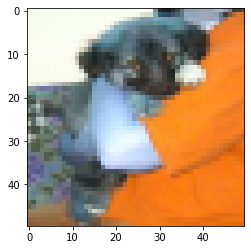

correct class is 1 but predict is 0


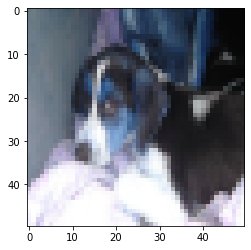

correct class is 1 but predict is 0


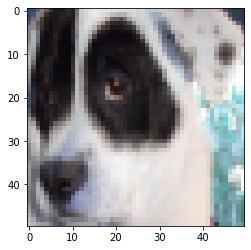

correct class is 1 but predict is 0


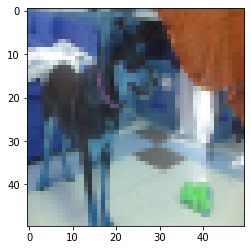

correct class is 1 but predict is 0


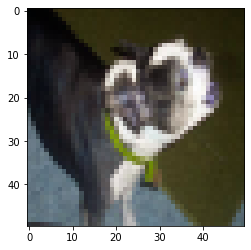

correct class is 1 but predict is 0


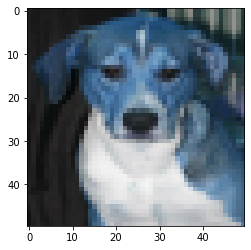

correct class is 1 but predict is 0


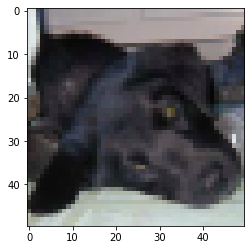

correct class is 1 but predict is 0


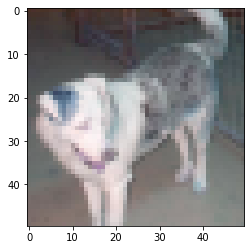

correct class is 1 but predict is 0


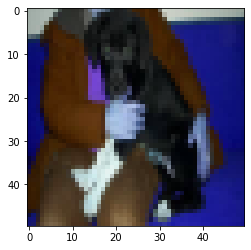

correct class is 1 but predict is 0


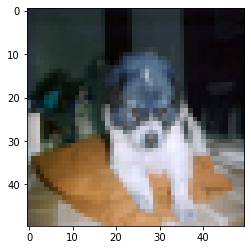

correct class is 1 but predict is 0


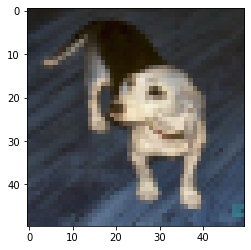

correct class is 1 but predict is 0


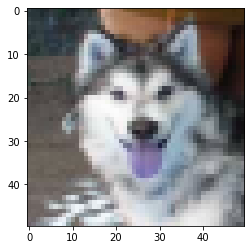

correct class is 1 but predict is 0


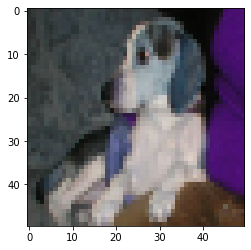

correct class is 1 but predict is 0


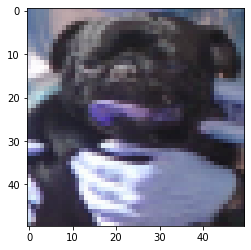

correct class is 1 but predict is 0


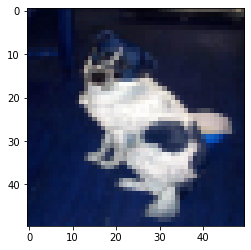

correct class is 1 but predict is 0


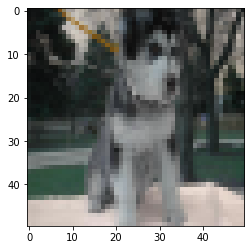

correct class is 1 but predict is 0


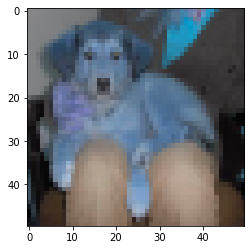

correct class is 1 but predict is 0


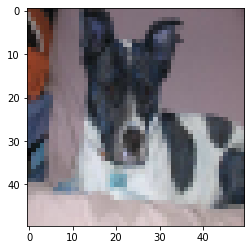

correct class is 1 but predict is 0


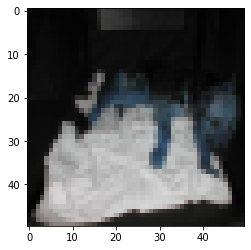

correct class is 1 but predict is 0


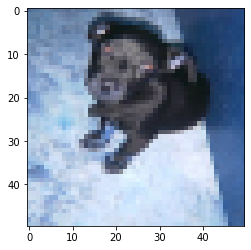

correct class is 1 but predict is 0


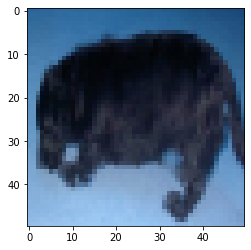

correct class is 1 but predict is 0


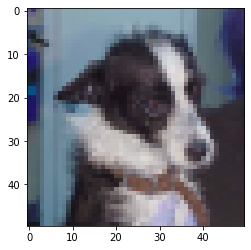

correct class is 1 but predict is 0


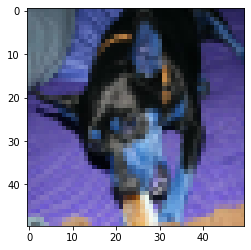

correct class is 1 but predict is 0


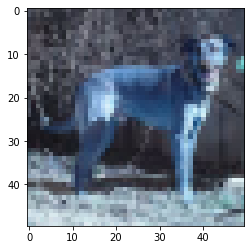

correct class is 1 but predict is 0


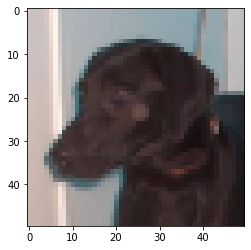

correct class is 1 but predict is 0


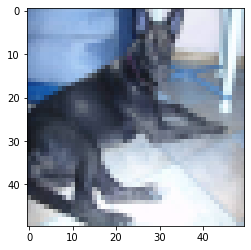

correct class is 1 but predict is 0


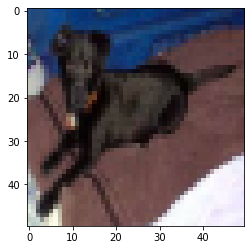

correct class is 1 but predict is 0


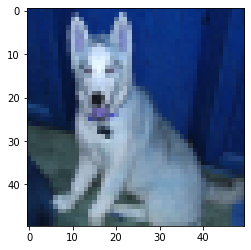

correct class is 1 but predict is 0


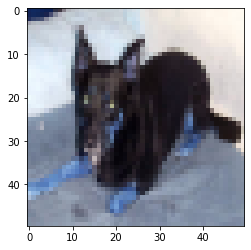

correct class is 1 but predict is 0


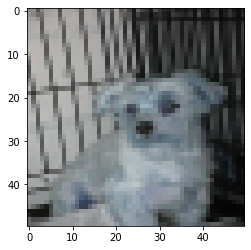

correct class is 1 but predict is 0


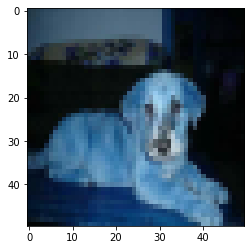

correct class is 1 but predict is 0


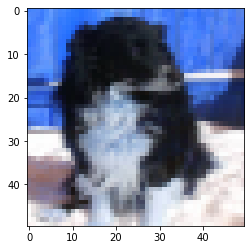

correct class is 1 but predict is 0


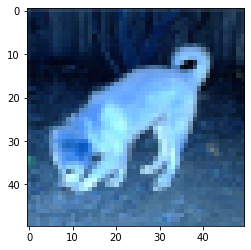

correct class is 1 but predict is 0


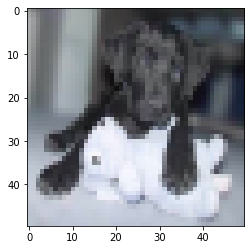

correct class is 1 but predict is 0


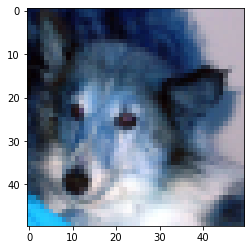

correct class is 1 but predict is 0


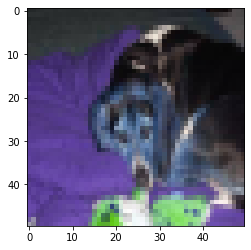

correct class is 1 but predict is 0


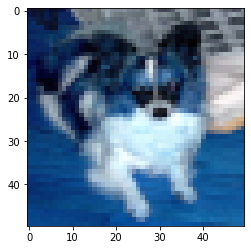

correct class is 1 but predict is 0


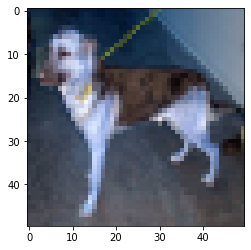

correct class is 1 but predict is 0


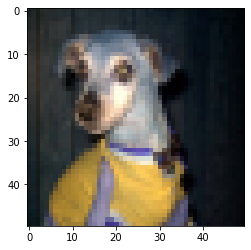

correct class is 1 but predict is 0


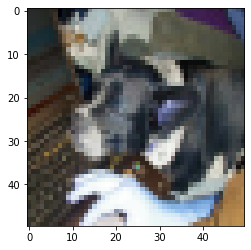

correct class is 1 but predict is 0


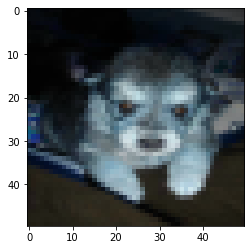

correct class is 1 but predict is 0


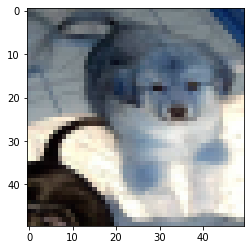

correct class is 1 but predict is 0


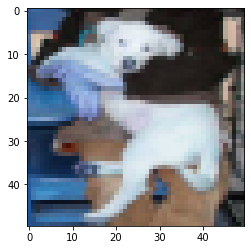

correct class is 1 but predict is 0


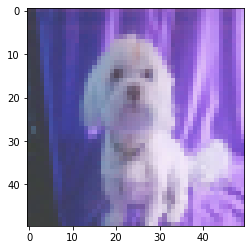

correct class is 1 but predict is 0


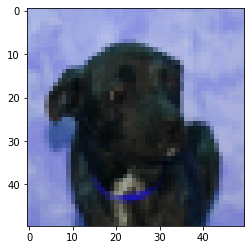

correct class is 1 but predict is 0


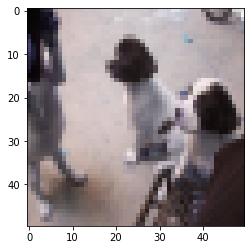

correct class is 1 but predict is 0


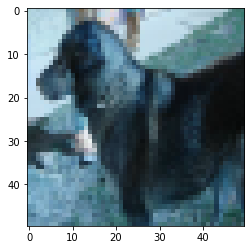

correct class is 1 but predict is 0


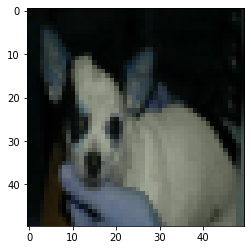

correct class is 1 but predict is 0


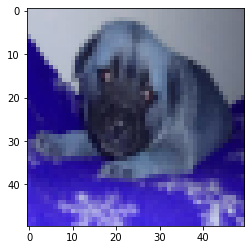

correct class is 1 but predict is 0


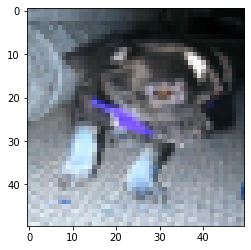

correct class is 1 but predict is 0


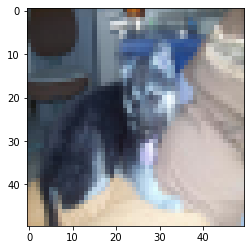

correct class is 1 but predict is 0
number of images with this property : 330


In [156]:
count=0
for i in range(len(Y)):
    if(logs[i][Y[i]]<0.5):
        count+=1
        plt.figure(i)
        plt.imshow(X_test[i], interpolation='none', cmap='gray')
        plt.show()
        print(f"correct class is {Y[i]} but predict is {(max_idxs[i])}")
print(f"number of images with this property : {count}")

در کل به نظر میرسد با این مدل ها نمیتوان به دقت بهتری رسید و بهتر است از شبکه های عصبی کانولوشنی استفاده کنیم


### قسمت ه

### حل مساله با شبکه های کانوولوشنی


ابتدا لازم است فرم داده ها به فرم قابل قبولی برای توابعی که میخواهیم مورد استفاده قرار دهیم تبدیل شود. به این منظور لیبیل ها را به فرم یک عدد که نماینده ی کلاس عکس است تبدیل میکنیم

In [163]:
IMG_WIDTH=50
IMG_HEIGHT=50
training_img_folder=r'Desktop\data\training_set'
test_img_folder=r'Desktop\data\test_set'

X_train, Y_train =create_dataset(r'C:\Users\Marzieh\Desktop\data\training_set')
X_test, Y_test =create_dataset(r'C:\Users\Marzieh\Desktop\data\test_set')

target_dict_train={k: v for v, k in enumerate(np.unique(class_name_train))}
target_dict_test={k: v for v, k in enumerate(np.unique(class_name_test))}
print(target_dict_train);
print(target_dict_test);

Y_train=  [target_dict_train[class_name_train[i]] for i in range(len(class_name_train))]
Y_test=  [target_dict_test[class_name_test[i]] for i in range(len(class_name_test))]

X_train = np.array(X_train)
Y_train = np.array(Y_train)
X_test = np.array(X_test)
Y_test = np.array(Y_test)

print(X_train.shape)
print(Y_train.shape)

print(X_test.shape)
print(Y_test.shape)

{'cats': 0, 'dogs': 1}
{'cats': 0, 'dogs': 1}
(8000, 50, 50, 3)
(8000,)
(2000, 50, 50, 3)
(2000,)


حال مدل خود را طراحی میکنیم، این مورد از میان آموزش ها و مقالات سایت تنسورفلو انتخاب شده . مدل را ساخته و لایه هایش را به آن اضافه میکنیم. در آخر یک سامری از مدل که تعداد فیلتر های استفاده شده و پارامترهای مدل در مرحله است را مشاهده میکنید

In [172]:
model = models.Sequential()
model.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(50, 50, 3)))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
model.add(layers.Flatten())
model.add(layers.Dense(64, activation='relu'))
model.add(layers.Dense(7))

model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_3 (Conv2D)            (None, 48, 48, 32)        896       
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 24, 24, 32)        0         
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 22, 22, 64)        18496     
_________________________________________________________________
max_pooling2d_3 (MaxPooling2 (None, 11, 11, 64)        0         
_________________________________________________________________
conv2d_5 (Conv2D)            (None, 9, 9, 64)          36928     
_________________________________________________________________
flatten_1 (Flatten)          (None, 5184)              0         
_________________________________________________________________
dense_2 (Dense)              (None, 64)               

در این قسمت مدل را کامپایل کرده و آموزش آن را طی 15 ایپاک روی داده های آموزش شروع میکنیم . هم چنین در طی آموزش خطا و دیگر معیارها را نیز طی هر مرحله حساب میکنیم تا دیدی از چگونگی عملکر آموزش داشته باشیم

In [173]:
model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

history = model.fit(X_train, Y_train, epochs=15, 
                    validation_data=(X_test, Y_test))

Epoch 1/15
250/250 [==============================] - 23s 87ms/step - loss: 0.7039 - accuracy: 0.5614 - val_loss: 0.6810 - val_accuracy: 0.5900
Epoch 2/15
250/250 [==============================] - 22s 88ms/step - loss: 0.6044 - accuracy: 0.6760 - val_loss: 0.5591 - val_accuracy: 0.7085
Epoch 3/15
250/250 [==============================] - 22s 86ms/step - loss: 0.5540 - accuracy: 0.7219 - val_loss: 0.5646 - val_accuracy: 0.7110
Epoch 4/15
250/250 [==============================] - 23s 90ms/step - loss: 0.4999 - accuracy: 0.7534 - val_loss: 0.5037 - val_accuracy: 0.7635
Epoch 5/15
250/250 [==============================] - 22s 89ms/step - loss: 0.4614 - accuracy: 0.7845 - val_loss: 0.4752 - val_accuracy: 0.7805
Epoch 6/15
250/250 [==============================] - 23s 91ms/step - loss: 0.4276 - accuracy: 0.7977 - val_loss: 0.5083 - val_accuracy: 0.7550
Epoch 7/15
250/250 [==============================] - 23s 92ms/step - loss: 0.3920 - accuracy: 0.8223 - val_loss: 0.4400 - val_accuracy:

آموزش مدل کامل شده و در بالا خطاهای مورد نظر و روند آموزش را مشاهده میکنید در پایین نیز نموداری رسم شده که نشان دهنده ی معیار

accuracy

روی داده های آموزش و داده های ولیدیشن(که برای آن از داده های تست استفاه شده است) است. میتوان دید در هر ایپاک این معیار به مقدار خوبی افزایش داشته و در نهایت روی داده های آموزش تقریبا به 100 درصد و روی داده های ولیدیشن به 80 درصد رسیده است. به طور کلی و در مقایسه با قسمت های قبلی میبینیم شبکه های کانوولوشنی برای پردازش تصویر مناسب تر از شبکه های عصبی ساده هستند

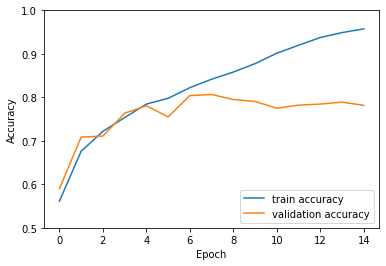

In [176]:
plt.plot(history.history['accuracy'], label='train accuracy')
plt.plot(history.history['val_accuracy'], label = 'validation accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.ylim([0.5, 1])
plt.legend(loc='lower right')

در آخر نیز مدل آموزش داده شده را روی داده های تست امتحان میکنیم و میبینیم که 

accuracy_test=78%

که درصد بسیار خوب و قابل قبولی است و عملکرد شبکه بسیار خوب بوه است

In [178]:
predict=[]
diff=[]
count=0
predict=model.predict(X_test)
predict=np.argmax(predict, axis=1)

for i in range(len(Y_test)):
    diff.append(predict[i]-Y_test[i])

for i in range(len(Y_test)):
    if(diff[i]==0):
        count+=1

print("the accuracy that our trained model has on test data is:")
print(count/len(diff))

the accuracy that our trained model has on test data is:
0.7815
